In [3]:
import os

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import scipy.stats as stats

In [85]:
df = pd.read_pickle('/Users/olivier/Documents/MSc/thesis/Analysis_Oli/prepped_table_for_analysis_v3.pkl')

## Data Preparation

In [87]:
df = df.drop(columns=['atlas'])

In [88]:
# check types of columns
df.dtypes

data                  object
dataset               object
subject               object
task                  object
session               object
run                   object
conreg                object
unique_ts             object
proportion_ts_fd     float64
FD_mean              float64
entropy_LZc          float64
entropy_pl            object
dcc_entropy           object
dcc_var               object
entropy_metastate    float64
dtype: object

In [89]:
print(df['subject'].apply(type).head(10))

0    <class 'str'>
1    <class 'str'>
2    <class 'str'>
3    <class 'str'>
4    <class 'str'>
5    <class 'str'>
6    <class 'str'>
7    <class 'str'>
8    <class 'str'>
9    <class 'str'>
Name: subject, dtype: object


In [90]:
# convert arrays now stored as listst to actual arrays
df['dcc_var'] = df['dcc_var'].apply(np.array)
df['dcc_entropy'] = df['dcc_entropy'].apply(np.array)
df['data'] = df['data'].apply(np.array)

In [91]:
df.dtypes

data                  object
dataset               object
subject               object
task                  object
session               object
run                   object
conreg                object
unique_ts             object
proportion_ts_fd     float64
FD_mean              float64
entropy_LZc          float64
entropy_pl            object
dcc_entropy           object
dcc_var               object
entropy_metastate    float64
dtype: object

In [92]:
print(df['dcc_entropy'].apply(type).head(10))

0    <class 'numpy.ndarray'>
1    <class 'numpy.ndarray'>
2    <class 'numpy.ndarray'>
3    <class 'numpy.ndarray'>
4    <class 'numpy.ndarray'>
5    <class 'numpy.ndarray'>
6    <class 'numpy.ndarray'>
7    <class 'numpy.ndarray'>
8    <class 'numpy.ndarray'>
9    <class 'numpy.ndarray'>
Name: dcc_entropy, dtype: object


In [93]:
print(df['entropy_metastate'].apply(type).head(10))

0    <class 'float'>
1    <class 'float'>
2    <class 'float'>
3    <class 'float'>
4    <class 'float'>
5    <class 'float'>
6    <class 'float'>
7    <class 'float'>
8    <class 'float'>
9    <class 'float'>
Name: entropy_metastate, dtype: object


In [11]:
df

,data,dataset,subject,task,session,run,conreg,unique_ts,proportion_ts_fd,FD_mean,entropy_LZc,entropy_pl,dcc_entropy,dcc_var,entropy_metastate
0,"[[-1.516011092621959, -1.076361394274307, -0.7...",basel_PLM,1,LSD,1,1,compcor,basel_PLM_01_compcor_1_LSD_1,0.016667,0.121138,0.949510,"[None, 1.057711230736792, 1.507386128657495, 1...","[[0.0, 1.956754419972776, 2.248857730750826, 2...","[[0.0, 0.008103586927685001, 0.014721614538935...",NaN
1,"[[-2.191225707462541, 1.190660786793587, 1.705...",basel_PLM,1,LSD,1,2,compcor,basel_PLM_01_compcor_1_LSD_2,0.130000,0.127499,0.941960,"[None, 1.459036872104267, 1.81655841462946, 1....","[[0.0, 2.137590908300417, 2.267152986275524, 1...","[[0.0, 0.010532920263946002, 0.017066938446224...",NaN
2,"[[-1.287607035766197, -0.969182091948087, -1.1...",basel_PLM,1,mescaline,2,1,compcor,basel_PLM_01_compcor_2_mescaline_1,0.126667,0.083345,0.936110,"[None, 0.9530705538781981, 1.927331590809854, ...","[[0.0, 1.934269662786402, 1.822971082930666, 2...","[[0.0, 0.0033543894130710003, 0.00025005046605...",NaN
3,"[[0.263177627089383, 1.759500782314957, 1.3622...",basel_PLM,1,placebo,3,1,compcor,basel_PLM_01_compcor_3_placebo_1,0.040000,0.096023,0.920450,"[None, 0.824858768619501, 1.354099569252335, 1...","[[0.0, 2.377396458449645, 2.324352341662161, 2...","[[0.0, 0.019993259201098002, 0.017698027545248...",NaN
4,"[[-0.8769848181920741, -0.06197278812829401, -...",basel_PLM,1,psilocybin,4,1,compcor,basel_PLM_01_compcor_4_psilocybin_1,0.170000,0.113363,0.950460,"[None, 1.43323633927814, 2.298713854218667, 1....","[[0.0, 1.630929392684715, 1.7206773737599321, ...","[[0.0, 0.0009227448382250001, 8.72409011373686...",NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1865,"[[0.9413910791833071, -0.045883188277713004, -...",berlin_fls-ganz,24,10Hz,None,2,gsr,berlin_fls-ganz_24_gsr_None_10Hz_2,0.015556,0.106056,0.902320,"[None, 1.028183802568681, 1.002966766900257, 1...","[[0.0, 2.549443032553508, 1.921389967441647, 2...","[[0.0, 0.026322451709119003, 0.028343444919765...",NaN
1866,"[[1.6084570641351001, -0.8665419142987351, -2....",berlin_fls-ganz,24,3Hz,None,3,gsr,berlin_fls-ganz_24_gsr_None_3Hz_3,0.002222,0.070604,0.917380,"[None, 0.865188962500895, 1.7723703329068932, ...","[[0.0, 2.363201381133951, 2.135797515671246, 2...","[[0.0, 0.007480264930718, 2.770218254005094e-0...",NaN
1867,"[[-1.389577746960598, 1.13763118556952, -0.747...",berlin_fls-ganz,24,Ganz,None,4,gsr,berlin_fls-ganz_24_gsr_None_Ganz_4,0.004444,0.090611,0.902750,"[None, 1.093762113471736, 1.346967487290396, 1...","[[0.0, 2.195677008879755, 2.091120605587614, 2...","[[0.0, 0.013369487035911001, 0.004312888254496...",NaN
1868,"[[-1.134919803041031, -0.16620151790162302, -0...",berlin_fls-ganz,24,post,None,5,gsr,berlin_fls-ganz_24_gsr_None_post_5,0.004444,0.071425,0.934420,"[None, 1.5789339465023011, 1.27764437068825, 1...","[[0.0, 2.013380488014957, 1.9422704900143202, ...","[[0.0, 6.597102987524491e-12, 4.31520064057663...",NaN


* 1870 * 15 on import after atlas was removed

In [94]:
# Replace 'restingstate' with 'placebo' in 'zurich_meditation' dataset
df.loc[(df['dataset'] == 'zurich_meditation') & (df['task'] == 'restingstate'), 'task'] = 'placebo'

# replace 'karunacompassionmeditation' with 'karuna' in 'zurich_meditation' dataset
df.loc[(df['dataset'] == 'zurich_meditation') & (df['task'] == 'KarunaCompassionMeditation'), 'task'] = 'Meditation'


# Replace 'pre' with 'placebo' in 'berlin_ganz' and 'berlin_fls-ganz' datasets
df.loc[df['dataset'].isin(['berlin_ganz', 'berlin_fls-ganz']) & (df['task'] == 'pre'), 'task'] = 'placebo'

# Drop rows where 'task' is 'post' in 'berlin_ganz' and 'berlin_fls-ganz' datasets
df = df[~(df['dataset'].isin(['berlin_ganz', 'berlin_fls-ganz']) & (df['task'] == 'post'))]

## perhaps prep should be done on altering the maastricht subject number
# they all start with 52 and then a normal number between 1-60, but there's also a 52125
# I don't see why this is necessary so for now I will not do this

In [95]:
#replace ganz with ganzfeld in berlin_fls-ganz dataset
df.loc[df['dataset'] == 'berlin_fls-ganz', 'task'] = df.loc[df['dataset'] == 'berlin_fls-ganz', 'task'].replace('Ganz', 'Ganzfeld')

#replace 3hz and 10hz with fls(3hz) and fls(10hz) in berlin_fls-ganz dataset
df.loc[df['dataset'] == 'berlin_fls-ganz', 'task'] = df.loc[df['dataset'] == 'berlin_fls-ganz', 'task'].replace('3Hz', 'FLS(3Hz)')
df.loc[df['dataset'] == 'berlin_fls-ganz', 'task'] = df.loc[df['dataset'] == 'berlin_fls-ganz', 'task'].replace('10Hz', 'FLS(10Hz)')

#replace ganzfeld2 with ganzfeld for berlin_fls-ganz dataset
df.loc[df['dataset'] == 'berlin_ganz', 'task'] = df.loc[df['dataset'] == 'berlin_ganz', 'task'].replace('Ganzfeld2', 'Ganzfeld')

In [96]:
# Capitalize
df['task'] = df['task'].replace('placebo', 'Placebo')
df['task'] = df['task'].replace('psilocybin', 'Psilocybin')
df['task'] = df['task'].replace('mescaline', 'Mescaline')

In [97]:
# create unique subject column for paired testing
df['unique_subject'] = df['dataset'] + '_' + df['subject'] + '_' + df['conreg']

# code below no longer necessary as unique_ts was already created in the prepping script
#df['subject'] = df['subject'].astype(str)
#df['unique_ts'] = df['dataset'] + '_' + df['subject'] + '_' + df['conreg'] + '_' + df['session'] + '_' + df['task']

### DCC network parcellation

In [98]:
## initialize network parcellation ##

import numpy as np
import pandas as pd

def get_schaefer_network_labels():
    """Parse Schaefer100 network labels into a mapping"""
    # Create network mapping
    network_mapping = {
        'Vis': 1,
        'SomMot': 2, 
        'DorsAttn': 3,
        'SalVentAttn': 4,
        'Limbic': 5,
        'Cont': 6,
        'Default': 7
    }

    # control network is the Frontoparietal Control Network FPCN, dorsolateral PFC, posterior parietal cortex and the anterior insula and lateral frontal cortex
    
    # Initialize array for network assignments
    network_labels = np.zeros(100)
    
    # Parse the Schaefer file
    with open('Schaefer2018_100Parcels_7Networks_order.txt', 'r') as f:
        for line in f:
            parts = line.strip().split('\t')
            idx = int(parts[0]) - 1  # 0-based indexing
            network_name = parts[1].split('_')[2]  # Extract network name
            network_labels[idx] = network_mapping[network_name]
            
    return network_labels

In [99]:
### assign each region to a network ###

def process_dcc_matrices_v2(df, first_subject_only=False):
    """
    Process DCC entropy matrices to compute whole-brain entropy,
    first mapping ROI-ROI entropy to network-network entropy
    """
    # Filter for first subject if requested
    if first_subject_only:
        df = df[df['subject'] == "1"].copy()
    
    # Get network labels
    network_labels = get_schaefer_network_labels()
    unique_networks = np.unique(network_labels)
    
    print(f"Processing {len(df)} rows")
    
    # Initialize list to store results
    whole_brain_entropy = []
    network_entropy_dict = {f"entropy_{i}_{j}": [] for i in unique_networks for j in unique_networks if i <= j}

    # Process each scan
    for idx in range(len(df)):
        print(f"\n--- Processing row {idx} ---")
        
        try:
            # Get the entropy matrix for this scan
            entropy_matrix = df.dcc_entropy.iloc[idx]
            
            # Initialize array to store network-network entropy values
            network_entropy_values = []
            
            # Compute network-network entropy
            for i in unique_networks:
                for j in unique_networks:
                    if i <= j:  # Only process upper triangle including diagonal
                        # Get ROIs for each network
                        mask_i = network_labels == i
                        mask_j = network_labels == j
                        
                        # Extract entropy values between networks
                        if i == j:  # Within-network
                            network_vals = entropy_matrix[mask_i][:, mask_i]
                            network_vals = network_vals[np.triu_indices_from(network_vals, k=1)]
                        else:  # Between-network
                            network_vals = entropy_matrix[mask_i][:, mask_j].flatten()
                        
                        # Store mean network-network entropy if we have values
                        mean_entropy = np.nan if len(network_vals) == 0 else np.mean(network_vals)
                        network_entropy_values.append(mean_entropy)
                        network_entropy_dict[f"entropy_{i}_{j}"].append(mean_entropy)
            
            # Compute whole-brain entropy by averaging network-network entropy values
            whole_brain_ent = np.mean(network_entropy_values)
            print(f"Whole brain entropy for this row: {whole_brain_ent}")
            
            whole_brain_entropy.append(whole_brain_ent)
            
        except Exception as e:
            print(f"Error processing row {idx}: {str(e)}")
            whole_brain_entropy.append(np.nan)
            for key in network_entropy_dict.keys():
                network_entropy_dict[key].append(np.nan)
    
    # Add results to dataframe
    df['dcc_entropy_entire_brain'] = whole_brain_entropy
    for key, values in network_entropy_dict.items():
        df[key] = values
    
    return df

In [100]:
df = process_dcc_matrices_v2(df)

Processing 1790 rows

--- Processing row 0 ---
Whole brain entropy for this row: 2.006078157056407

--- Processing row 1 ---
Whole brain entropy for this row: 1.9543651862475593

--- Processing row 2 ---
Whole brain entropy for this row: 1.9825749267556714

--- Processing row 3 ---
Whole brain entropy for this row: 2.05573183235468

--- Processing row 4 ---
Whole brain entropy for this row: 1.9523684589196748

--- Processing row 5 ---
Whole brain entropy for this row: 2.0145510528602624

--- Processing row 6 ---
Whole brain entropy for this row: 1.980563379579238

--- Processing row 7 ---
Whole brain entropy for this row: 1.9935729493319199

--- Processing row 8 ---
Whole brain entropy for this row: 2.0670424757575243

--- Processing row 9 ---
Whole brain entropy for this row: 1.9665425480143046

--- Processing row 10 ---
Whole brain entropy for this row: 2.022042041775756

--- Processing row 11 ---
Whole brain entropy for this row: 2.0338123197877827

--- Processing row 12 ---
Whole b

In [101]:
# rename columns with a dictionary for easier usage
rename_dict = {}
for i in range(1, 8):
    for j in range(1, 8):
        old_col = f'entropy_{i}.0_{j}.0'
        new_col = f'dcc_entropy_{i}_{j}'
        rename_dict[old_col] = new_col

# Rename the columns
df = df.rename(columns=rename_dict)

In [102]:
print(df.columns)

Index(['data', 'dataset', 'subject', 'task', 'session', 'run', 'conreg',
       'unique_ts', 'proportion_ts_fd', 'FD_mean', 'entropy_LZc', 'entropy_pl',
       'dcc_entropy', 'dcc_var', 'entropy_metastate', 'unique_subject',
       'dcc_entropy_entire_brain', 'dcc_entropy_1_1', 'dcc_entropy_1_2',
       'dcc_entropy_1_3', 'dcc_entropy_1_4', 'dcc_entropy_1_5',
       'dcc_entropy_1_6', 'dcc_entropy_1_7', 'dcc_entropy_2_2',
       'dcc_entropy_2_3', 'dcc_entropy_2_4', 'dcc_entropy_2_5',
       'dcc_entropy_2_6', 'dcc_entropy_2_7', 'dcc_entropy_3_3',
       'dcc_entropy_3_4', 'dcc_entropy_3_5', 'dcc_entropy_3_6',
       'dcc_entropy_3_7', 'dcc_entropy_4_4', 'dcc_entropy_4_5',
       'dcc_entropy_4_6', 'dcc_entropy_4_7', 'dcc_entropy_5_5',
       'dcc_entropy_5_6', 'dcc_entropy_5_7', 'dcc_entropy_6_6',
       'dcc_entropy_6_7', 'dcc_entropy_7_7'],
      dtype='object')


### Account for multiple runs

In [103]:
# for berlin_fls-ganz put the entries of the run column into session column and replace the values in the run column with '1'

df.loc[df['dataset'] == 'berlin_fls-ganz', 'session'] = df.loc[df['dataset'] == 'berlin_fls-ganz', 'run']
df.loc[df['dataset'] == 'berlin_fls-ganz', 'run'] = '1'

In [104]:
# remove rows where run equals 2 for london_lsd dataset as this is the condition with music

df = df[~((df['dataset'] == 'london_lsd') & (df['run'] == '2'))] 

In [105]:
def check_multiple_runs_2(df):
    """
    Check which combinations of dataset, subject, conreg, and task have multiple runs.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        DataFrame containing the time series data
        
    Returns:
    --------
    None (prints results)
    """
    # Create a copy to avoid modifying the original
    working_df = df.copy()
    
    # Count how many runs each combination has - group directly instead of creating a composite key
    run_counts = working_df.groupby(['dataset', 'subject', 'conreg', 'task']).size().reset_index(name='run_count')
    
    # Filter to only keep combinations with multiple runs
    multi_run_combos = run_counts[run_counts['run_count'] > 1]
    
    if len(multi_run_combos) > 0:
        print(f"Found {len(multi_run_combos)} combinations with multiple runs")
        
        # List datasets with multiple runs
        datasets_with_multiruns = multi_run_combos['dataset'].unique()
        print(f"\nDatasets with multiple runs: {', '.join(datasets_with_multiruns)}")
        
        # For each dataset, show which subjects have multiple runs
        for dataset in datasets_with_multiruns:
            dataset_combos = multi_run_combos[multi_run_combos['dataset'] == dataset]
            subjects = dataset_combos['subject'].unique()
            
            print(f"\nIn dataset '{dataset}':")
            print(f"  Subjects with multiple runs: {', '.join(map(str, subjects))}")
            
            # For each subject, show the specific combinations with multiple runs
            for subject in subjects:
                subject_combos = dataset_combos[dataset_combos['subject'] == subject]
                
                print(f"\n  Subject {subject} has these combinations with multiple runs:")
                for _, row in subject_combos.iterrows():
                    print(f"    {row['conreg']} - {row['task']}: {row['run_count']} runs")
    else:
        print("No combinations with multiple runs found.")


check_multiple_runs_2(df)

Found 232 combinations with multiple runs

Datasets with multiple runs: basel_MMM, basel_PLM, london_lsd

In dataset 'basel_MMM':
  Subjects with multiple runs: 1, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 4, 5, 6, 7, 8, 9

  Subject 1 has these combinations with multiple runs:
    compcor - MDMA: 2 runs
    compcor - MPH: 2 runs
    compcor - Moda: 2 runs
    compcor - Placebo: 2 runs
    gsr - MDMA: 2 runs
    gsr - MPH: 2 runs
    gsr - Moda: 2 runs
    gsr - Placebo: 2 runs

  Subject 11 has these combinations with multiple runs:
    compcor - MDMA: 2 runs
    compcor - MPH: 2 runs
    compcor - Moda: 2 runs
    compcor - Placebo: 2 runs
    gsr - MDMA: 2 runs
    gsr - MPH: 2 runs
    gsr - Moda: 2 runs
    gsr - Placebo: 2 runs

  Subject 12 has these combinations with multiple runs:
    compcor - MDMA: 2 runs
    compcor - MPH: 2 runs
    compcor - Moda: 2 runs
    compcor - Placebo: 2 runs
    gsr - MDMA: 2 runs
    gsr - MPH: 2 runs
    gsr - Moda: 2 runs
    gsr - Place

In [38]:
check_multiple_runs_2(old_df)

No combinations with multiple runs found.


In [106]:
# select the best run based on lowest motion

def select_best_runs(df):
    """
    Select the time series with the least motion (lowest FD_mean) for each unique combination of 
    dataset, subject, conreg, and task.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        DataFrame containing the time series data
        
    Returns:
    --------
    pandas.DataFrame
        A new DataFrame containing only the best run for each unique combination
    """
    # Create a copy to avoid modifying the original
    working_df = df.copy()
    
    # Count how many runs each combination has
    run_counts = working_df.groupby(['dataset', 'subject', 'conreg', 'task']).size().reset_index(name='run_count')
    multi_run_combos = run_counts[run_counts['run_count'] > 1]
    
    print(f"Found {len(multi_run_combos)} combinations with multiple runs")
    print(f"Original dataframe has {len(working_df)} rows")
    
    # Get indices of the runs with minimum FD_mean for each combination
    best_run_indices = working_df.groupby(['dataset', 'subject', 'conreg', 'task'])['FD_mean'].idxmin()
    
    # Select only those runs
    result_df = working_df.loc[best_run_indices]
    
    print(f"Selected {len(result_df)} best runs")
    print(f"Removed {len(working_df) - len(result_df)} duplicate runs")
    
    return result_df

In [107]:
best_runs = select_best_runs(df)
print(best_runs)

Found 232 combinations with multiple runs
Original dataframe has 1714 rows
Selected 1482 best runs
Removed 232 duplicate runs
                                                   data            dataset  \
240   [[0.178631706240392, -0.10524168814880201, -0....          basel_LAM   
242   [[-0.9616269005693541, -1.250079373556221, -1....          basel_LAM   
244   [[-0.07688758253479201, -1.405967242960546, -0...          basel_LAM   
246   [[-1.4671013176925891, -1.682124582533888, -2....          basel_LAM   
241   [[-0.298126679272051, -0.33443516538114504, -0...          basel_LAM   
...                                                 ...                ...   
1197  [[0.5540070500000001, 0.4134944, 0.84196339999...  zurich_meditation   
1198  [[-0.7508794, -1.3308929999999999, -1.3756704,...  zurich_meditation   
1200  [[1.728536, 1.5254635, 2.1029122, 0.48833728, ...  zurich_meditation   
1199  [[-0.6999531, -1.3605226, -0.9410913, -1.27634...  zurich_meditation   
1201  [[1.279416

In [ ]:
def analyze_dataset_discrepancy(current_df, previous_df):
    """
    Analyze differences between current and previous datasets.
    
    Parameters:
    -----------
    current_df : pandas.DataFrame
        Your current dataset after selecting best runs
    previous_df : pandas.DataFrame
        Your previous dataset from earlier processing
        
    Returns:
    --------
    None (prints analysis results)
    """
    print(f"Current dataset: {len(current_df)} rows")
    print(f"Previous dataset: {len(previous_df)} rows")
    print(f"Difference: {len(previous_df) - len(current_df)} rows")
    
    # Create identifiers for comparison
    current_df['combo_id'] = (current_df['dataset'] + '_' + 
                            current_df['subject'].astype(str) + '_' + 
                            current_df['conreg'] + '_' + 
                            current_df['task'])
    
    previous_df['combo_id'] = (previous_df['dataset'] + '_' + 
                             previous_df['subject'].astype(str) + '_' + 
                             previous_df['conreg'] + '_' + 
                             previous_df['task'])
    
    # Get unique combinations from both datasets
    current_combos = set(current_df['combo_id'])
    previous_combos = set(previous_df['combo_id'])
    
    # Find missing combinations
    missing_combos = previous_combos - current_combos
    new_combos = current_combos - previous_combos
    
    print(f"\nCombinations in previous but missing in current: {len(missing_combos)}")
    print(f"Combinations in current but not in previous: {len(new_combos)}")
    
    if len(missing_combos) > 0:
        # Count missing combinations by dataset
        missing_data = previous_df[previous_df['combo_id'].isin(missing_combos)]
        by_dataset = missing_data.groupby('dataset').size().reset_index(name='count')
        
        print("\nMissing combinations by dataset:")
        for _, row in by_dataset.iterrows():
            print(f"  {row['dataset']}: {row['count']} combinations")
        
        # Look at a sample of missing combinations
        print("\nSample of missing combinations:")
        sample = missing_data[['dataset', 'subject', 'conreg', 'task']].head(10)
        for _, row in sample.iterrows():
            print(f"  {row['dataset']} - Subject {row['subject']} - {row['conreg']} - {row['task']}")
    
    # Clean up
    current_df.drop('combo_id', axis=1, inplace=True)
    previous_df.drop('combo_id', axis=1, inplace=True)

analyze_dataset_discrepancy(best_runs, old_df)

In [ ]:
def compare_dataset_structures(current_df, previous_df):
    """
    Compare dataset structures in a way that's robust to task name changes.
    
    Parameters:
    -----------
    current_df : pandas.DataFrame
        Your current dataset after selecting best runs
    previous_df : pandas.DataFrame
        Your previous dataset from earlier processing
    """
    print(f"Current dataset: {len(current_df)} rows")
    print(f"Previous dataset: {len(previous_df)} rows")
    print(f"Difference: {len(previous_df) - len(current_df)} rows")
    
    # Compare dataset distributions
    print("\nDataset distribution comparison:")
    curr_dataset_counts = current_df['dataset'].value_counts().sort_index()
    prev_dataset_counts = previous_df['dataset'].value_counts().sort_index()
    
    all_datasets = sorted(set(curr_dataset_counts.index) | set(prev_dataset_counts.index))
    
    print(f"{'Dataset':<20} {'Previous':<10} {'Current':<10} {'Diff':<10}")
    print("-" * 50)
    
    for dataset in all_datasets:
        prev_count = prev_dataset_counts.get(dataset, 0)
        curr_count = curr_dataset_counts.get(dataset, 0)
        diff = curr_count - prev_count
        print(f"{dataset:<20} {prev_count:<10} {curr_count:<10} {diff:<10}")
    
    # Compare subject counts per dataset
    print("\nSubject counts per dataset:")
    curr_subj_counts = current_df.groupby('dataset')['subject'].nunique()
    prev_subj_counts = previous_df.groupby('dataset')['subject'].nunique()
    
    for dataset in all_datasets:
        if dataset in curr_subj_counts and dataset in prev_subj_counts:
            prev_subj = prev_subj_counts.get(dataset, 0)
            curr_subj = curr_subj_counts.get(dataset, 0)
            print(f"{dataset:<20} Previous: {prev_subj} subjects, Current: {curr_subj} subjects")
    
    # Compare task distributions
    print("\nTask distribution comparison:")
    curr_task_counts = current_df['task'].value_counts().sort_index()
    prev_task_counts = previous_df['task'].value_counts().sort_index()
    
    print(f"Previous dataset has {len(prev_task_counts)} unique tasks")
    print(f"Current dataset has {len(curr_task_counts)} unique tasks")
    
    # Look for potential task name changes
    if len(prev_task_counts) != len(curr_task_counts):
        print("\nPossible task name changes detected.")
        print("Previous tasks not in current dataset:")
        for task in sorted(set(prev_task_counts.index) - set(curr_task_counts.index)):
            count = prev_task_counts[task]
            print(f"  {task}: {count} occurrences")
        
        print("\nCurrent tasks not in previous dataset:")
        for task in sorted(set(curr_task_counts.index) - set(prev_task_counts.index)):
            count = curr_task_counts[task]
            print(f"  {task}: {count} occurrences")

compare_dataset_structures(best_runs, old_df)

In [108]:
# Define a color palette for tasks with similar colors for related substances
task_colors = {
    'placebo': '#696969',  # Unchanged, neutral grey
    'psilocybin': '#b388eb',  # Light purple, similar to LSD
    'lsd': '#9370db',  # Medium purple, similar to psilocybin
    'mescaline': '#a985e2',  # In-between purple to match psilocybin and LSD
    'amphetamine': '#66c2a5',  # Vibrant pastel green, unchanged
    'mdma': '#ffb6c1',  # Pastel pink, lighter and more playful
    'ganzfeld': '#66a3c5',  # More vivid light blue, unchanged
    'cocaine': '#f87571',  # More intense pastel pink, unchanged
    'mph': '#4daf4a',  # Darker green for better contrast, unchanged
    'moda': '#e87d36',  # Richer pastel orange, unchanged
    'fls(10hz)': '#f4a3c8',  # Light pink, distinct but related to other altered states
    'fls(3hz)': '#e3d654',  # Stronger yellow for more visibility, unchanged
    'thc': '#b280b2',  # Light purple-pink, differentiating but similar to other psychedelics
    'karuna': '#f6c48d'  # Lighter orange, distinct from LSD and other psychedelics
}

In [116]:
### assign data frame wtih best runs to df ###

df = best_runs

In [ ]:
# save prepped df as pickle 
df.to_pickle('/Users/olivier/Documents/MSc/thesis/Analysis_Oli/df_for_analysis_v5.pkl')

In [117]:
# create separate dataframes for each conreg
df_gsr = df[df['conreg'] == 'gsr']
df_compcor = df[df['conreg'] == 'compcor']

## Data Exploration



* load in data set that already includes all dcc columns
* scaling and winsorizing should still be done
* create the unique participant ID


In [ ]:
# load the pickle df if necessary
df = pd.read_pickle('/Users/olivier/Documents/MSc/thesis/Analysis_Oli/df_for_analysis_v5.pkl')

In [111]:
columns_for_exp = ['entropy_metastate', 'dcc_entropy_entire_brain', 'dcc_entropy_1_1', 'dcc_entropy_1_2', 'dcc_entropy_1_3', 'dcc_entropy_1_4', 'dcc_entropy_1_5', 'dcc_entropy_1_6', 'dcc_entropy_1_7', 'dcc_entropy_2_2', 'dcc_entropy_2_3', 'dcc_entropy_2_4', 'dcc_entropy_2_5', 'dcc_entropy_2_6', 'dcc_entropy_2_7', 'dcc_entropy_3_3', 'dcc_entropy_3_4', 'dcc_entropy_3_5', 'dcc_entropy_3_6', 'dcc_entropy_3_7', 'dcc_entropy_4_4', 'dcc_entropy_4_5', 'dcc_entropy_4_6', 'dcc_entropy_4_7', 'dcc_entropy_5_5', 'dcc_entropy_5_6', 'dcc_entropy_5_7', 'dcc_entropy_6_6', 'dcc_entropy_6_7', 'dcc_entropy_7_7']

### Motion

In [151]:
# exclude motion based on proportion of volumes scrubbed per ts
# using 0.5 as a threshold for proportion of volumes scrubbed and not doing run level exclusion based on mean FD aligns with McCulloch

# get a newer, more McCulloch aligned and less conservative data frame for the analysis!

motion_exclusion = MotionExclusion(prop_threshold=0.5)
df_mot_exc, stats = motion_exclusion.exclude_motion(df)
motion_exclusion.print_exclusion_summary()


Motion Exclusion Summary:
Total cases analyzed: 1482
Total cases excluded: 18 (1.21%)
Exclusions due to proportion FD: 18

Exclusion rates by task:
--------------------------------------------------
Task: Amphetamine
  Total cases: 56
  Excluded: 4 (7.14%)
Task: Cocaine
  Total cases: 76
  Excluded: 0 (0.0%)
Task: FLS(10Hz)
  Total cases: 48
  Excluded: 0 (0.0%)
Task: FLS(3Hz)
  Total cases: 48
  Excluded: 0 (0.0%)
Task: Ganzfeld
  Total cases: 80
  Excluded: 0 (0.0%)
Task: LSD
  Total cases: 192
  Excluded: 2 (1.04%)
Task: MDMA
  Total cases: 94
  Excluded: 2 (2.13%)
Task: MPH
  Total cases: 38
  Excluded: 0 (0.0%)
Task: Meditation
  Total cases: 80
  Excluded: 2 (2.5%)
Task: Mescaline
  Total cases: 62
  Excluded: 0 (0.0%)
Task: Moda
  Total cases: 38
  Excluded: 0 (0.0%)
Task: Placebo
  Total cases: 504
  Excluded: 8 (1.59%)
Task: Psilocybin
  Total cases: 90
  Excluded: 0 (0.0%)
Task: THC
  Total cases: 76
  Excluded: 0 (0.0%)


In [ ]:
df_mot_exc

,data,dataset,subject,task,session,run,conreg,unique_ts,proportion_ts_fd,FD_mean,...,dcc_entropy_4_5,dcc_entropy_4_6,dcc_entropy_4_7,dcc_entropy_5_5,dcc_entropy_5_6,dcc_entropy_5_7,dcc_entropy_6_6,dcc_entropy_6_7,dcc_entropy_7_7,exclude_motion
240,"[[0.178631706240392, -0.10524168814880201, -0....",basel_LAM,1,Amphetamine,1,1,compcor,basel_LAM_01_compcor_1_Amphetamine_1,0.003333,0.095153,...,2.007154,2.061356,2.042092,1.948976,2.018816,2.031563,2.028268,2.062321,2.040484,False
242,"[[-0.9616269005693541, -1.250079373556221, -1....",basel_LAM,1,LSD,3,1,compcor,basel_LAM_01_compcor_3_LSD_1,0.036667,0.154934,...,1.980494,2.038662,2.033362,2.058773,1.997406,1.989845,2.031032,2.031181,2.021461,False
244,"[[-0.07688758253479201, -1.405967242960546, -0...",basel_LAM,1,MDMA,4,1,compcor,basel_LAM_01_compcor_4_MDMA_1,0.030000,0.093535,...,2.015729,2.026783,1.989951,1.901131,2.060792,2.022524,2.034347,2.015084,2.020595,False
246,"[[-1.4671013176925891, -1.682124582533888, -2....",basel_LAM,1,Placebo,2,1,compcor,basel_LAM_01_compcor_2_Placebo_1,0.023333,0.120554,...,2.003816,2.020929,2.023424,2.010161,2.011864,2.003462,1.994582,2.051030,2.052068,False
241,"[[-0.298126679272051, -0.33443516538114504, -0...",basel_LAM,1,Amphetamine,1,1,gsr,basel_LAM_01_gsr_1_Amphetamine_1,0.003333,0.095153,...,2.004092,2.056658,2.069857,1.981244,2.035044,2.029258,2.100849,2.036472,2.060866,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1197,"[[0.5540070500000001, 0.4134944, 0.84196339999...",zurich_meditation,8,Placebo,01,1,gsr,zurich_meditation_08_gsr_01_restingstate_1,0.000000,0.181858,...,2.013413,1.997545,1.985266,2.003619,1.971744,1.962044,1.950603,1.995509,1.984787,False
1198,"[[-0.7508794, -1.3308929999999999, -1.3756704,...",zurich_meditation,9,Meditation,01,1,compcor,zurich_meditation_09_compcor_01_KarunaCompassi...,0.025000,0.233610,...,1.946508,1.950680,1.953585,1.891343,1.933330,1.951705,1.940876,1.945117,1.965807,False
1200,"[[1.728536, 1.5254635, 2.1029122, 0.48833728, ...",zurich_meditation,9,Placebo,01,1,compcor,zurich_meditation_09_compcor_01_restingstate_1,0.000000,0.169966,...,1.994102,1.960748,1.983270,1.961289,1.973020,1.948553,1.928247,1.983028,1.967071,False
1199,"[[-0.6999531, -1.3605226, -0.9410913, -1.27634...",zurich_meditation,9,Meditation,01,1,gsr,zurich_meditation_09_gsr_01_KarunaCompassionMe...,0.025000,0.233610,...,1.993678,1.977803,1.981914,1.905764,1.961065,1.982346,1.995966,1.981460,1.986012,False


* so we went from 1482 to 1464 rows/runs, so 18 runs were excluded
* runs were excluded from Amphetamine, LSD, MDMA, meditation, and placebo
* this still might lead to more total tests/pairs being excludes as excluding placebo, meditation, and sometimes LSD means excluding the subject entirely

In [ ]:
import pandas as pd
import numpy as np
from typing import Tuple, Dict

class MotionExclusion:
    """
    Enhanced motion exclusion class that accounts for paired/within-subjects design
    """
        
    def __init__(self, prop_threshold: float = 0.5, fd_threshold: float = None):
            self.prop_threshold = prop_threshold
            self.fd_threshold = fd_threshold  # Optional, can be None
            self.exclusion_stats = {}
        
    def exclude_motion(self, df: pd.DataFrame, subject_id_col: str = 'subject') -> Tuple[pd.DataFrame, Dict]:
        """
        Apply motion exclusion criteria and return cleaned dataset with statistics.
        Handles special cases for placebo and active tasks in a within-subjects design.
        
        Rules:
        1. If a subject's placebo task is excluded, remove ALL tasks for that subject
        2. If a subject has only one active task and it's excluded, remove ALL tasks
        3. If a subject has multiple active tasks and one is excluded, only remove that task
        
        Parameters:
        -----------
        df : pd.DataFrame
            Input DataFrame containing motion parameters
        subject_id_col : str, default='subject'
            Column name to use for unique subject identification
            
        Returns:
        --------
        Tuple[pd.DataFrame, Dict]
            Clean DataFrame and exclusion statistics
        """
        # Create working copy
        df_analysis = df.copy()
        
        # Apply initial motion exclusion criteria
        if self.fd_threshold is None:
            # Only use proportion_ts_fd threshold
            df_analysis['initial_exclude_motion'] = (
               (df_analysis['proportion_ts_fd'] > self.prop_threshold)
            )
        else:
            # Use both fd_threshold and prop_threshold
            df_analysis['initial_exclude_motion'] = (
                (df_analysis['FD_mean'] > self.fd_threshold) |
                (df_analysis['proportion_ts_fd'] > self.prop_threshold)
            )
        
        # Get a list of subjects whose placebo task is excluded
        placebo_excluded = df_analysis[
            (df_analysis['task'] == 'placebo') & 
            (df_analysis['initial_exclude_motion'] == True)
        ]
        
        # Extract the subjects with excluded placebos
        placebo_excluded_subjects = placebo_excluded[subject_id_col].unique()
        
        # Track which active tasks correspond to each excluded placebo subject
        placebo_excluded_mapping = {}
        for subject in placebo_excluded_subjects:
            # Get all active tasks for this subject
            active_tasks = df_analysis[
                (df_analysis[subject_id_col] == subject) & 
                (df_analysis['task'] != 'placebo')
            ]['task'].unique().tolist()
            
            placebo_excluded_mapping[subject] = active_tasks
        
        # For each subject, check if they only have one active task and it's excluded
        subjects_with_excluded_only_active = []
        for subject in df_analysis[subject_id_col].unique():
            # Get all tasks for this subject
            subject_tasks = df_analysis[df_analysis[subject_id_col] == subject]
            
            # Filter out placebo task
            active_tasks = subject_tasks[subject_tasks['task'] != 'placebo']
            
            # If there's only one active task and it's excluded, add to list
            if len(active_tasks) == 1 and active_tasks['initial_exclude_motion'].iloc[0]:
                subjects_with_excluded_only_active.append(subject)
        
        # Combine both exclusion criteria
        subjects_to_fully_exclude = list(set(placebo_excluded_subjects) | set(subjects_with_excluded_only_active))
        
        # Create final exclusion flag
        df_analysis['exclude_motion'] = (
            df_analysis['initial_exclude_motion'] | 
            df_analysis[subject_id_col].isin(subjects_to_fully_exclude)
        )
        
        # Track all the excluded tasks with reasons
        exclusion_tracking = {
            'threshold_exclusions': df_analysis[
                df_analysis['initial_exclude_motion']
            ][['task', subject_id_col]].values.tolist(),
            
            'placebo_excluded_mapping': placebo_excluded_mapping,
            
            'single_active_excluded': [
                (subject, df_analysis[
                    (df_analysis[subject_id_col] == subject) & 
                    (df_analysis['task'] != 'placebo')
                ]['task'].iloc[0])
                for subject in subjects_with_excluded_only_active
            ]
        }
        
        # Calculate exclusion statistics
        self.exclusion_stats = self._calculate_exclusion_stats(df_analysis, subject_id_col, exclusion_tracking)
        
        # Create clean dataset
        clean_df = df_analysis[~df_analysis['exclude_motion']].copy()
        
        # Drop the temporary column
        if 'initial_exclude_motion' in clean_df.columns:
            clean_df = clean_df.drop(columns=['initial_exclude_motion'])
        
        return clean_df, self.exclusion_stats
    
    def _calculate_exclusion_stats(self, df: pd.DataFrame, subject_id_col: str, exclusion_tracking: Dict) -> Dict:
        """Calculate detailed exclusion statistics."""
        """Calculate detailed exclusion statistics."""
        # Basic stats
        stats = {
            'total_cases': len(df),
            'excluded_cases': df['exclude_motion'].sum(),
            'exclusion_rate': round((df['exclude_motion'].mean() * 100), 2),
            'proportion_fd_exclusions': (df['proportion_ts_fd'] > self.prop_threshold).sum(),
            'initial_exclusions': df['initial_exclude_motion'].sum(),
            'additional_exclusions': df['exclude_motion'].sum() - df['initial_exclude_motion'].sum()
        }
        
        # Add FD_mean exclusions if fd_threshold is used
        if self.fd_threshold is not None:
            stats['fd_mean_exclusions'] = (df['FD_mean'] > self.fd_threshold).sum()
        
        # Count excluded subjects
        excluded_subjects = df[df['exclude_motion']][subject_id_col].nunique()
        total_subjects = df[subject_id_col].nunique()
        stats['excluded_subjects'] = excluded_subjects
        stats['total_subjects'] = total_subjects
        stats['subject_exclusion_rate'] = round((excluded_subjects / total_subjects * 100), 2)
        
        # Store detailed exclusion tracking info
        stats['exclusion_details'] = exclusion_tracking
        
        # Add task-specific statistics
        task_stats = df.groupby('task').agg({
            'exclude_motion': ['count', 'sum', lambda x: round((x.mean() * 100), 2)]
        }).reset_index()
        task_stats.columns = ['task', 'total', 'excluded', 'exclusion_rate']
        
        stats['task_summary'] = task_stats
        
        return stats
    
    def print_exclusion_summary(self):
        """Print formatted summary of exclusion statistics."""
        if not self.exclusion_stats:
            print("No exclusion statistics available. Run exclude_motion() first.")
            return
        
        print("\nEnhanced Motion Exclusion Summary:")
        print("=" * 60)
        print(f"Total subjects analyzed: {self.exclusion_stats['total_subjects']}")
        print(f"Total subjects excluded: {self.exclusion_stats['excluded_subjects']} "
              f"({self.exclusion_stats['subject_exclusion_rate']}%)")
        print("\nTask-level statistics:")
        print(f"Total cases analyzed: {self.exclusion_stats['total_cases']}")
        print(f"Initial exclusions based on threshold: {self.exclusion_stats['initial_exclusions']}")
        print(f"Additional exclusions from paired rules: {self.exclusion_stats['additional_exclusions']}")
        print(f"Total cases excluded: {self.exclusion_stats['excluded_cases']} "
              f"({self.exclusion_stats['exclusion_rate']}%)")
        print(f"Exclusions due to proportion FD: {self.exclusion_stats['proportion_fd_exclusions']}")
        
        # Print FD_mean exclusions if fd_threshold was used
        if 'fd_mean_exclusions' in self.exclusion_stats:
            print(f"Exclusions due to mean FD: {self.exclusion_stats['fd_mean_exclusions']}")
        
        print("\nExclusion rates by task:")
        print("-" * 60)
        task_summary = self.exclusion_stats['task_summary']
        for _, row in task_summary.iterrows():
            print(f"Task: {row['task']}")
            print(f"  Total cases: {row['total']}")
            print(f"  Excluded: {row['excluded']} ({row['exclusion_rate']}%)")
        
        # Print detailed placebo exclusion mapping
        if self.exclusion_stats['exclusion_details']['placebo_excluded_mapping']:
            print("\nExcluded Placebos and their corresponding Active Tasks:")
            print("-" * 60)
            for subject, active_tasks in self.exclusion_stats['exclusion_details']['placebo_excluded_mapping'].items():
                print(f"Subject {subject}: Placebo excluded → All {len(active_tasks)} active task(s) also excluded:")
                for task in active_tasks:
                    print(f"  - {task}")
        
        # Print single active task exclusions
        if self.exclusion_stats['exclusion_details']['single_active_excluded']:
            print("\nSubjects with single active task excluded (and placebo also excluded):")
            print("-" * 60)
            for subject, task in self.exclusion_stats['exclusion_details']['single_active_excluded']:
                print(f"Subject {subject}: Task '{task}' excluded → Placebo also excluded")




In [127]:

# For prop_threshold only:
motion_exclusion = MotionExclusion(prop_threshold=0.5)
df_mot_exc, exclusion_stats = motion_exclusion.exclude_motion(df, subject_id_col='unique_subject')
motion_exclusion.print_exclusion_summary()


Enhanced Motion Exclusion Summary:
Total subjects analyzed: 506
Total subjects excluded: 16 (3.16%)

Task-level statistics:
Total cases analyzed: 1482
Initial exclusions based on threshold: 18
Additional exclusions from paired rules: 0
Total cases excluded: 18 (1.21%)
Exclusions due to proportion FD: 18

Exclusion rates by task:
------------------------------------------------------------
Task: Amphetamine
  Total cases: 56
  Excluded: 4 (7.14%)
Task: Cocaine
  Total cases: 76
  Excluded: 0 (0.0%)
Task: FLS(10Hz)
  Total cases: 48
  Excluded: 0 (0.0%)
Task: FLS(3Hz)
  Total cases: 48
  Excluded: 0 (0.0%)
Task: Ganzfeld
  Total cases: 80
  Excluded: 0 (0.0%)
Task: LSD
  Total cases: 192
  Excluded: 2 (1.04%)
Task: MDMA
  Total cases: 94
  Excluded: 2 (2.13%)
Task: MPH
  Total cases: 38
  Excluded: 0 (0.0%)
Task: Meditation
  Total cases: 80
  Excluded: 2 (2.5%)
Task: Mescaline
  Total cases: 62
  Excluded: 0 (0.0%)
Task: Moda
  Total cases: 38
  Excluded: 0 (0.0%)
Task: Placebo
  Total

In [128]:
# Group by dataset and calculate average and max motion
motion_summary = df.groupby('dataset').agg({
    'FD_mean': ['mean', 'max'],
    'proportion_ts_fd': ['mean', 'max'],
    #'exclude_motion': 'sum'  # Number of excluded datasets due to motion
}).reset_index()

# Rename columns for clarity
motion_summary.columns = ['dataset', 'FD_mean_avg', 'FD_mean_max', 
                          'proportion_ts_fd_avg', 'proportion_ts_fd_max']

motion_summary.sort_values(by='FD_mean_avg', ascending=False, inplace=True)

print(motion_summary)

              dataset  FD_mean_avg  FD_mean_max  proportion_ts_fd_avg  \
9   zurich_meditation     0.248269     0.573342              0.075625   
8  maastricht_thc-coc     0.210315     0.881274              0.083370   
7        london_psilo     0.178819     0.569525              0.095333   
3           basel_lsd     0.157827     0.784411              0.167174   
2           basel_PLM     0.151890     0.532576              0.095969   
6          london_lsd     0.136698     0.683435              0.073565   
0           basel_LAM     0.125938     0.451441              0.132192   
5         berlin_ganz     0.122508     0.201322              0.007155   
4     berlin_fls-ganz     0.109226     0.371915              0.025231   
1           basel_MMM     0.105321     0.300736              0.144267   

   proportion_ts_fd_max  
9              0.600000  
8              0.373333  
7              0.330000  
3              0.546667  
2              0.666667  
6              0.622727  
0             

In [215]:
# get motion summary per substance (task)

motion_summary_task = df.groupby('task').agg({
    'FD_mean': ['mean', 'max'],
    'proportion_ts_fd': ['mean', 'max'],
}).reset_index()
# Rename columns for clarity
motion_summary_task.columns = ['task', 'FD_mean_avg', 'FD_mean_max', 
                          'proportion_ts_fd_avg', 'proportion_ts_fd_max']
motion_summary_task.sort_values(by='FD_mean_avg', ascending=False, inplace=True)
print(motion_summary_task)


           task  FD_mean_avg  FD_mean_max  proportion_ts_fd_avg  \
8    Meditation     0.269799     0.573342              0.103750   
13          THC     0.211381     0.653548              0.085395   
12   Psilocybin     0.187772     0.569525              0.116466   
1       Cocaine     0.168896     0.526244              0.064518   
5           LSD     0.167666     0.784411              0.113109   
11      Placebo     0.154740     0.881274              0.098073   
9     Mescaline     0.151602     0.307077              0.079247   
4      Ganzfeld     0.127709     0.371915              0.026922   
6          MDMA     0.121945     0.300736              0.119478   
2     FLS(10Hz)     0.107547     0.196480              0.019722   
0   Amphetamine     0.106890     0.246473              0.116310   
3      FLS(3Hz)     0.099435     0.148179              0.020463   
10         Moda     0.098505     0.155123              0.109962   
7           MPH     0.095516     0.155393              0.12594

### Winsorizing (outlier handling)

* first check distribution and outliers to determine limits (parameters) for winsorizing

In [129]:
# split into gsr and compcor dataframes
df_motexc_gsr = df_mot_exc[df_mot_exc['conreg'] == 'gsr']
df_motexc_compcor = df_mot_exc[df_mot_exc['conreg'] == 'compcor']

In [130]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import skew

def analyze_columns_dataexp(df, columns, grid_title="distribution analysis for technique ..."):
    """
    Analyze multiple columns by computing skewness, percentiles, and IQR outliers.
    Plots the distributions in a grid layout and prints statistics for each column.

    Parameters:
    - df: Pandas DataFrame
    - columns: List of column names to analyze

    Returns:
    - DataFrame containing computed statistics for each column
    - Grid of distribution plots
    """

    results = []
    num_columns = len(columns)

    # Set up grid layout for plots (max 4 columns per row)
    rows = (num_columns + 3) // 4  # Round up division
    fig, axes = plt.subplots(rows, 4, figsize=(20, 5 * rows))
    axes = axes.flatten()

    fig.suptitle(grid_title, fontsize=16)

    for idx, col in enumerate(columns):
        if col not in df.columns:
            print(f"Skipping {col}: Not found in DataFrame.")
            continue

        values = df[col].dropna().values  # Remove NaNs for calculations
        
        # Compute statistics
        col_skewness = skew(values) if len(values) > 1 else np.nan
        p1, p95, p99 = np.percentile(values, [1, 95, 99])
        Q1, Q3 = np.percentile(values, [25, 75])
        IQR = Q3 - Q1
        mild_outliers = np.sum((values < Q1 - 1.5 * IQR) | (values > Q3 + 1.5 * IQR))
        extreme_outliers = np.sum((values < Q1 - 3 * IQR) | (values > Q3 + 3 * IQR))

        # Store results
        results.append({
            "Column": col,
            "Skewness": col_skewness,
            "1st Percentile": p1,
            "95th Percentile": p95,
            "99th Percentile": p99,
            "Q1 (25th)": Q1,
            "Q3 (75th)": Q3,
            "Mild Outliers": mild_outliers,
            "Extreme Outliers": extreme_outliers
        })

        # Plot distribution in grid
        sns.histplot(values, kde=True, bins=50, ax=axes[idx])
        axes[idx].axvline(Q1, color='red', linestyle='dashed', label="Q1 (25%)")
        axes[idx].axvline(Q3, color='red', linestyle='dashed', label="Q3 (75%)")
        axes[idx].axvline(p1, color='blue', linestyle='dashed', label="1st percentile")
        axes[idx].axvline(p99, color='green', linestyle='dashed', label="99th percentile")
        axes[idx].set_title(f"{col} (Skew: {col_skewness:.2f})")
        axes[idx].legend()
        axes[idx].set_xlabel("Value")
        axes[idx].set_ylabel("Frequency")
        axes[idx].grid(True)

    # Remove empty subplots (if any)
    for idx in range(len(columns), len(axes)):
        fig.delaxes(axes[idx])

    plt.tight_layout()
    plt.show()

    # Convert results to DataFrame for easier visualization
    results_df = pd.DataFrame(results)
    
    # Print the DataFrame
    print(f"\nSummary Statistics for {grid_title}:")
    print(results_df.to_string(index=False))

    return results_df


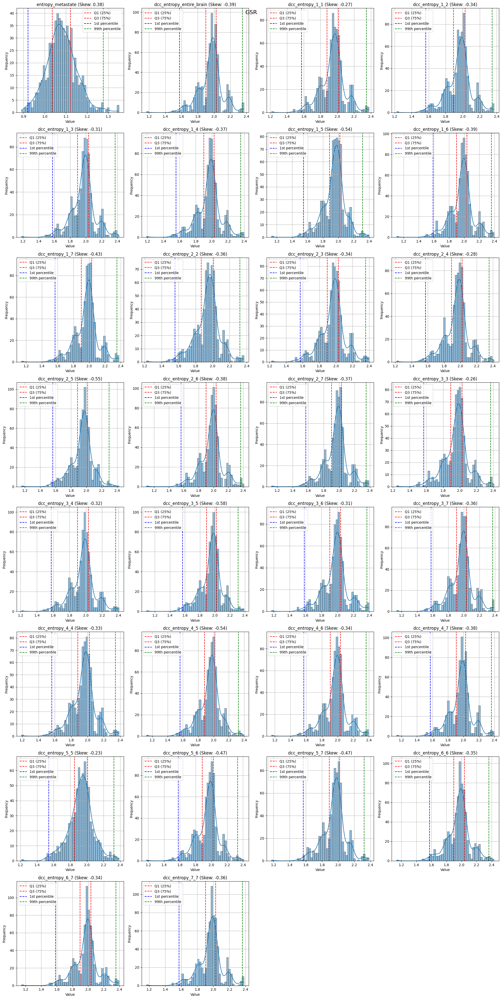


Summary Statistics for GSR:
                  Column  Skewness  1st Percentile  95th Percentile  99th Percentile  Q1 (25th)  Q3 (75th)  Mild Outliers  Extreme Outliers
       entropy_metastate  0.384366        0.921167         1.194304         1.276300   1.035910   1.120815             17                 0
dcc_entropy_entire_brain -0.389707        1.574200         2.193868         2.350535   1.899759   2.024919             59                 5
         dcc_entropy_1_1 -0.271746        1.572596         2.179013         2.348442   1.876678   2.014906             55                 1
         dcc_entropy_1_2 -0.344411        1.565435         2.198470         2.347005   1.890765   2.027825             59                 1
         dcc_entropy_1_3 -0.310419        1.575878         2.208649         2.369454   1.893987   2.034296             58                 1
         dcc_entropy_1_4 -0.365021        1.555784         2.196053         2.355392   1.900001   2.029315             63          

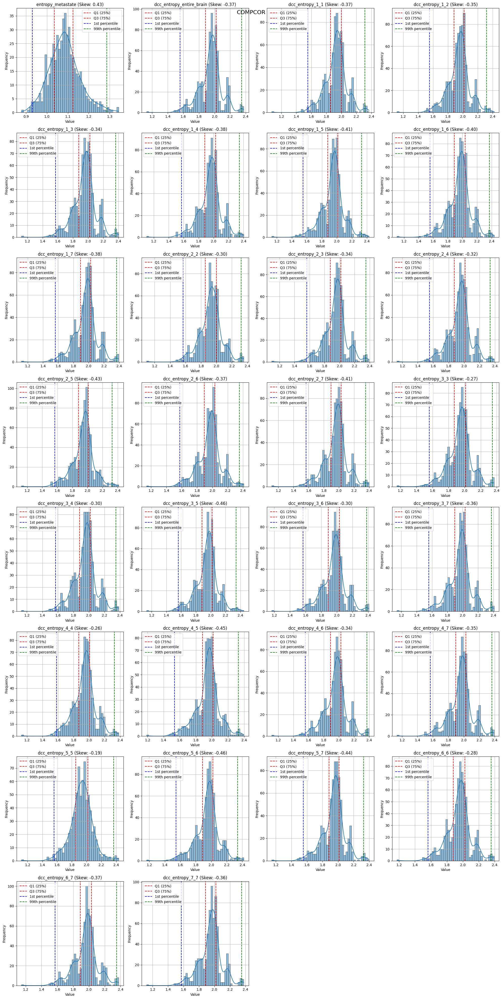


Summary Statistics for COMPCOR:
                  Column  Skewness  1st Percentile  95th Percentile  99th Percentile  Q1 (25th)  Q3 (75th)  Mild Outliers  Extreme Outliers
       entropy_metastate  0.430520        0.929799         1.219961         1.286418   1.035100   1.125200             12                 0
dcc_entropy_entire_brain -0.370191        1.559358         2.178635         2.348340   1.886105   2.019616             56                 1
         dcc_entropy_1_1 -0.372810        1.551604         2.149989         2.315156   1.857163   2.000823             48                 1
         dcc_entropy_1_2 -0.350493        1.552261         2.181655         2.319396   1.879778   2.016408             52                 1
         dcc_entropy_1_3 -0.339291        1.569580         2.187281         2.363459   1.878343   2.025794             48                 1
         dcc_entropy_1_4 -0.377706        1.571106         2.186342         2.345561   1.881563   2.026017             49      

,Column,Skewness,1st Percentile,95th Percentile,99th Percentile,Q1 (25th),Q3 (75th),Mild Outliers,Extreme Outliers
0,entropy_metastate,0.430520,0.929799,1.219961,1.286418,1.035100,1.125200,12,0
1,dcc_entropy_entire_brain,-0.370191,1.559358,2.178635,2.348340,1.886105,2.019616,56,1
2,dcc_entropy_1_1,-0.372810,1.551604,2.149989,2.315156,1.857163,2.000823,48,1
3,dcc_entropy_1_2,-0.350493,1.552261,2.181655,2.319396,1.879778,2.016408,52,1
4,dcc_entropy_1_3,-0.339291,1.569580,2.187281,2.363459,1.878343,2.025794,48,1
5,dcc_entropy_1_4,-0.377706,1.571106,2.186342,2.345561,1.881563,2.026017,49,1
6,dcc_entropy_1_5,-0.405856,1.550534,2.166826,2.330425,1.877704,2.012889,51,4
7,dcc_entropy_1_6,-0.395218,1.555589,2.201848,2.367742,1.889827,2.038596,52,2
8,dcc_entropy_1_7,-0.380849,1.563868,2.194571,2.366411,1.893060,2.027374,55,3
9,dcc_entropy_2_2,-0.300415,1.566808,2.155349,2.318672,1.854010,1.999193,44,1


In [131]:
columns_to_check = ['entropy_metastate'] + [col for col in df_mot_exc.columns if col.startswith("dcc_entropy_")]

analyze_columns_dataexp(df_motexc_gsr, columns_to_check, grid_title="GSR")
analyze_columns_dataexp(df_motexc_compcor, columns_to_check, grid_title="COMPCOR")


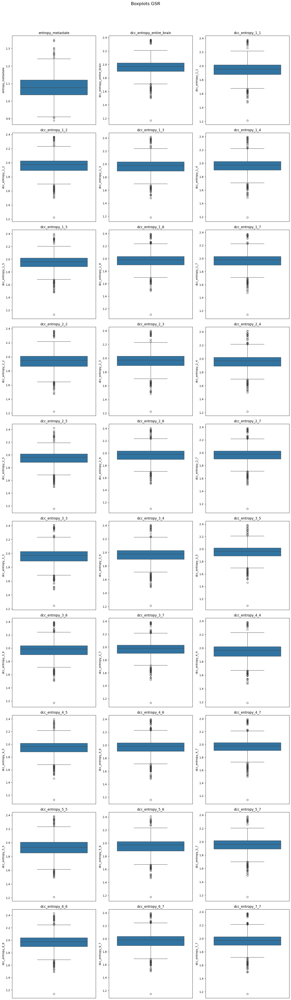

In [132]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the number of rows and columns for the grid
n_cols = 3
n_rows = len(columns_for_exp) // n_cols + (len(columns_for_exp) % n_cols > 0)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))

# Set the title for the entire plot grid
fig.suptitle('Boxplots GSR', fontsize=16, y=1.02)

# Flatten the axes array for easy iteration
axes = axes.flatten()

for i, col in enumerate(columns_for_exp):
    sns.boxplot(data=df_motexc_gsr, y=col, ax=axes[i])
    axes[i].set_title(col)
    axes[i].set_xticks([])  # Hide x-ticks

# Remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

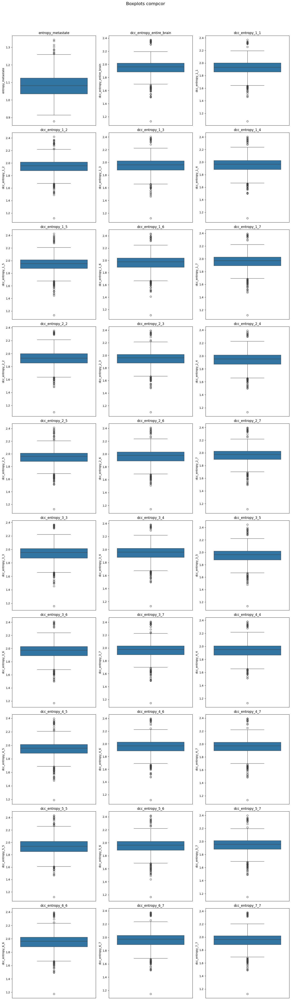

In [133]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the number of rows and columns for the grid
n_cols = 3
n_rows = len(columns_for_exp) // n_cols + (len(columns_for_exp) % n_cols > 0)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))

# Set the title for the entire plot grid
fig.suptitle('Boxplots compcor', fontsize=16, y=1.02)

# Flatten the axes array for easy iteration
axes = axes.flatten()

for i, col in enumerate(columns_for_exp):
    sns.boxplot(data=df_motexc_compcor, y=col, ax=axes[i])
    axes[i].set_title(col)
    axes[i].set_xticks([])  # Hide x-ticks

# Remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

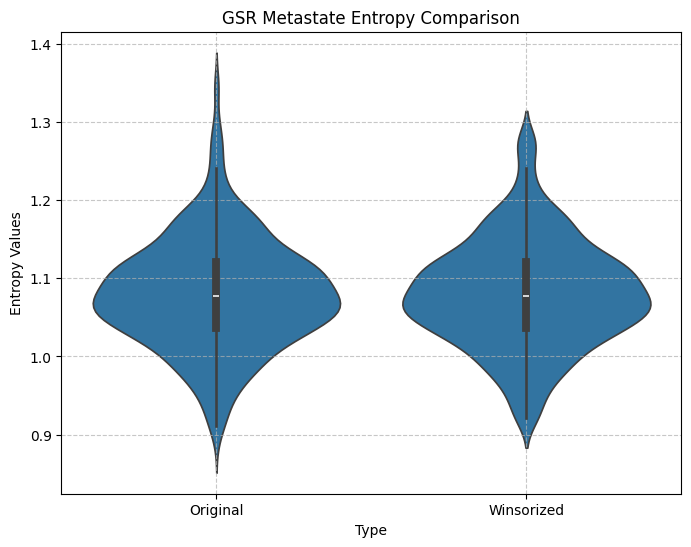


Summary Statistics for Metastate Entropy:
--------------------------------------------------

entropy_metastate:
Original  - Mean: 1.0804, Std: 0.0706, Skew: 0.3844
Winsorized - Mean: 1.0801, Std: 0.0690, Skew: 0.2633
Modified values: 13 (2.04% of non-NaN values)


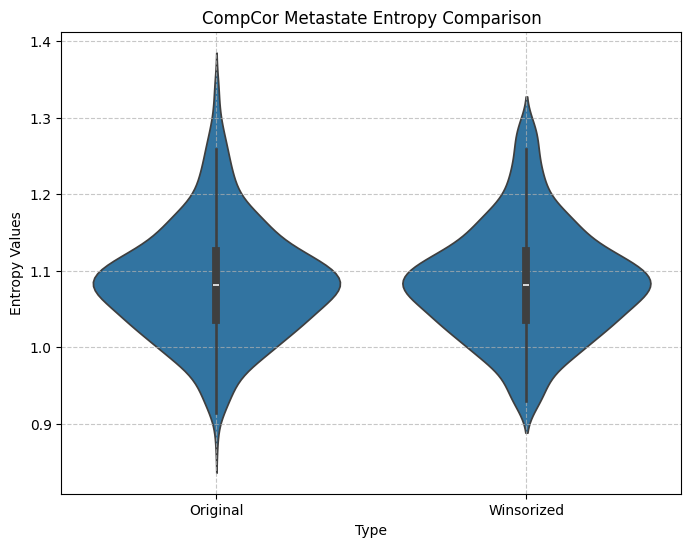


Summary Statistics for Metastate Entropy:
--------------------------------------------------

entropy_metastate:
Original  - Mean: 1.0846, Std: 0.0733, Skew: 0.4305
Winsorized - Mean: 1.0845, Std: 0.0720, Skew: 0.3836
Modified values: 12 (2.31% of non-NaN values)


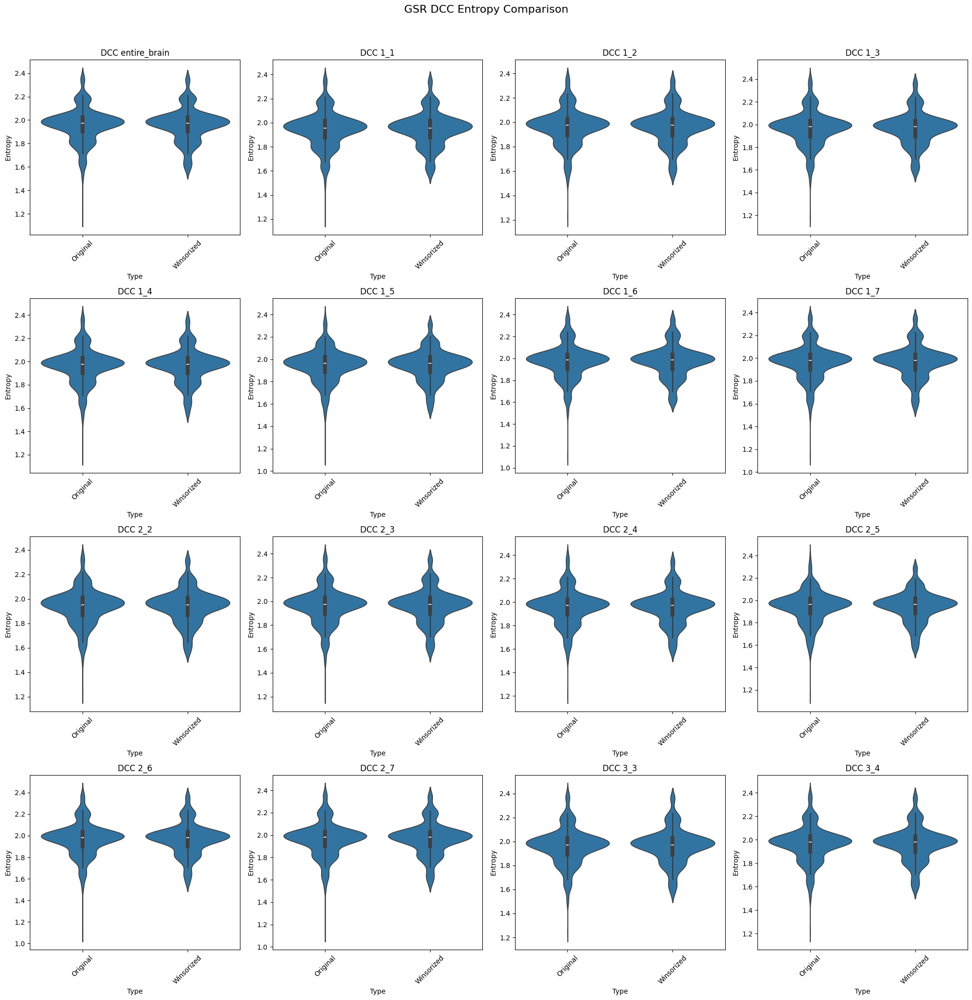


Summary Statistics for DCC Entropy:
--------------------------------------------------

dcc_entropy_entire_brain:
Original  - Mean: 1.9575, Std: 0.1466, Skew: -0.3897
Winsorized - Mean: 1.9584, Std: 0.1429, Skew: -0.1756
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_1:
Original  - Mean: 1.9457, Std: 0.1465, Skew: -0.2717
Winsorized - Mean: 1.9466, Std: 0.1430, Skew: -0.0949
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_2:
Original  - Mean: 1.9597, Std: 0.1479, Skew: -0.3444
Winsorized - Mean: 1.9603, Std: 0.1447, Skew: -0.1973
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_3:
Original  - Mean: 1.9662, Std: 0.1515, Skew: -0.3104
Winsorized - Mean: 1.9670, Std: 0.1473, Skew: -0.1198
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_4:
Original  - Mean: 1.9628, Std: 0.1484, Skew: -0.3650
Winsorized - Mean: 1.9633, Std: 0.1449, Skew: -0.2136
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_5:
Original  - Mean: 1.9452, Std:

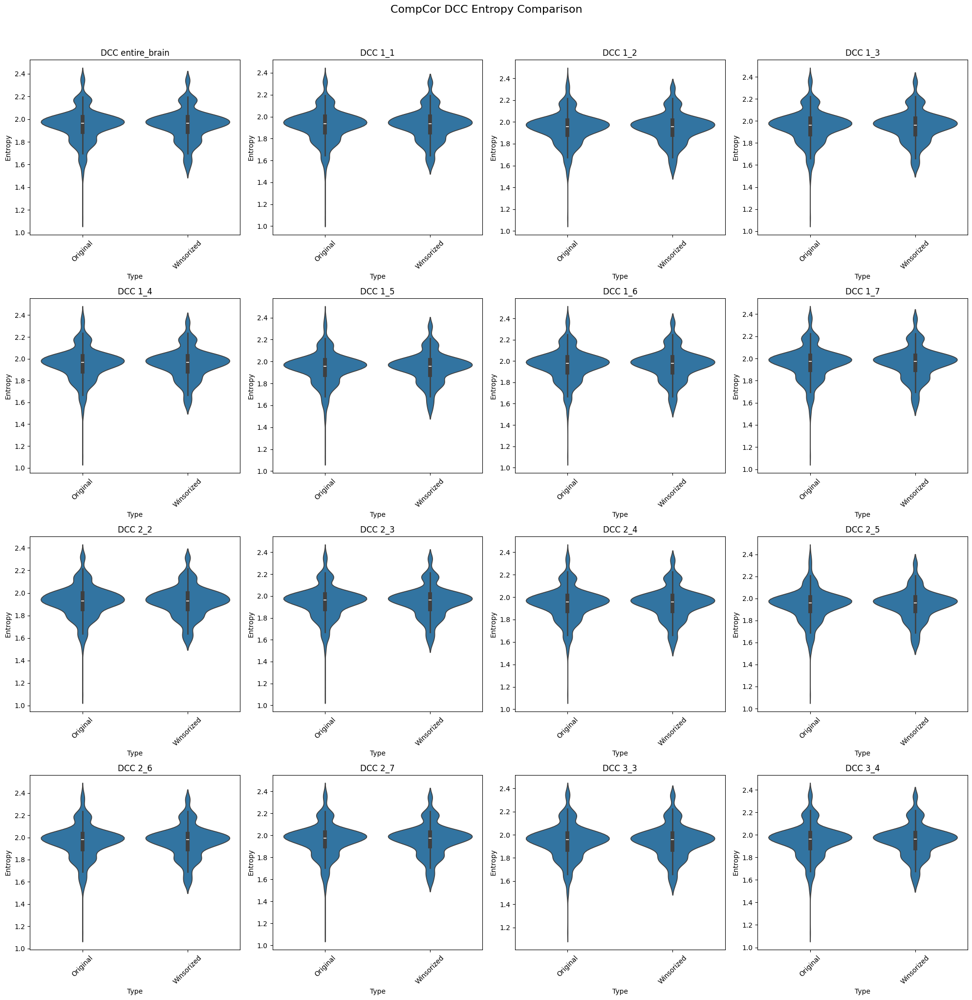


Summary Statistics for DCC Entropy:
--------------------------------------------------

dcc_entropy_entire_brain:
Original  - Mean: 1.9489, Std: 0.1459, Skew: -0.3702
Winsorized - Mean: 1.9497, Std: 0.1421, Skew: -0.1435
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_1:
Original  - Mean: 1.9259, Std: 0.1450, Skew: -0.3728
Winsorized - Mean: 1.9268, Std: 0.1404, Skew: -0.1088
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_2:
Original  - Mean: 1.9460, Std: 0.1453, Skew: -0.3505
Winsorized - Mean: 1.9465, Std: 0.1408, Skew: -0.1681
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_3:
Original  - Mean: 1.9522, Std: 0.1486, Skew: -0.3393
Winsorized - Mean: 1.9532, Std: 0.1442, Skew: -0.0901
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_4:
Original  - Mean: 1.9532, Std: 0.1479, Skew: -0.3777
Winsorized - Mean: 1.9541, Std: 0.1430, Skew: -0.1421
Modified values: 16 (2.19% of non-NaN values)

dcc_entropy_1_5:
Original  - Mean: 1.9432, Std:

In [134]:
# winsorization metastate and dcc in one go

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

### ---- WINSORIZATION GENERAL FUNCTION ---- ###
def winsorize_array(array, limits=(0.02, 0.02)):
    """
    Winsorize an array by replacing extreme values with percentile limits.
    Properly handles NaN values.
    """
    result = array.copy()
    if not np.all(np.isnan(array)):  # Only apply winsorization if data is not all NaN
        lower = np.nanpercentile(array, limits[0] * 100)
        upper = np.nanpercentile(array, (1 - limits[1]) * 100)
        
        # Clip values, preserving NaNs
        mask = ~np.isnan(result)
        result[mask] = np.clip(result[mask], lower, upper)
    
    return result

### ---- METASTATE ENTROPY WINSORIZATION ---- ###
def winsorize_metastate_entropy(df, limits=(0.01, 0.01)):
    """
    Winsorize metastate entropy values. 
    Limits of 0.01,0.01 (1%) chosen based on analysis of outliers and skewness + visual inspection of
    boxplots, affecting ~2% of the data in total
    """
    df_copy = df.copy()
    if 'entropy_metastate' in df_copy.columns:
        df_copy['entropy_metastate'] = winsorize_array(df_copy['entropy_metastate'].values, limits=limits)
    return df_copy

### ---- DCC ENTROPY WINSORIZATION ---- ###
def winsorize_dcc_entropy(df, limits=(0.01, 0.01)):
    """
    Winsorize all DCC entropy columns.
    Limits of 0.01,0.01 (1%) chosen based on analysis of outliers and skewness + visual inspection of
    boxplots, affecting ~2% of the data in total
    """
    df_copy = df.copy()
    dcc_entropy_columns = [col for col in df_copy.columns if col.startswith("dcc_entropy_")]
    
    for col in dcc_entropy_columns:
        df_copy[col] = winsorize_array(df_copy[col].values, limits=limits)
    
    return df_copy

### ---- METASTATE ENTROPY PLOTTING ---- ###
def plot_metastate_comparison(original_df, winsorized_df, title="Metastate Entropy Comparison"):
    """
    Plot comparison of original and winsorized metastate entropy values.
    """
    if 'entropy_metastate' not in original_df.columns:
        print("Skipping metastate entropy plot: No 'entropy_metastate' column found.")
        return
    
    plot_data = pd.DataFrame({
        'Original': original_df['entropy_metastate'],
        'Winsorized': winsorized_df['entropy_metastate']
    })
    
    # Melt for easier plotting
    plot_data_melted = pd.melt(plot_data, var_name='Type', value_name='Entropy')
    
    plt.figure(figsize=(8, 6))
    sns.violinplot(x='Type', y='Entropy', data=plot_data_melted)
    plt.title(title)
    plt.ylabel('Entropy Values')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.show()

### ---- DCC ENTROPY PLOTTING ---- ###
def plot_dcc_comparison(original_df, winsorized_df, title="DCC Entropy Comparison"):
    """
    Plot comparison of original and winsorized values for DCC entropy.
    """
    dcc_entropy_columns = [col for col in original_df.columns if col.startswith("dcc_entropy_")]
    
    if not dcc_entropy_columns:
        print(f"Skipping DCC entropy plot: No 'dcc_entropy_' columns found in {title}.")
        return
    
    # Limit to max 16 columns to avoid overcrowding
    dcc_entropy_columns = dcc_entropy_columns[:16]
    
    rows = (len(dcc_entropy_columns) + 3) // 4  # Ceiling division
    fig, axes = plt.subplots(rows, 4, figsize=(20, 5 * rows))
    axes = axes.flatten()
    
    for idx, col in enumerate(dcc_entropy_columns):
        plot_data = pd.DataFrame({
            'Original': original_df[col].values,
            'Winsorized': winsorized_df[col].values
        })
        
        plot_data_melted = pd.melt(plot_data, var_name='Type', value_name='Entropy')
        
        sns.violinplot(x='Type', y='Entropy', data=plot_data_melted, ax=axes[idx])
        axes[idx].set_title(col.replace('dcc_entropy_', 'DCC '))
        axes[idx].tick_params(axis='x', rotation=45)
    
    for idx in range(len(dcc_entropy_columns), len(axes)):
        fig.delaxes(axes[idx])
    
    plt.suptitle(title, y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

### ---- SUMMARY STATISTICS ---- ###
def print_summary_statistics(original_df, winsorized_df, entropy_type="Metastate"):
    """
    Print summary statistics for original and winsorized entropy.
    """
    print(f"\nSummary Statistics for {entropy_type} Entropy:")
    print("-" * 50)
    
    entropy_columns = [col for col in original_df.columns if col.startswith("dcc_entropy_")] if entropy_type == "DCC" else ["entropy_metastate"]
    
    for col in entropy_columns:
        if col not in original_df.columns:
            continue  # Skip missing columns

        orig_values = original_df[col].values
        wins_values = winsorized_df[col].values
        
        orig_mean, orig_std = np.nanmean(orig_values), np.nanstd(orig_values)
        wins_mean, wins_std = np.nanmean(wins_values), np.nanstd(wins_values)
        
        orig_valid = orig_values[~np.isnan(orig_values)]
        wins_valid = wins_values[~np.isnan(wins_values)]
        
        orig_skew = stats.skew(orig_valid) if len(orig_valid) > 0 else np.nan
        wins_skew = stats.skew(wins_valid) if len(wins_valid) > 0 else np.nan
        
        print(f"\n{col}:")
        print(f"Original  - Mean: {orig_mean:.4f}, Std: {orig_std:.4f}, Skew: {orig_skew:.4f}")
        print(f"Winsorized - Mean: {wins_mean:.4f}, Std: {wins_std:.4f}, Skew: {wins_skew:.4f}")
        
        mask = ~np.isnan(orig_values) & ~np.isnan(wins_values)
        n_modified = np.sum(orig_values[mask] != wins_values[mask])
        n_total = np.sum(mask)
        
        print(f"Modified values: {n_modified} ({(n_modified/n_total)*100:.2f}% of non-NaN values)")

### ---- MAIN FUNCTION ---- ###
def main():
    global df_mot_exc, df_winsorized_gsr, df_winsorized_compcor

    # Ensure df_mot_exc exists
    if 'df_mot_exc' not in globals():
        raise ValueError("df_mot_exc is not defined. Load your dataset before running this script.")

    # Filter by conreg
    df_motexc_gsr = df_mot_exc[df_mot_exc['conreg'] == 'gsr']
    df_motexc_compcor = df_mot_exc[df_mot_exc['conreg'] == 'compcor']
    
    # Winsorize metastate entropy
    df_winsorized_gsr = winsorize_metastate_entropy(df_motexc_gsr, limits=(0.01, 0.01))
    df_winsorized_compcor = winsorize_metastate_entropy(df_motexc_compcor, limits=(0.01, 0.01))

    # Winsorize DCC entropy (in case metastate is not done first)
    #df_winsorized_gsr = winsorize_dcc_entropy(df_motexc_gsr, limits=(0.01, 0.01))
    #df_winsorized_compcor = winsorize_dcc_entropy(df_motexc_compcor, limits=(0.01, 0.01))

    # Code for when metastate entropy is winsorized first
    df_winsorized_gsr = winsorize_dcc_entropy(df_winsorized_gsr, limits=(0.01, 0.01))
    df_winsorized_compcor = winsorize_dcc_entropy(df_winsorized_compcor, limits=(0.01, 0.01))
    
    # Generate all plots and statistics
    plot_metastate_comparison(df_motexc_gsr, df_winsorized_gsr, title="GSR Metastate Entropy Comparison")
    print_summary_statistics(df_motexc_gsr, df_winsorized_gsr, entropy_type="Metastate")

    plot_metastate_comparison(df_motexc_compcor, df_winsorized_compcor, title="CompCor Metastate Entropy Comparison")
    print_summary_statistics(df_motexc_compcor, df_winsorized_compcor, entropy_type="Metastate")

    plot_dcc_comparison(df_motexc_gsr, df_winsorized_gsr, title="GSR DCC Entropy Comparison")
    print_summary_statistics(df_motexc_gsr, df_winsorized_gsr, entropy_type="DCC")

    plot_dcc_comparison(df_motexc_compcor, df_winsorized_compcor, title="CompCor DCC Entropy Comparison")
    print_summary_statistics(df_motexc_compcor, df_winsorized_compcor, entropy_type="DCC")

if __name__ == "__main__":
    main()

* df_mot_exc, df_motexc_gsr, and df_motexc_compcor are non winsorized!
* df_winsorized_gsr and df_winsorized_compcor are winsorized at 1% and 2% limits for metastate and dcc, respectively

In [135]:
df_winsorized = pd.concat([df_winsorized_gsr, df_winsorized_compcor], ignore_index=True)

In [ ]:
# compcor df to csv
# df_winsorized_compcor.to_csv('/Users/olivier/Documents/MSc/thesis/Analysis_Oli/df_compcor_winsorized.csv')

### Scaling


Data Distribution Analysis for entropy_metastate (GSR):
--------------------------------------------------
Missing values: 96
Mean: 1.0801
Std: 0.0690
Min: 0.9212
Max: 1.2763
Skewness: 0.2633
Kurtosis: 0.2780

Data Distribution Analysis for dcc_entropy_entire_brain (GSR):
--------------------------------------------------
Missing values: 0
Mean: 1.9584
Std: 0.1429
Min: 1.5742
Max: 2.3505
Skewness: -0.1756
Kurtosis: 0.8354

Data Distribution Analysis for dcc_entropy_1_1 (GSR):
--------------------------------------------------
Missing values: 0
Mean: 1.9466
Std: 0.1430
Min: 1.5726
Max: 2.3484
Skewness: -0.0949
Kurtosis: 0.7271

Data Distribution Analysis for dcc_entropy_1_2 (GSR):
--------------------------------------------------
Missing values: 0
Mean: 1.9603
Std: 0.1447
Min: 1.5654
Max: 2.3470
Skewness: -0.1973
Kurtosis: 0.7826

Data Distribution Analysis for dcc_entropy_1_3 (GSR):
--------------------------------------------------
Missing values: 0
Mean: 1.9670
Std: 0.1473
Min: 1.5

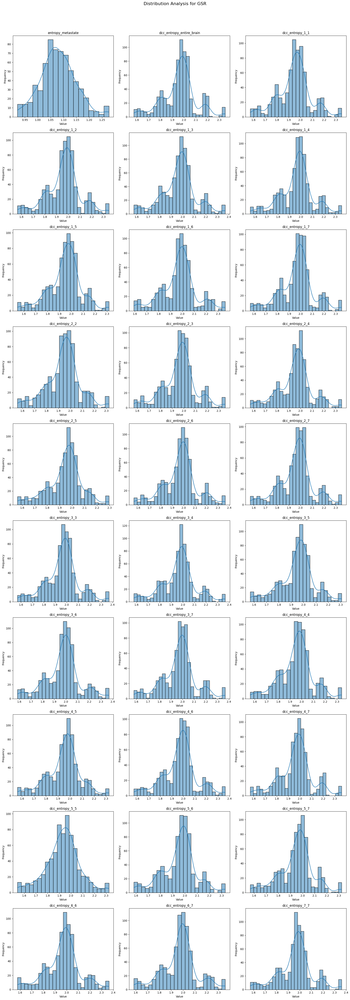


Data Distribution Analysis for entropy_metastate (CompCor):
--------------------------------------------------
Missing values: 213
Mean: 1.0845
Std: 0.0720
Min: 0.9298
Max: 1.2864
Skewness: 0.3836
Kurtosis: 0.2415

Data Distribution Analysis for dcc_entropy_entire_brain (CompCor):
--------------------------------------------------
Missing values: 0
Mean: 1.9497
Std: 0.1421
Min: 1.5594
Max: 2.3483
Skewness: -0.1435
Kurtosis: 0.8887

Data Distribution Analysis for dcc_entropy_1_1 (CompCor):
--------------------------------------------------
Missing values: 0
Mean: 1.9268
Std: 0.1404
Min: 1.5516
Max: 2.3152
Skewness: -0.1088
Kurtosis: 0.7426

Data Distribution Analysis for dcc_entropy_1_2 (CompCor):
--------------------------------------------------
Missing values: 0
Mean: 1.9465
Std: 0.1408
Min: 1.5523
Max: 2.3194
Skewness: -0.1681
Kurtosis: 0.7097

Data Distribution Analysis for dcc_entropy_1_3 (CompCor):
--------------------------------------------------
Missing values: 0
Mean: 1.9532

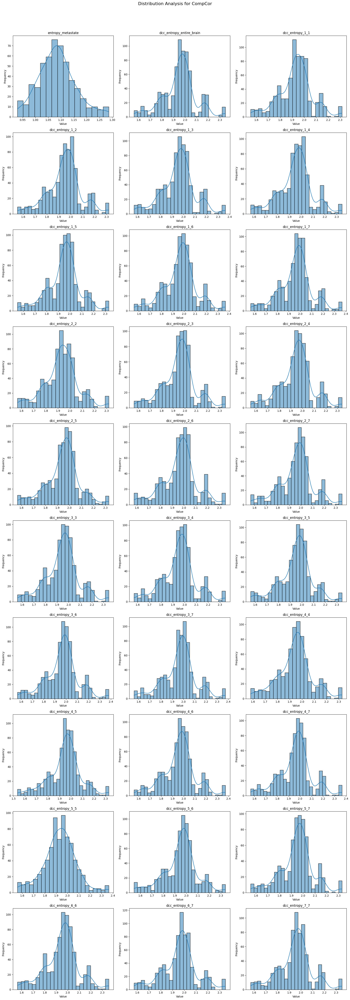

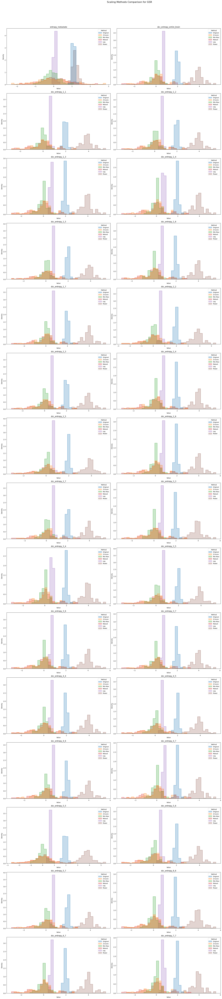

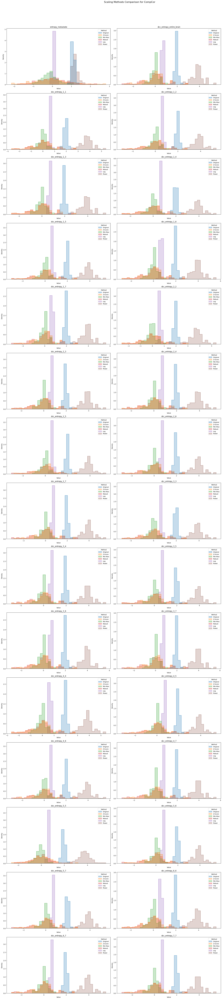


Scaling Methods Comparison for entropy_metastate (GSR):
--------------------------------------------------
Missing values: 96

Original Data:
Mean: 1.0801
Std: 0.0690
Range: 0.3551
Variance: 0.0048

Z-Score Scaled:
Mean: nan
Std: nan
Range: nan
Variance: nan

Min-Max Scaled:
Mean: nan
Std: nan
Range: nan
Variance: nan

Robust Scaled:
Mean: nan
Std: nan
Range: nan
Variance: nan

Log Scaled:
Mean: nan
Std: nan
Range: nan
Variance: nan

Power Scaled:
Mean: nan
Std: nan
Range: nan
Variance: nan

Scaling Methods Comparison for dcc_entropy_entire_brain (GSR):
--------------------------------------------------
Missing values: 0

Original Data:
Mean: 1.9584
Std: 0.1429
Range: 0.7763
Variance: 0.0204

Z-Score Scaled:
Mean: 0.0000
Std: 1.0000
Range: 5.4338
Variance: 1.0000

Min-Max Scaled:
Mean: -0.0102
Std: 0.3681
Range: 2.0000
Variance: 0.1355

Robust Scaled:
Mean: -0.1079
Std: 1.1415
Range: 6.2028
Variance: 1.3031

Log Scaled:
Mean: 0.6694
Std: 0.0741
Range: 0.4009
Variance: 0.0055

Power Sc

In [144]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import math

def get_scaling_methods(values):
    """
    Apply different scaling methods to the given values.
    Returns a dictionary containing scaled values for each method,
    preserving the original array shape (i.e., positions with NaN remain NaN).
    
    Parameters:
    -----------
    values : numpy array
        Array of values to scale
        
    Returns:
    --------
    dict
        Dictionary containing scaled values for each method
    """
    # Flatten the input values for processing
    orig = values.flatten()
    scaled_data = {}
    
    # Create a base output array filled with NaNs
    output = np.full(orig.shape, np.nan)
    
    # Identify indices with valid (non-NaN) values
    valid_indices = ~np.isnan(orig)
    valid_values = orig[valid_indices].reshape(-1, 1)
    
    if len(valid_values) == 0:
        return {}  # Return empty dict if no valid values
    
    # Z-score standardization (StandardScaler)
    scaler = StandardScaler()
    scaled = scaler.fit_transform(valid_values).flatten()
    output[valid_indices] = scaled
    scaled_data['Z-Score'] = output.copy()
    
    # Min-Max Scaling to [-1, 1]
    scaler = MinMaxScaler(feature_range=(-1, 1))
    scaled = scaler.fit_transform(valid_values).flatten()
    output[valid_indices] = scaled
    scaled_data['Min-Max'] = output.copy()

    # Robust Scaling
    scaler = RobustScaler()
    scaled = scaler.fit_transform(valid_values).flatten()
    output[valid_indices] = scaled
    scaled_data['Robust'] = output.copy()

    # Log transformation (only if all valid values are positive)
    if np.all(valid_values > 0):
        scaled = np.log(valid_values).flatten()
        output[valid_indices] = scaled
        scaled_data['Log'] = output.copy()

    # Power transformation (squaring the values)
    scaled = np.power(valid_values, 2).flatten()
    output[valid_indices] = scaled
    scaled_data['Power'] = output.copy()

    return scaled_data


def analyze_data_distribution(df_dict, entropy_metrics, degrees=None, plot_degrees=None, plot=True):
    """
    Analyze the distribution of specified entropy metrics in the datasets with grid layout.
    """
    for subset_name, df in df_dict.items():
        # Calculate number of plots needed
        n_plots = len(entropy_metrics)
        if 'entropy_pl' in entropy_metrics and plot_degrees is not None:
            n_plots = n_plots - 1 + len(plot_degrees)
        
        # Calculate grid dimensions
        n_cols = min(3, n_plots)  # Maximum 3 columns
        n_rows = math.ceil(n_plots / n_cols)
        
        if plot:
            fig = plt.figure(figsize=(6*n_cols, 5*n_rows))
            plt.suptitle(f'Distribution Analysis for {subset_name}', y=1.02, fontsize=16)
        
        plot_idx = 1
        
        for metric in entropy_metrics:
            print(f"\nData Distribution Analysis for {metric} ({subset_name}):")
            print("-" * 50)
            data = df[metric]
            
            if metric == 'entropy_pl' and degrees is not None:
                data_array = np.vstack(data)
                for degree in degrees:
                    if plot_degrees is not None and degree not in plot_degrees:
                        continue
                    
                    idx = degree - 1
                    values = data_array[:, idx]
                    # Drop NaN values
                    valid_values = values[~np.isnan(values)]
                    
                    if len(valid_values) > 0:
                        print(f"\nMean Degree {degree}:")
                        print(f"Missing values: {len(values) - len(valid_values)}")
                        print(f"Mean: {np.mean(valid_values):.4f}")
                        print(f"Std: {np.std(valid_values):.4f}")
                        print(f"Range: {np.ptp(valid_values):.4f}")
                        print(f"Skewness: {stats.skew(valid_values):.4f}")
                        print(f"Kurtosis: {stats.kurtosis(valid_values):.4f}")
                        
                        if plot:
                            plt.subplot(n_rows, n_cols, plot_idx)
                            sns.histplot(valid_values, kde=True)
                            plt.title(f'{metric}\nDegree {degree}')
                            plt.xlabel('Value')
                            plt.ylabel('Frequency')
                            plot_idx += 1
                    else:
                        print(f"\nMean Degree {degree}: No valid data (all NaN)")
            
            else:
                values = data.values
                # Drop NaN values
                valid_values = values[~np.isnan(values)]
                
                if len(valid_values) > 0:
                    print(f"Missing values: {len(values) - len(valid_values)}")
                    print(f"Mean: {np.mean(valid_values):.4f}")
                    print(f"Std: {np.std(valid_values):.4f}")
                    print(f"Min: {np.min(valid_values):.4f}")
                    print(f"Max: {np.max(valid_values):.4f}")
                    print(f"Skewness: {stats.skew(valid_values):.4f}")
                    print(f"Kurtosis: {stats.kurtosis(valid_values):.4f}")
                    
                    if plot:
                        plt.subplot(n_rows, n_cols, plot_idx)
                        sns.histplot(valid_values, kde=True)
                        plt.title(metric)
                        plt.xlabel('Value')
                        plt.ylabel('Frequency')
                        plot_idx += 1
                else:
                    print(f"No valid data for {metric} (all NaN)")
        
        if plot:
            plt.tight_layout()
            plt.show()

def compare_scaling_methods(df_dict, entropy_metrics, degrees=None):
    """
    Compare different scaling methods for the specified entropy metrics.

    Parameters:
    -----------
    df_dict : dict
        Dictionary of DataFrames with subset names as keys.
    entropy_metrics : list
        List of entropy metric column names to scale
    degrees : list or range, optional
        Degrees to analyze for 'entropy_pl' metric.

    Returns:
    --------
    dict
        Nested dictionary containing scaled data for each subset and metric
    """
    scaled_data_all = {}
    for subset_name, df in df_dict.items():
        scaled_data = {}
        for metric in entropy_metrics:
            data = df[metric]
            if metric == 'entropy_pl' and degrees is not None:
                # Handle 'entropy_pl' with specified degrees
                data_array = np.vstack(data)
                scaled_data_per_degree = {}
                for degree in degrees:
                    idx = degree - 1
                    values = data_array[:, idx].reshape(-1, 1)
                    methods = get_scaling_methods(values)
                    scaled_data_per_degree[degree] = methods
                scaled_data[metric] = scaled_data_per_degree
            else:
                # Scalar data
                values = data.values.reshape(-1, 1)
                methods = get_scaling_methods(values)
                scaled_data[metric] = methods
        scaled_data_all[subset_name] = scaled_data
    return scaled_data_all

def visualize_scaling_comparison(df_dict, scaled_data_all, entropy_metrics, degrees=None, plot_degrees=None):
    """
    Visualize the distribution of data after different scaling methods in a grid layout.
    """
    for subset_name, df in df_dict.items():
        scaled_data = scaled_data_all[subset_name]
        
        # Calculate number of plots needed
        n_plots = len(entropy_metrics)
        if 'entropy_pl' in entropy_metrics and plot_degrees is not None:
            n_plots = n_plots - 1 + len(plot_degrees)
        
        # Calculate grid dimensions
        n_cols = min(2, n_plots)  # Maximum 2 columns due to more complex plots
        n_rows = math.ceil(n_plots / n_cols)
        
        # Create figure with extra width for legend
        fig = plt.figure(figsize=(12*n_cols, 6*n_rows))  # Even wider figure
        
        # Create gridspec to manage subplot layout
        gs = fig.add_gridspec(n_rows, n_cols)
        
        plt.suptitle(f'Scaling Methods Comparison for {subset_name}', y=1.02, fontsize=16)
        
        plot_idx = 1
        
        for metric in entropy_metrics:
            data = df[metric]
            if metric == 'entropy_pl' and degrees is not None:
                data_array = np.vstack(data)
                for degree in degrees:
                    if plot_degrees is not None and degree not in plot_degrees:
                        continue
                    
                    idx = degree - 1
                    original_values = data_array[:, idx]
                    methods = scaled_data[metric][degree]
                    
                    plot_df = pd.DataFrame({'Original': original_values})
                    for method, scaled_values in methods.items():
                        plot_df[method] = scaled_values
                    
                    plot_df_melted = plot_df.melt(var_name='Method', value_name='Value')
                    
                    # Create subplot with gridspec
                    row = (plot_idx - 1) // n_cols
                    col = (plot_idx - 1) % n_cols
                    ax = fig.add_subplot(gs[row, col])
                    
                    # Create plot
                    sns.histplot(data=plot_df_melted, x='Value', hue='Method', 
                               element='step', stat='density', common_norm=False, ax=ax, legend=True)
                    ax.set_title(f'{metric}\nDegree {degree}')
                    ax.set_xlabel('Value')
                    ax.set_ylabel('Density')
                    ax.legend(title="Method", frameon=True, bbox_to_anchor=(0.8, 0.9), loc='upper right')

                    # Move legend outside of plot
                    #ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
                    
                    plot_idx += 1
            
            else:
                original_values = data.values
                methods = scaled_data[metric]
                
                plot_df = pd.DataFrame({'Original': original_values})
                for method, scaled_values in methods.items():
                    plot_df[method] = scaled_values
                
                plot_df_melted = plot_df.melt(var_name='Method', value_name='Value')
                
                # Create subplot with gridspec
                row = (plot_idx - 1) // n_cols
                col = (plot_idx - 1) % n_cols
                ax = fig.add_subplot(gs[row, col])
                
                # Create plot
                sns.histplot(data=plot_df_melted, x='Value', hue='Method', 
                           element='step', stat='density', common_norm=False, ax=ax, legend=True)
                ax.set_title(metric)
                ax.set_xlabel('Value')
                ax.set_ylabel('Density')
                handles, labels = ax.get_legend_handles_labels()
                
                if len(handles) > 0:  # Ensure there are labels
                    ax.legend(handles, labels, title="Method", loc='upper right', frameon=True)  

                # Move legend outside of plot
                #ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
                
                plot_idx += 1
        
        # Adjust layout while preserving space for legend
        plt.tight_layout()
        # Add additional spacing on the right for legends
        plt.subplots_adjust(right=0.85)
        plt.show()

def print_scaling_statistics(df_dict, scaled_data_all, entropy_metrics, degrees=None):
    """
    Print summary statistics for each scaling method.

    Parameters:
    -----------
    df_dict : dict
        Dictionary of DataFrames with subset names as keys.
    scaled_data_all : dict
        Nested dictionary containing scaled data for each subset and metric
    entropy_metrics : list
        List of entropy metrics
    degrees : list or range, optional
        Degrees to analyze for 'entropy_pl' metric.
    """
    for subset_name, df in df_dict.items():
        scaled_data = scaled_data_all[subset_name]
        for metric in entropy_metrics:
            print(f"\nScaling Methods Comparison for {metric} ({subset_name}):")
            print("-" * 50)
            data = df[metric]
            if metric == 'entropy_pl' and degrees is not None:
                # Handle 'entropy_pl' with specified degrees
                data_array = np.vstack(data)
                for degree in degrees:
                    idx = degree - 1
                    original_values = data_array[:, idx]
                    # Skip NaN values
                    valid_values = original_values[~np.isnan(original_values)]
                    
                    # Check if we have any valid values and if the metric is in the scaled data
                    if len(valid_values) > 0 and metric in scaled_data and degree in scaled_data[metric]:
                        methods = scaled_data[metric][degree]
                        print(f"\nDegree {degree}:")
                        print(f"Missing values: {len(original_values) - len(valid_values)}")
                        print("\nOriginal Data:")
                        print(f"Mean: {np.mean(valid_values):.4f}")
                        print(f"Std: {np.std(valid_values):.4f}")
                        print(f"Range: {np.ptp(valid_values):.4f}")
                        print(f"Variance: {np.var(valid_values):.4f}")
                        for method, scaled_values in methods.items():
                            print(f"\n{method} Scaled:")
                            print(f"Mean: {np.mean(scaled_values):.4f}")
                            print(f"Std: {np.std(scaled_values):.4f}")
                            print(f"Range: {np.ptp(scaled_values):.4f}")
                            print(f"Variance: {np.var(scaled_values):.4f}")
                    else:
                        print(f"\nDegree {degree}: No valid data or scaling not performed")
            else:
                # Scalar data
                original_values = data.values
                # Skip NaN values
                valid_values = original_values[~np.isnan(original_values)]
                
                # Check if we have any valid values and if the metric is in the scaled data
                if len(valid_values) > 0 and metric in scaled_data:
                    methods = scaled_data[metric]
                    print(f"Missing values: {len(original_values) - len(valid_values)}")
                    print("\nOriginal Data:")
                    print(f"Mean: {np.mean(valid_values):.4f}")
                    print(f"Std: {np.std(valid_values):.4f}")
                    print(f"Range: {np.ptp(valid_values):.4f}")
                    print(f"Variance: {np.var(valid_values):.4f}")
                    for method, scaled_values in methods.items():
                        print(f"\n{method} Scaled:")
                        print(f"Mean: {np.mean(scaled_values):.4f}")
                        print(f"Std: {np.std(scaled_values):.4f}")
                        print(f"Range: {np.ptp(scaled_values):.4f}")
                        print(f"Variance: {np.var(scaled_values):.4f}")
                else:
                    print(f"No valid data for {metric} or scaling not performed")



if __name__ == "__main__":
    
    entropy_metrics = ['entropy_metastate', 'dcc_entropy_entire_brain']
    entropy_metrics.extend([f'dcc_entropy_{i}_{j}' 
                          for i in range(1, 8) 
                          for j in range(i, 8)])


    # path length code
    #degrees = range(24, 40)  # Degrees 24 to 39
    # Select degrees to plot to reduce the number of plots
    #plot_degrees = [24] #, 27, 30,33, 36, 39]  # Only plot these degrees

    # Create a dictionary of your datasets
    df_dict = {
        'GSR': df_winsorized_gsr,
        'CompCor': df_winsorized_compcor
    }

    # Analyze data distribution with fewer plots
    analyze_data_distribution(df_dict, entropy_metrics, degrees=None, plot_degrees=None)

    # Compare scaling methods
    scaled_data_all = compare_scaling_methods(df_dict, entropy_metrics, degrees=None)

    # Visualize scaling comparison with fewer plots
    visualize_scaling_comparison(df_dict, scaled_data_all, entropy_metrics, degrees=None, plot_degrees=None)

    # Print scaling statistics
    print_scaling_statistics(df_dict, scaled_data_all, entropy_metrics, degrees=None)


In [ ]:
from sklearn.preprocessing import StandardScaler
import numpy as np
import pandas as pd


# List of columns to apply StandardScaler
entropy_columns = [
    "entropy_metastate","dcc_entropy_entire_brain",
    "dcc_entropy_1_1", "dcc_entropy_1_2", "dcc_entropy_1_3", "dcc_entropy_1_4",
    "dcc_entropy_1_5", "dcc_entropy_1_6", "dcc_entropy_1_7", "dcc_entropy_2_2",
    "dcc_entropy_2_3", "dcc_entropy_2_4", "dcc_entropy_2_5", "dcc_entropy_2_6",
    "dcc_entropy_2_7", "dcc_entropy_3_3", "dcc_entropy_3_4", "dcc_entropy_3_5",
    "dcc_entropy_3_6", "dcc_entropy_3_7", "dcc_entropy_4_4", "dcc_entropy_4_5",
    "dcc_entropy_4_6", "dcc_entropy_4_7", "dcc_entropy_5_5", "dcc_entropy_5_6",
    "dcc_entropy_5_7", "dcc_entropy_6_6", "dcc_entropy_6_7", "dcc_entropy_7_7"
]

def apply_standard_scaling(df, entropy_columns):
    """
    Applies StandardScaler to the specified entropy metrics in the DataFrame.
    """
    df_scaled = df.copy()  # Make a copy to avoid modifying the original dataset
    
    scaler = StandardScaler()
    
    # Ensure the columns exist in df
    valid_columns = [col for col in entropy_columns if col in df.columns]
    df_scaled[valid_columns] = scaler.fit_transform(df_scaled[valid_columns])
    
    return df_scaled

# Apply Standard Scaling to both datasets
df_winsorized_gsr_scaled = apply_standard_scaling(df_winsorized_gsr, entropy_columns)
df_winsorized_compcor_scaled = apply_standard_scaling(df_winsorized_compcor, entropy_columns)

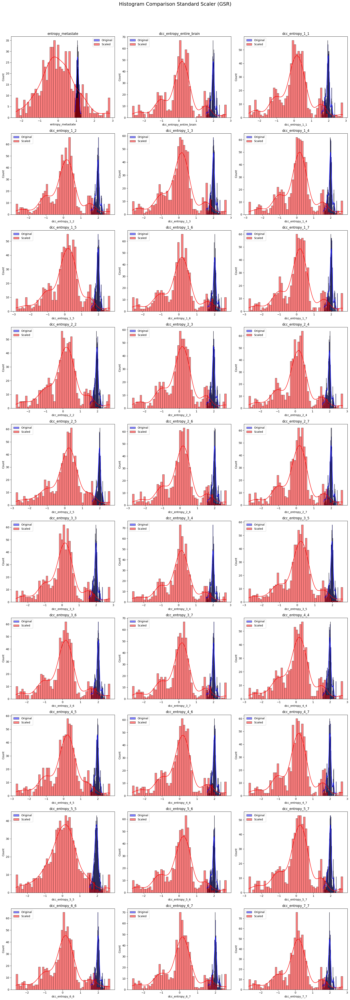

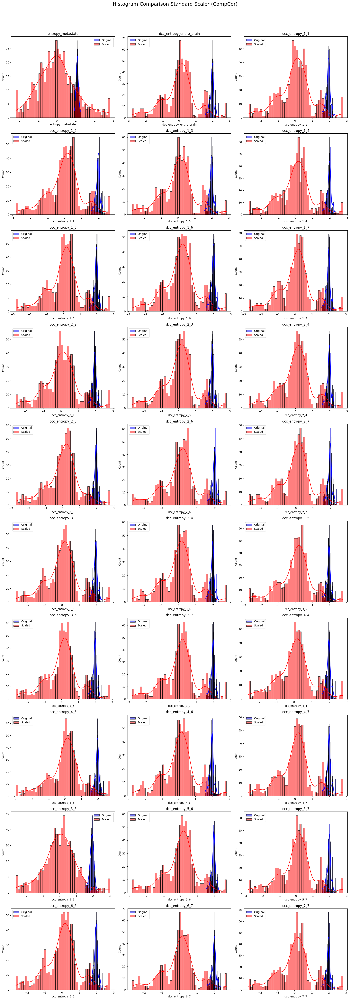

In [138]:
def plot_all_histograms(original_df, scaled_df, columns, title):

    n_cols = 3  # Number of columns per row
    n_rows = (len(columns) + n_cols - 1) // n_cols  # Auto-compute required rows

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows))  # Increase figure size
    axes = axes.flatten()

    for i, col in enumerate(columns):
        if col in original_df.columns and col in scaled_df.columns:
           
            original_data = original_df[col].dropna()
            scaled_data = scaled_df[col].dropna()

            sns.histplot(original_data, ax=axes[i], kde=True, bins=50, color="blue", label="Original", alpha=0.5)
            sns.histplot(scaled_data, ax=axes[i], kde=True, bins=50, color="red", label="Scaled", alpha=0.5)

            axes[i].set_title(col, fontsize=12)
            axes[i].legend()

    plt.suptitle(title, fontsize=18, y=1.02)
    plt.tight_layout()
    plt.show()

plot_all_histograms(df_winsorized_gsr, df_winsorized_gsr_scaled, entropy_columns, "Histogram Comparison Standard Scaler (GSR)")
plot_all_histograms(df_winsorized_compcor, df_winsorized_compcor_scaled, entropy_columns, "Histogram Comparison Standard Scaler (CompCor)")

In [142]:
# concatenate df_winsorized_scaled_gsr and df_winsorized_scaled_compcor
df_winsorized_scaled = pd.concat([df_winsorized_gsr_scaled, df_winsorized_compcor_scaled], ignore_index=True)

# Analysis ###

In [ ]:
# df to pickle to easily resume analysis if notebook is closed
df_winsorized_scaled.to_pickle('/Users/olivier/Documents/MSc/thesis/Analysis_Oli/df_winsorized_scaled_v6.pkl')
df_winsorized.to_pickle('/Users/olivier/Documents/MSc/thesis/Analysis_Oli/df_winsorized_v6.pkl')


In [4]:
# load pickle
df_winsorized_scaled = pd.read_pickle('/Users/olivier/Documents/MSc/thesis/Analysis_Oli/df_winsorized_scaled_v6.pkl')

## Metastate

### Boxplots of different conditions (not included in manuscript/final analysis)

In [172]:
# create boxplots

def create_combined_subplots(df):
    # Filter the DataFrame to include only the desired datasets
    target_datasets = ['basel_lsd', 'london_lsd']
    df = df[df['dataset'].isin(target_datasets)]

    # Ensure task names are consistently formatted
    df['task'] = df['task'].str.strip()

    # Get the list of unique datasets after filtering
    datasets = df['dataset'].unique()
    num_datasets = len(datasets)

    # Determine grid size for subplots (e.g., 2 columns)
    cols = min(2, num_datasets)  # Max 2 columns, adapt for fewer datasets
    rows = int(np.ceil(num_datasets / cols))

    # Create a figure with subplots
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 10, rows * 8), dpi=600, sharey=True)

    # Ensure axes is always iterable
    if num_datasets == 1:
        axes = [axes]  # Convert single Axes object to a list
    elif num_datasets > 1 and rows == 1:
        axes = np.array(axes).reshape(-1)  # Ensure it's always a 1D array
    else:
        axes = axes.flatten()  # Flatten only if needed


    # Define contrasting colors for gsr and compcor
    palette = ['#E69F00', '#56B4E9']


    # Loop over each dataset and corresponding axis
    for idx, (dataset, ax) in enumerate(zip(datasets, axes)):
        # Filter the DataFrame for the current dataset
        df_dataset = df[df['dataset'] == dataset].copy()

        # Ensure 'Placebo' is always displayed first
        df_dataset['task'] = pd.Categorical(
            df_dataset['task'], 
            categories=['Placebo'] + sorted([t for t in df_dataset['task'].unique() if t != 'Placebo']),
            ordered=True
        )

        # Create a boxplot for 'task' vs 'entropy_metastate' for both 'gsr' and 'compcor'
        sns.boxplot(data=df_dataset, x='task', y='entropy_metastate', hue='conreg', palette=palette, ax=ax, dodge=True)

        # Add swarmplot to show individual data points for both 'gsr' and 'compcor'
        sns.swarmplot(data=df_dataset, x='task', y='entropy_metastate', hue='conreg', dodge=True, palette=palette, alpha=0.6, ax=ax, edgecolor='black', linewidth=0.6)

        # Customize the plot
        ax.set_title(f"Dataset: {dataset}", fontsize=24)
        ax.set_xlabel("Task", fontsize=20)
        ax.set_ylabel("Entropy Metastate", fontsize=20)
        ax.tick_params(axis='x', rotation=45, labelsize=15)
        ax.tick_params(axis='y', labelsize=15)

        # Remove the dot color indication from the legend
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[:2], labels[:2], title='ConReg', fontsize=15, title_fontsize=15)

        # Keep the spines visible
        ax.spines['top'].set_visible(True)
        ax.spines['right'].set_visible(True)
        ax.spines['left'].set_visible(True)
        ax.spines['bottom'].set_visible(True)

    # Remove extra empty axes if fewer datasets than subplots
    for i in range(num_datasets, len(axes)):
        axes[i].remove()

    plt.tight_layout()
    return fig  # Return the figure object

# Create combined subplots for specific datasets
fig_combined = create_combined_subplots(df_winsorized_scaled)

plt.show()


/var/folders/0p/lyk_kfk93s97_gxfr5yv36mw0000gn/T/ipykernel_53575/1300140373.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['task'] = df['task'].str.strip()


/var/folders/0p/lyk_kfk93s97_gxfr5yv36mw0000gn/T/ipykernel_53575/1887666335.py:29: UserWarning: The palette list has more values (2) than needed (1), which may not be intended.
  sns.boxplot(
/var/folders/0p/lyk_kfk93s97_gxfr5yv36mw0000gn/T/ipykernel_53575/1887666335.py:33: UserWarning: The palette list has more values (2) than needed (1), which may not be intended.
  sns.swarmplot(


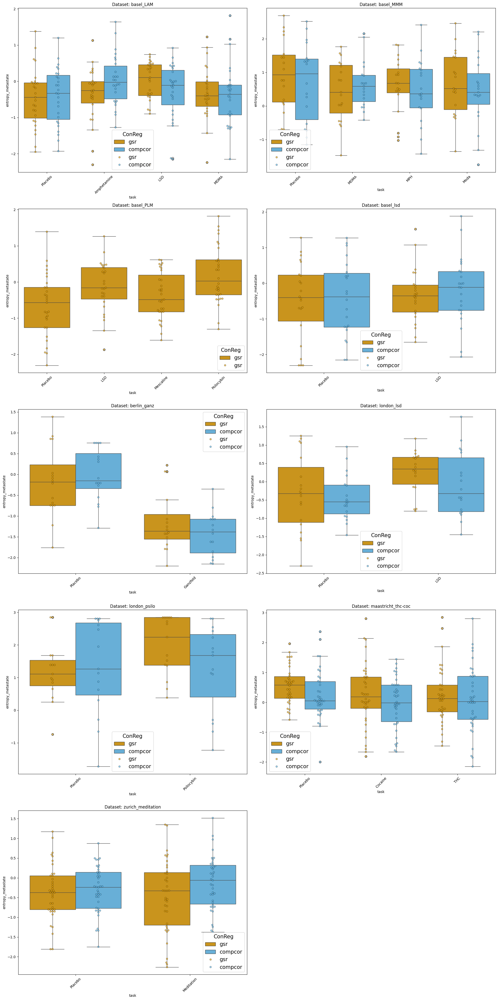

In [173]:
# more boxplots of more datasets

def create_combined_subplots(df):
    # Only keep datasets that actually have entropy values
    datasets = [
        d for d in df['dataset'].unique()
        if not df[df['dataset']==d]['entropy_metastate'].dropna().empty
    ]
    cols = 2
    rows = int(np.ceil(len(datasets)/cols))

    fig, axes = plt.subplots(rows, cols, figsize=(cols*10, rows*8))
    axes = axes.flatten()

    # Define contrasting colors for 'gsr' and 'compcor'
    palette = ['#E69F00', '#56B4E9']

    for i, dataset in enumerate(datasets):
        ax = axes[i]
        sub = df[df['dataset']==dataset].dropna(subset=['entropy_metastate'])

        tasks = ['Placebo'] + sorted(t for t in sub['task'].unique() if t!='Placebo')
        sub['task'] = pd.Categorical(sub['task'], categories=tasks, ordered=True)



        # inside your loop, replace the if/else entirely with:

        sns.boxplot(
            data=sub, x='task', y='entropy_metastate',
            hue='conreg', palette=palette, ax=ax, dodge=True
        )
        sns.swarmplot(
            data=sub, x='task', y='entropy_metastate',
            hue='conreg', palette=palette, dodge=True,
            edgecolor='black', linewidth=0.6, alpha=0.6, ax=ax
        )

        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[:len(labels)], labels[:len(labels)], title='ConReg', fontsize=15, title_fontsize=15)

        ax.set_title(f"Dataset: {dataset}")
        ax.tick_params(axis='x', rotation=45)

    for ax in axes[len(datasets):]:
        fig.delaxes(ax)

    plt.tight_layout()
    return fig

fig_combined = create_combined_subplots(df_winsorized_scaled)
plt.show()

### Normality checks

In [149]:
##### TEST NORMALITY ######

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pingouin as pg
from scipy import stats
from statsmodels.stats.multitest import fdrcorrection

def test_normality_for_metastate(df):
    """
    Test the normality of the differences in the 'entropy_metastate' measure
    (task - placebo) for each non-placebo task and confound regression method.
    Returns a DataFrame with raw and FDR corrected p-values for the Shapiro–Wilk test.
    """
    # Filter out rows where unique_subject starts with 'berlin_fls-ganz'
    df = df[~df['unique_subject'].str.startswith("berlin_fls-ganz")]
    normality_results = []
    
    for conreg in ['gsr', 'compcor']:
        df_conreg = df[df['conreg'] == conreg]
        # Select placebo data (using case-insensitive match)
        df_placebo = df_conreg[df_conreg['task'].str.lower() == 'placebo']
        for task in df_conreg['task'].unique():
            if task.lower() != 'placebo':
                df_task = df_conreg[df_conreg['task'] == task]
                # Merge data on unique_subject for within-subject pairing
                merged = pd.merge(df_placebo, df_task, on='unique_subject', 
                                  suffixes=('_placebo', '_task'))
                

                # Remove any pairs where either entropy is missing
                merged = merged.dropna(subset=['entropy_metastate_placebo', 'entropy_metastate_task'])

                n = len(merged)
                if n >= 3:  # Only test if there are at least 3 paired subjects
                    # Calculate the differences (task minus placebo)
                    differences = merged['entropy_metastate_task'] - merged['entropy_metastate_placebo']
                    shapiro_stat, shapiro_p = stats.shapiro(differences)
                    normality_results.append({
                        'ConReg': conreg,
                        'Task': task,
                        'n': n,
                        'Shapiro p-value (raw)': shapiro_p
                    })
    
    normality_df = pd.DataFrame(normality_results)

    # Apply FDR correction to p-values
    if not normality_df.empty:
        normality_df['Shapiro p-value (FDR)'] = np.nan
        mask = normality_df['Shapiro p-value (raw)'].notna()
        _, corrected = fdrcorrection(normality_df.loc[mask, 'Shapiro p-value (raw)'])
        normality_df.loc[mask, 'Shapiro p-value (FDR)'] = corrected

    return normality_df


normality_results = test_normality_for_metastate(df_winsorized_scaled)
print("Normality Test Results (Shapiro–Wilk):")
print(normality_results.to_string(index=False))

Normality Test Results (Shapiro–Wilk):
 ConReg        Task  n  Shapiro p-value (raw)  Shapiro p-value (FDR)
    gsr Amphetamine 26               0.640850               0.791638
    gsr         LSD 93               0.449960               0.791638
    gsr        MDMA 44               0.403047               0.791638
    gsr         MPH 18               0.200623               0.791638
    gsr        Moda 18               0.242359               0.791638
    gsr   Mescaline 29               0.929370               0.929370
    gsr  Psilocybin 43               0.445009               0.791638
    gsr    Ganzfeld 16               0.821148               0.907585
    gsr     Cocaine 38               0.604015               0.791638
    gsr         THC 38               0.184203               0.791638
    gsr  Meditation 39               0.164068               0.791638
compcor Amphetamine 26               0.364946               0.791638
compcor         LSD 66               0.297203               0.79

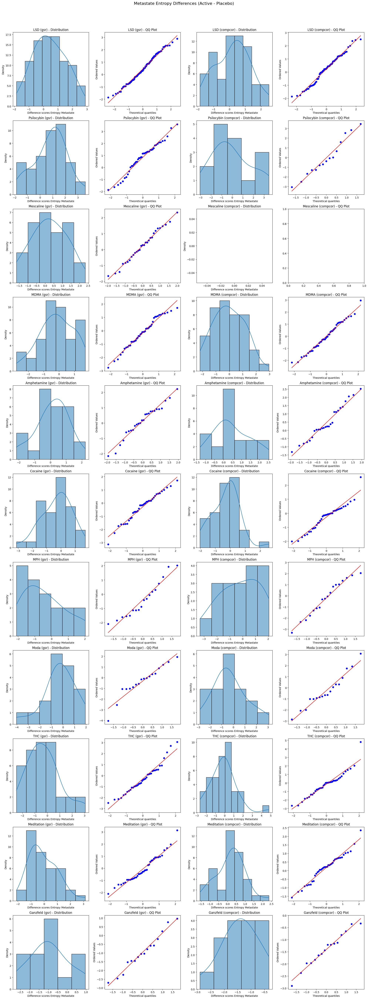

In [150]:
#### VISUAL NORMALITY CHECK METASTATE ####


def plot_differences_metastate(df, tasks, confregs):
    """
    Plot the differences in entropy metastate between active conditions and placebo
    for specified tasks and confound regression methods.
    
    Parameters:
    -----------
    df : pandas DataFrame
        DataFrame containing the data with columns 'conreg', 'task', 'unique_subject', 'entropy_metastate'
    tasks : list
        List of task names to compare with placebo
    confregs : list
        List of confound regression methods to analyze
    """
    import matplotlib.pyplot as plt
    import seaborn as sns
    from scipy import stats
    import pandas as pd
    
    # loop over tasks and confounds
    for task in tasks:
        for confreg in confregs:

            # filter data for conreg
            df_conf = df[df['conreg'] == confreg]

            # get placebo and active data
            df_placebo = df_conf[df_conf['task'] == 'Placebo']
            df_active = df_conf[df_conf['task'] == task]

            # Pair data
            placebo_data = df_placebo[['unique_subject', 'entropy_metastate']]
            active_data = df_active[['unique_subject', 'entropy_metastate']]

            # Merge to get only subjects with both conditions
            merged = pd.merge(placebo_data, active_data, on='unique_subject', suffixes=('_placebo', '_active'))

            # compute difference (active - placebo)
            merged['difference'] = merged['entropy_metastate_active'] - merged['entropy_metastate_placebo']

            # store valid data
            valid_data = merged['difference'].dropna()

    # Set up the figure grid outside of the loops
    n_tasks = len(tasks)
    n_confregs = len(confregs)
    n_plot_pairs = n_tasks * n_confregs  # Each task-confreg combo needs 2 plots (histogram + QQ)
    
    # Calculate rows and columns for the grid
    # Each row will have 4 plots (2 task-confreg pairs, each with hist and QQ)
    n_cols = 4
    n_rows = (n_plot_pairs + (n_cols // 2) - 1) // (n_cols // 2)  # Ceiling division for pairs
    
    # Create a grid of subplots
    fig = plt.figure(figsize=(20, 5 * n_rows))
    
    # Create dictionaries to store axes for histograms and QQ plots
    hist_axes = {}
    qq_axes = {}
    
    # First, create all the subplots
    for i, task in enumerate(tasks):
        for j, confreg in enumerate(confregs):
            # Calculate position in the grid
            # Each task-confreg pair takes 2 grid positions side by side
            pair_idx = i * len(confregs) + j
            row = pair_idx // (n_cols // 2)
            base_col = (pair_idx % (n_cols // 2)) * 2
            
            # Create histogram subplot
            hist_axes[(task, confreg)] = plt.subplot2grid((n_rows, n_cols), (row, base_col))
            
            # Create QQ plot subplot
            qq_axes[(task, confreg)] = plt.subplot2grid((n_rows, n_cols), (row, base_col + 1))
    
    # Now process the data and plot
    for task in tasks:
        for confreg in confregs:
            # filter data for conreg
            df_conf = df[df['conreg'] == confreg]

            # get placebo and active data
            df_placebo = df_conf[df_conf['task'] == 'Placebo']
            df_active = df_conf[df_conf['task'] == task]

            # Pair data
            placebo_data = df_placebo[['unique_subject', 'entropy_metastate']]
            active_data = df_active[['unique_subject', 'entropy_metastate']]

            # Merge to get only subjects with both conditions
            merged = pd.merge(placebo_data, active_data, on='unique_subject', suffixes=('_placebo', '_active'))

            # compute difference (active - placebo)
            merged['difference'] = merged['entropy_metastate_active'] - merged['entropy_metastate_placebo']

            # store valid data
            valid_data = merged['difference'].dropna()
            
            # Get the appropriate axes
            ax_hist = hist_axes[(task, confreg)]
            ax_qq = qq_axes[(task, confreg)]
            
            # plot histogram with density
            sns.histplot(valid_data, kde=True, ax=ax_hist)
            ax_hist.set_title(f'{task} ({confreg}) - Distribution')
            ax_hist.set_xlabel('Difference scores Entropy Metastate')
            ax_hist.set_ylabel('Density')
            
            # plot QQ plot
            stats.probplot(valid_data, dist='norm', plot=ax_qq)
            ax_qq.set_title(f'{task} ({confreg}) - QQ Plot')
    
    # Add an overall title
    fig.suptitle('Metastate Entropy Differences (Active - Placebo)', fontsize=16)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)  # Make room for the suptitle
    plt.show()

            
# define tasks and confounds to plot
tasks_to_plot_ms = ['LSD', 'Psilocybin', 'Mescaline', 'MDMA', 'Amphetamine', 'Cocaine', 'MPH', 'Moda', 'THC', 'Meditation', 'Ganzfeld']
confregs = ['gsr', 'compcor']
plot_differences_metastate(df_winsorized_scaled, tasks_to_plot_ms, confregs)

### Testing Metastate LZ Complexity (parametric, dependent samples t-test)

In [ ]:
#### script to test metastate with paired t-test and cohen's d ####

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pingouin as pg
from scipy import stats
from statsmodels.stats.multitest import fdrcorrection

def analyze_metastate_across_datasets(df):
    """
    Analyze the metastate measure comparing induction vs. placebo across all datasets.
    Each subject is paired (using the unique_subject identifier), and a paired t-test is used.
    """

     # Filter out any rows where unique_subject starts with 'berlin_fls-ganz'
    df = df[~df['unique_subject'].str.startswith("berlin_fls-ganz")]

    def perform_test(metric_active, metric_placebo):
        # Always use the paired t-test
        statistic, p_value = stats.ttest_rel(metric_active, metric_placebo)
        test_type = "Paired t-test"
        return test_type, statistic, p_value

    def categorize_effect_size(d):
        if abs(d) < 0.2: 
            return "Negligible"
        elif abs(d) < 0.5: 
            return "Small"
        elif abs(d) < 0.8: 
            return "Medium"
        else: 
            return "Large"

    results = []
    
    # Process each confound regression method separately
    for conreg in ['gsr', 'compcor']:
        df_conreg = df[df['conreg'] == conreg]
        
        # Get all placebo data for this confound method
        df_placebo = df_conreg[df_conreg['task'] == 'Placebo']
        
        # Compare each non-placebo task (induction condition) to placebo
        for task in df_conreg['task'].unique():
            if task.lower() != 'placebo':
                df_task = df_conreg[df_conreg['task'] == task]
                
                # Merge placebo and task data on unique_subject to achieve a within-subject pairing
                merged = pd.merge(df_placebo, df_task, 
                                  on='unique_subject',
                                  suffixes=('_placebo', '_task'))
                # merge the two data frames based on unique subject

                # Only drop pairs missing either placebo or task data
                merged = merged.dropna(subset=['entropy_metastate_placebo','entropy_metastate_task'])
                
                if len(merged) >= 3:  # Require at least 3 paired subjects
                    # Here, we assume the metastate measure is in a column named "metastate_value"
                    # after merging, they become "metastate_value_placebo" and "metastate_value_task"
                    metastate_placebo = merged['entropy_metastate_placebo']
                    metastate_task = merged['entropy_metastate_task']
                    
                    # Perform the paired test (always a paired t-test in this function)
                    test_type, statistic, p_value = perform_test(metastate_task, metastate_placebo)
                    
                    # Compute Cohen's d (paired)
                    cohen_d = pg.compute_effsize(metastate_task, metastate_placebo, paired=True, eftype='cohen')
                    
                    # Estimate the standard error and compute 95% CI for Cohen's d.
                    # (This is a rough approximation; you may refine it as needed.)
                    n = len(metastate_placebo)
                    # Here, we approximate SE based on the correlation between the paired measures:
                    se = np.sqrt((2 * (1 - np.corrcoef(metastate_placebo, metastate_task)[0,1])) / n)
                    ci_lower = cohen_d - stats.t.ppf(0.975, df=n-1) * se
                    ci_upper = cohen_d + stats.t.ppf(0.975, df=n-1) * se
                    
                    results.append({
                        'ConReg': conreg,
                        'Task': task,
                        'Test': test_type,
                        't-value': statistic,
                        'Effect Size (Cohen d)': cohen_d,
                        'SE': se,
                        'CI Lower': ci_lower,
                        'CI Upper': ci_upper,
                        'p-value': p_value,
                        'n': n,
                        'Magnitude': categorize_effect_size(cohen_d)
                    })
    
    results_df = pd.DataFrame(results)
    
    # Apply FDR correction to all tests in the analysis
    _, corrected_p_values = fdrcorrection(results_df['p-value'])
    results_df['Corrected p-value'] = corrected_p_values
    

        # Add APA-style rounded stats column
    def format_p(p):
        return "< .001" if p < 0.001 else f"= {p:.3f}".replace("0.", ".")
    
    results_df['APA Style'] = results_df.apply(
        lambda row: f"t({row['n'] - 1}) = {row['t-value']:.2f}, "
                    f"p {format_p(row['Corrected p-value'])}, "
                    f"d = {row['Effect Size (Cohen d)']:.2f}",
        axis=1
    )

    return results_df

# print full results
results_metastate = analyze_metastate_across_datasets(df_winsorized_scaled)
print(results_metastate.to_string(index=False))

# print significant results
significant_results = results_metastate[results_metastate['Corrected p-value'] < 0.05]
print(significant_results.to_string(index=False))

 ConReg        Task          Test   t-value  Effect Size (Cohen d)       SE  CI Lower  CI Upper      p-value  n  Magnitude  Corrected p-value                          APA Style
    gsr Amphetamine Paired t-test  0.635261               0.171369 0.269748 -0.384188  0.726925 5.310302e-01 26 Negligible           0.655978   t(25) = 0.64, p = .656, d = 0.17
    gsr         LSD Paired t-test  3.699810               0.511490 0.137924  0.237561  0.785419 3.670647e-04 93     Medium           0.002569   t(92) = 3.70, p = .003, d = 0.51
    gsr        MDMA Paired t-test -0.952072              -0.159019 0.164965 -0.491703  0.173665 3.463816e-01 44 Negligible           0.525209 t(43) = -0.95, p = .525, d = -0.16
    gsr         MPH Paired t-test -1.363651              -0.430775 0.315520 -1.096465  0.234915 1.904635e-01 18      Small           0.363612 t(17) = -1.36, p = .364, d = -0.43
    gsr        Moda Paired t-test -0.960762              -0.321225 0.334346 -1.026634  0.384183 3.501390e-01 18    

In [33]:
###V3 test final version

#### script to test metastate with paired t-test and cohen's d ####

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pingouin as pg
from scipy import stats
from statsmodels.stats.multitest import fdrcorrection

def analyze_metastate_across_datasets(df):
    """
    Analyze the metastate measure comparing induction vs. placebo across all datasets.
    Each subject is paired (using the unique_subject identifier), and a paired t-test is used.
    """

     # Filter out any rows where unique_subject starts with 'berlin_fls-ganz'
    df = df[~df['unique_subject'].str.startswith("berlin_fls-ganz")]

    def perform_test(metric_active, metric_placebo):
        # Always use the paired t-test
        statistic, p_value = stats.ttest_rel(metric_active, metric_placebo)
        test_type = "Paired t-test"
        return test_type, statistic, p_value

    def categorize_effect_size(d):
        if abs(d) < 0.2: 
            return "Negligible"
        elif abs(d) < 0.5: 
            return "Small"
        elif abs(d) < 0.8: 
            return "Medium"
        else: 
            return "Large"

    results = []
    
    # Process each confound regression method separately
    for conreg in ['gsr', 'compcor']:
        df_conreg = df[df['conreg'] == conreg]
        
        # Get all placebo data for this confound method
        df_placebo = df_conreg[df_conreg['task'] == 'Placebo']
        
        # Compare each non-placebo task (induction condition) to placebo
        for task in df_conreg['task'].unique():
            if task.lower() != 'placebo':
                df_task = df_conreg[df_conreg['task'] == task]
                
                # Merge placebo and task data on unique_subject to achieve a within-subject pairing
                merged = pd.merge(df_placebo, df_task, 
                                  on='unique_subject',
                                  suffixes=('_placebo', '_task'))
                # merge the two data frames based on unique subject

                # Only drop pairs missing either placebo or task data
                merged = merged.dropna(subset=['entropy_metastate_placebo','entropy_metastate_task'])
                
                if len(merged) >= 3:  # Require at least 3 paired subjects
                    # Here, we assume the metastate measure is in a column named "metastate_value"
                    # after merging, they become "metastate_value_placebo" and "metastate_value_task"
                    metastate_placebo = merged['entropy_metastate_placebo']
                    metastate_task = merged['entropy_metastate_task']
                    
                    # Perform the paired test (always a paired t-test in this function)
                    test_type, statistic, p_value = perform_test(metastate_task, metastate_placebo)
                    
                    # Compute Cohen's d (paired)
                    cohen_d = pg.compute_effsize(metastate_task, metastate_placebo, paired=True, eftype='cohen')
                    
                    # Estimate the standard error and compute 95% CI for Cohen's d.
                    # (This is a rough approximation; you may refine it as needed.)
                    n = len(metastate_placebo)
                    # Here, we approximate SE based on the correlation between the paired measures:
                    se = np.sqrt((2 * (1 - np.corrcoef(metastate_placebo, metastate_task)[0,1])) / n)
                    ci_lower = cohen_d - stats.t.ppf(0.975, df=n-1) * se
                    ci_upper = cohen_d + stats.t.ppf(0.975, df=n-1) * se
                    
                    results.append({
                        'ConReg': conreg,
                        'Task': task,
                        'Test': test_type,
                        't-value': statistic,
                        'Effect Size (Cohen d)': cohen_d,
                        'SE': se,
                        'CI Lower': ci_lower,
                        'CI Upper': ci_upper,
                        'p-value': p_value,
                        'n': n,
                        'Magnitude': categorize_effect_size(cohen_d)
                    })
    
    results_df = pd.DataFrame(results)
    
    # Apply FDR correction to all tests in the analysis
    _, corrected_p_values = fdrcorrection(results_df['p-value'])
    results_df['Corrected p-value'] = corrected_p_values
    

        # Add APA-style rounded stats column
    def format_p(p):
        return "< .001" if p < 0.001 else f"= {p:.3f}".replace("0.", ".")
    
    results_df['APA Style'] = results_df.apply(
        lambda row: f"t({row['n'] - 1}) = {row['t-value']:.2f}, "
                    f"p {format_p(row['Corrected p-value'])}, "
                    f"d = {row['Effect Size (Cohen d)']:.2f}",
        axis=1
    )

    return results_df

# print full results
results_metastate = analyze_metastate_across_datasets(df_winsorized_scaled)
print(results_metastate.to_string(index=False))

# print significant results
significant_results = results_metastate[results_metastate['Corrected p-value'] < 0.05]
print(significant_results.to_string(index=False))

 ConReg        Task          Test   t-value  Effect Size (Cohen d)       SE  CI Lower  CI Upper      p-value  n  Magnitude  Corrected p-value                          APA Style
    gsr Amphetamine Paired t-test  0.635261               0.171369 0.269748 -0.384188  0.726925 5.310302e-01 26 Negligible           0.655978   t(25) = 0.64, p = .656, d = 0.17
    gsr         LSD Paired t-test  3.699810               0.511490 0.137924  0.237561  0.785419 3.670647e-04 93     Medium           0.002569   t(92) = 3.70, p = .003, d = 0.51
    gsr        MDMA Paired t-test -0.952072              -0.159019 0.164965 -0.491703  0.173665 3.463816e-01 44 Negligible           0.525209 t(43) = -0.95, p = .525, d = -0.16
    gsr         MPH Paired t-test -1.363651              -0.430775 0.315520 -1.096465  0.234915 1.904635e-01 18      Small           0.363612 t(17) = -1.36, p = .364, d = -0.43
    gsr        Moda Paired t-test -0.960762              -0.321225 0.334346 -1.026634  0.384183 3.501390e-01 18    

In [152]:
def apa_style_formatting(results_df):
    """
    Formats results into clean APA-style values without labels in the cells.
    Puts degrees of freedom in a separate column and saves to Excel.
    """

    # Custom task order
    task_order = [
        "LSD", "Psilocybin", "Mescaline",
        "Cocaine", "Amphetamine", "MPH",
        "Moda", "MDMA", "THC",
        "Meditation", "Ganzfeld"
    ]

    def fmt(val, decimals=2):
        return f"{val:.{decimals}f}"

    def fmt_p(p):
        return "< .001" if p < 0.001 else f"{p:.3f}".lstrip("0")

    df = results_df.copy()

    # Add separate degrees of freedom column
    df["df"] = df["n"].apply(lambda n: int(n) - 1)

    # Clean all values (no labels in cells)
    df["t-value"] = df["t-value"].apply(fmt)
    df["p-value"] = df["p-value"].apply(fmt_p)
    df["Corrected p-value"] = df["Corrected p-value"].apply(fmt_p)
    df["Effect Size (Cohen d)"] = df["Effect Size (Cohen d)"].apply(fmt)
    df["SE"] = df["SE"].apply(fmt)
    df["CI Lower"] = df["CI Lower"].apply(fmt)
    df["CI Upper"] = df["CI Upper"].apply(fmt)
    df["n"] = df["n"].apply(str)

    # Merge CI
    df["CI"] = "[" + df["CI Lower"] + ", " + df["CI Upper"] + "]"
    df.drop(columns=["CI Lower", "CI Upper"], inplace=True)

    # Set task order and sort
    df["Task"] = pd.Categorical(df["Task"], categories=task_order, ordered=True)
    df = df.sort_values(["Task", "ConReg"])

    # Final column order
    df = df[[
        "Task", "ConReg", "t-value", "df", "p-value", "Corrected p-value",
        "Effect Size (Cohen d)", "SE", "CI", "n"
    ]]

    # Save to Excel
    output_file = "metastate_apa_full_table.xlsx"
    with pd.ExcelWriter(output_file, engine="xlsxwriter") as writer:
        df.to_excel(writer, index=False, sheet_name="APA Table")

    print(f"APA-style table saved to '{output_file}'")

    return df

apa_style_formatting(results_metastate)

APA-style table saved to 'metastate_apa_full_table.xlsx'


,Task,ConReg,t-value,df,p-value,Corrected p-value,Effect Size (Cohen d),SE,CI,n
12,LSD,compcor,1.60,65,.115,.301,0.25,0.16,"[-0.06, 0.57]",66
1,LSD,gsr,3.70,92,< .001,.003,0.51,0.14,"[0.24, 0.79]",93
16,Psilocybin,compcor,-0.09,14,.929,.933,-0.03,0.36,"[-0.80, 0.74]",15
6,Psilocybin,gsr,4.22,42,< .001,.001,0.68,0.16,"[0.35, 1.00]",43
5,Mescaline,gsr,1.22,28,.232,.406,0.31,0.25,"[-0.21, 0.82]",29
18,Cocaine,compcor,-1.91,37,.064,.223,-0.34,0.18,"[-0.70, 0.02]",38
8,Cocaine,gsr,-1.73,37,.091,.274,-0.33,0.19,"[-0.71, 0.05]",38
11,Amphetamine,compcor,2.27,25,.032,.134,0.61,0.27,"[0.06, 1.17]",26
0,Amphetamine,gsr,0.64,25,.531,.656,0.17,0.27,"[-0.38, 0.73]",26
14,MPH,compcor,-0.56,17,.584,.682,-0.19,0.35,"[-0.93, 0.54]",18


In [ ]:
def create_forest_plot(results_df):
    """
    Create forest plot with the same aesthetics as original.
    """
    # Define task order and colors
    task_order = [
        'Meditation','Ganzfeld',  # Non-pharmacological
        'Amphetamine', 'Cocaine', 'THC', 'MPH', 'Moda', 'MDMA',  # Other pharmacological
        'Mescaline', 'Psilocybin', 'LSD'  # Classic psychedelics
    ]
    
    colors = {'gsr': '#E69F00', 'compcor': '#56B4E9'}
    
    # Create plot
    plt.figure(figsize=(12, 10), dpi=600)
    ax.set_facecolor('white')
    #ax = plt.gca()
    
    # Create task positions
    task_positions = {task: i for i, task in enumerate(task_order)}
    
    # Plot data for each preprocessing method
    for conreg_method in ['compcor', 'gsr']:
        method_data = results_df[results_df['ConReg'] == conreg_method].copy()
        
        if not method_data.empty:
            method_data['task_position'] = method_data['Task'].map(task_positions)
            method_data = method_data.sort_values('task_position')
            
            y_positions = method_data['task_position']
            x_values = method_data['Effect Size (Cohen d)']  # Define x_values here
            
            # Plot error bars

            # Calculate asymmetric error bars using CI instead of SE
            lower_err = x_values - method_data['CI Lower']
            upper_err = method_data['CI Upper'] - x_values
            
            # Combine into array for asymmetric error bars
            x_errs = np.array([lower_err, upper_err])
            
            # Plot error bars with CI
            ax.errorbar(
                method_data['Effect Size (Cohen d)'],
                y_positions,
                xerr=x_errs,  # Using CI-based errors instead of SE
                fmt='o',
                capsize=6,
                capthick=1,
                elinewidth=1,
                color=colors[conreg_method],
                label=conreg_method,
                alpha=0.9,
                markersize=15,
                markeredgewidth=1
            )



            # # Add significance asterisks
            # for x, y, p in zip(x_values, y_positions, method_data['Corrected p-value']):
            #     if p <= 0.001:
            #         ax.text(x, y - 0.1, '***', va='bottom', ha='center',
            #                 color=colors[conreg_method], fontsize=12)
            #     elif p <= 0.01:
            #         ax.text(x, y - 0.1, '**', va='bottom', ha='center',
            #                 color=colors[conreg_method], fontsize=12)
            #     elif p <= 0.05:
            #         ax.text(x, y - 0.1, '*', va='bottom', ha='center',
            #                 color=colors[conreg_method], fontsize=12)
            
            # Add significance markers
            for x, y, p in zip(method_data['Effect Size (Cohen d)'],
                             y_positions,
                             method_data['Corrected p-value']):
                if p < 0.001: sig = '***'
                elif p < 0.01: sig = '**'
                elif p < 0.05: sig = '*'
                else: continue
                
                ax.text(x, y + 0.18, sig, color=colors[conreg_method],
                       va='center', fontsize=14)
                

                 
    
    # Customize plot
    ax.axhline(y=3.5, color='grey', linestyle='--', alpha=0.3)
    ax.axhline(y=9.5, color='grey', linestyle='--', alpha=0.3)
    ax.axvline(x=0, linestyle='--', color='grey')
    
    ax.set_yticks(range(len(task_order)))
    ax.set_yticklabels(task_order, fontsize=12)
    ax.set_xlabel("Cohen's d (Induction vs Placebo)", fontsize=14)
    ax.set_title("Cohen's d of Entropy_LZc Between Induction and Placebo\nAcross All Datasets",
                fontsize=16)
    
    # Add legend
    legend_elements = [
        plt.Line2D([], [], color=colors['compcor'], label='CompCor', marker='o'),
        plt.Line2D([], [], color=colors['gsr'], label='GSR', marker='o'),
        plt.Line2D([], [], color='none', label='* p < 0.05'),
        plt.Line2D([], [], color='none', label='** p < 0.01'),
        plt.Line2D([], [], color='none', label='*** p < 0.001')
    ]
    
    ax.legend(handles=legend_elements,
             title='Significance and Method',
             title_fontsize=12,
             fontsize=10,
             bbox_to_anchor=(1.05, 1))
    
    plt.xticks(rotation=45, fontsize=17)
    plt.yticks(rotation=45, fontsize=16)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.tight_layout()
    
    return ax

In [127]:
def create_forest_plot(results_df):
    """
    Create a clean APA style plot, minimal theme, 
    """
    # Define task order and colors
    task_order = [
        'Meditation','Ganzfeld',  # Non-pharmacological
        'Amphetamine', 'Cocaine', 'THC', 'MPH', 'Moda', 'MDMA',  # Other pharmacological
        'Mescaline', 'Psilocybin', 'LSD'  # Classic psychedelics
    ]
    colors = {'gsr': '#E69F00', 'compcor': '#56B4E9'}

    # Create figure and axis with white background
    fig, ax = plt.subplots(figsize=(12, 10), dpi=600)
    ax.set_facecolor('white')
    
    # Map tasks to y-positions
    task_positions = {task: i for i, task in enumerate(task_order)}

    # Plot data for each preprocessing method
    for conreg_method in ['compcor', 'gsr']:
        method_data = results_df[results_df['ConReg'] == conreg_method].copy()
        if not method_data.empty:
            method_data['task_position'] = method_data['Task'].map(task_positions)
            method_data = method_data.sort_values('task_position')
            
            y_positions = method_data['task_position']
            x_values = method_data['Effect Size (Cohen d)']
            
            # Calculate asymmetric error bars using CI instead of SE
            lower_err = x_values - method_data['CI Lower']
            upper_err = method_data['CI Upper'] - x_values
            x_errs = np.array([lower_err, upper_err])
            
            # Plot error bars with CI and markers
            ax.errorbar(
                x_values,
                y_positions,
                xerr=x_errs,
                fmt='o',
                capsize=6,
                capthick=1,
                elinewidth=1,
                color=colors[conreg_method],
                label=conreg_method.upper(),
                alpha=0.9,
                markersize=11,      # Slightly smaller marker for cleaner look
                markeredgewidth=1
            )
            
            # Add significance markers above the point
            for x, y, p in zip(x_values, y_positions, method_data['Corrected p-value']):
                if p < 0.001:
                    sig = '***'
                elif p < 0.01:
                    sig = '**'
                elif p < 0.05:
                    sig = '*'
                else:
                    continue
                ax.text(x, y + 0.10, sig,
                        color=colors[conreg_method],
                        va='bottom', ha='center', fontsize=14)
    
    # Add a vertical reference line at x=0
    ax.axvline(x=0, linestyle='--', color='grey', lw=1, alpha=0.7)
    
    # Set y-ticks and labels
    ax.set_yticks(range(len(task_order)))
    ax.set_yticklabels(task_order, fontsize=12)
    ax.set_xlabel("Cohen's d (Induction vs Placebo)", fontsize=14)
    ax.set_title("Metastate Entropy Differences per ASC Across All Datasets",
                 fontsize=16, pad=20)
    
    # Remove top and right spines for a cleaner look
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    
    # Optionally, remove gridlines
    ax.grid(False)
    
    # Simplified legend
    legend_elements = [
        plt.Line2D([], [], marker='o', color=colors['compcor'], linestyle='None',
                   markersize=4, label='CompCor'),
        plt.Line2D([], [], marker='o', color=colors['gsr'], linestyle='None',
                   markersize=4, label='GSR'),
        plt.Line2D([], [], linestyle='None', label='* p < 0.05'),
        plt.Line2D([], [], linestyle='None', label='** p < 0.01'),
        plt.Line2D([], [], linestyle='None', label='*** p < 0.001')
    ]
    ax.legend(handles=legend_elements,
              title='Significance & Method',
              title_fontsize=12,
              fontsize=10,
              loc='upper right',
              frameon=False)
    
    plt.tight_layout()
    return ax


In [ ]:
import matplotlib.pyplot as plt
import numpy as np


def create_forest_plot(results_df):
    task_order = [
        'Meditation','Ganzfeld',
        'THC','MDMA','Moda','MPH','Amphetamine','Cocaine',
        'Mescaline','Psilocybin','LSD'
    ]
    colors = {'compcor': '#56B4E9','gsr': '#E69F00'}

    fig, ax = plt.subplots(figsize=(8, 5), dpi=600)
    ax.set_facecolor('white')

    pos = {task: i for i, task in enumerate(task_order)}

    for method in ['compcor','gsr']:
        df = results_df[results_df['ConReg']==method].copy()
        df['pos'] = df['Task'].map(pos)
        df.sort_values('pos', inplace=True)

        x = df['Effect Size (Cohen d)']
        y = df['pos']
        errs = np.vstack([x - df['CI Lower'], df['CI Upper'] - x])

        ax.errorbar(
            x, y, xerr=errs, fmt='o', capsize=4, elinewidth=1,
            markeredgewidth=1, markersize=6, color=colors[method], alpha=0.6, label='CompCor' if method == 'compcor' else 'GSR'
        )

        for xi, yi, p in zip(x, y, df['Corrected p-value']):
            if p < .05:
                sig = '***' if p < .001 else '**' if p < .01 else '*'
                ax.text(xi, yi + 0.2, sig, ha='center', va='bottom', fontsize=10, color=colors[method])

    ax.axvline(0, linestyle='--', color='grey', linewidth=1)
    ax.set_yticks(list(pos.values()))
    ax.set_yticklabels(task_order, fontsize=10)
    ax.set_xlabel("Cohen's d (ASC vs Placebo)", fontsize=10)
    ax.set_title("Metastate Entropy Differences per ASC Across All Datasets", fontsize=12, pad=12)

    ax.grid(axis='x', linestyle='--', alpha=0.5)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    legend = ax.legend(
        loc='upper left', bbox_to_anchor=(1.02, 1),
        frameon=False, title="Method", fontsize=9, title_fontsize=10
    )

    plt.tight_layout(pad=0.5)
    return ax

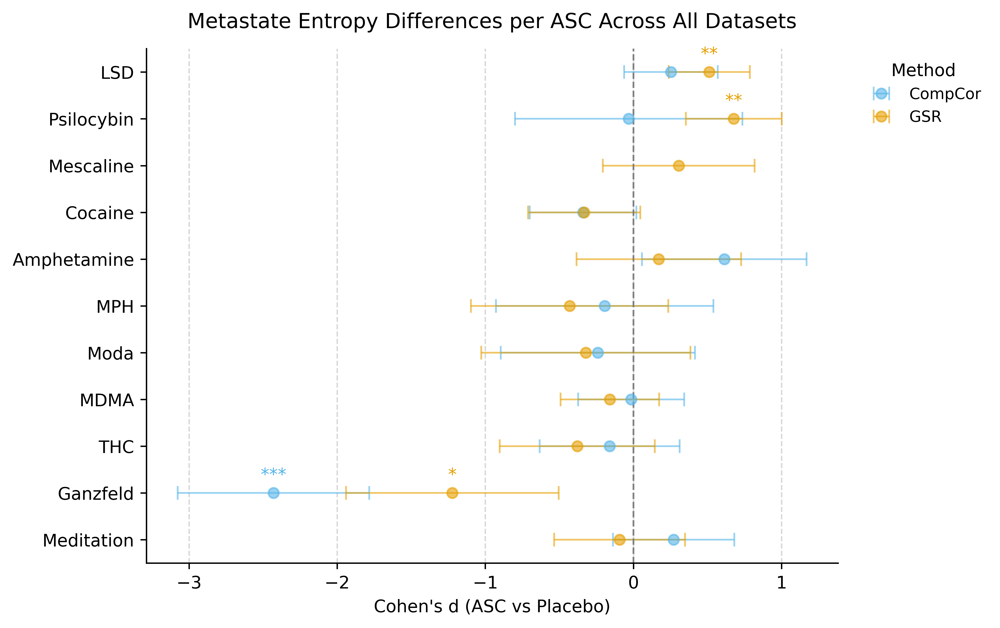

In [161]:
forest_plot = create_forest_plot(results_metastate)

plt.show()

In [36]:
import matplotlib as mpl

def create_forest_plot_v2(results_df):

    plt.rcParams['font.family'] = 'Times New Roman'
    plt.rcParams['font.size'] = 11

    task_order = [
        'Meditation','Ganzfeld',
        'THC','MDMA','Moda','MPH','Amphetamine','Cocaine',
        'Mescaline','Psilocybin','LSD'
    ]
    colors = {'compcor': '#56B4E9','gsr': '#E69F00'}
    fig, ax = plt.subplots(figsize=(8, 5), dpi=600)
    ax.set_facecolor('white')
    pos = {task: i for i, task in enumerate(task_order)}
    for method in ['compcor','gsr']:
        df = results_df[results_df['ConReg']==method].copy()
        df['pos'] = df['Task'].map(pos)
        df.sort_values('pos', inplace=True)
        x = df['Effect Size (Cohen d)']
        y = df['pos']
        errs = np.vstack([x - df['CI Lower'], df['CI Upper'] - x])
        ax.errorbar(
            x, y, xerr=errs, fmt='o', capsize=4, elinewidth=1,
            markeredgewidth=1, markersize=6, color=colors[method], alpha=0.6, label='CompCor' if method == 'compcor' else 'GSR'
        )
        for xi, yi, p in zip(x, y, df['Corrected p-value']):
            if p < .05:
                sig = '***' if p < .001 else '**' if p < .01 else '*'
                ax.text(xi, yi + 0.2, sig, ha='center', va='bottom', fontsize=10, color=colors[method])
    ax.axvline(0, linestyle='--', color='grey', linewidth=1)
    ax.set_yticks(list(pos.values()))
    ax.set_yticklabels(task_order, fontsize=10)
    ax.set_xlabel("Cohen's d (ASC vs Placebo)", fontsize=10)
    ax.set_title("Metastate LZ Complexity Differences per ASC Across All Datasets", fontsize=12, pad=12)
    ax.grid(axis='x', linestyle='--', alpha=0.5)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    
    # Get the original legend
    legend = ax.legend(
        loc='upper left', bbox_to_anchor=(1.02, 1),
        frameon=False, title="Method", fontsize=9, title_fontsize=10
    )
    ax.add_artist(legend)
    
    # Add a second legend for significance with proper spacing
    from matplotlib.lines import Line2D
    
    # Empty line elements with just the labels
    sig_elements = [
        Line2D([0], [0], marker='', linestyle='none', label='* p < .05'),
        Line2D([0], [0], marker='', linestyle='none', label='** p < .01'),
        Line2D([0], [0], marker='', linestyle='none', label='*** p < .001')
    ]
    
    # Add the significance legend
    sig_legend = ax.legend(
        handles=sig_elements,
        loc='upper left', 
        bbox_to_anchor=(1.02, 0.80),  # Positioned below method legend
        frameon=False, 
        title="Significance", 
        fontsize=9, 
        title_fontsize=10,
        handlelength=0  # Make the handles invisible
    )
    
    # Adjust spacing
    plt.tight_layout()
    plt.subplots_adjust(right=0.82)  # Leave room for the legends
    
    return ax

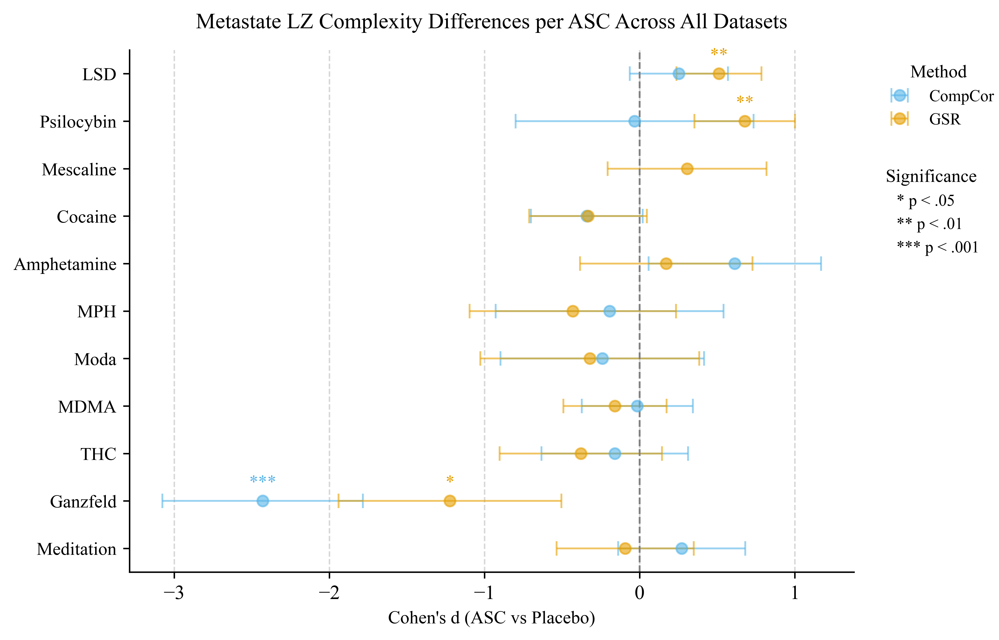

In [37]:
forest_plot_v2 = create_forest_plot_v2(results_metastate)

plt.show()

## DCC

### Distributions and normality check

In [104]:
# Network mapping
network_mapping = {
    'Vis': 1,
    'SomMot': 2, 
    'DorsAttn': 3,
    'SalVentAttn': 4,
    'Limbic': 5,
    'Cont': 6,
    'Default': 7
}

# Reverse mapping for labels
network_labels = {v: k for k, v in network_mapping.items()}

In [156]:
### TEST NORMALITY ###

import pandas as pd
import numpy as np
from scipy import stats

def test_dcc_normality_per_column(df, entropy_cols, task, confound_reg):
    """
    For a given substance (task) and a confound regression method,
    test the normality (using the Shapiro–Wilk test) of the within‐subject differences 
    for each DCC (entropy) column. The differences are computed as:
         difference = (active value) - (placebo value)
    Only subjects with valid data (non-NaN) in both conditions for that column are used.
    
    Parameters:
      df: DataFrame with the full data.
      entropy_cols: list of columns to be tested (e.g. ["dcc_entropy_1_2", "dcc_entropy_1_3", ...])
      task: string (active condition name; e.g., "LSD", "Amphetamine", etc.) – not "Placebo"
      confound_reg: string, e.g. 'gsr' or 'compcor'
      
    Returns:
      A DataFrame with one row per DCC column including:
        - network1, network2 (extracted from the column name)
        - n_used: number of paired subjects
        - p_normality: p-value from the Shapiro–Wilk test on the differences
    """
    # Filter data for the given confound method.
    df_conreg = df[df['conreg'] == confound_reg]
    
    # Get placebo and task data separately.
    df_placebo = df_conreg[df_conreg['task'] == 'Placebo']
    df_task    = df_conreg[df_conreg['task'] == task]
    
    results = []
    for col in entropy_cols:
        # Select only unique_subject and the current DCC column.
        placebo_sub = df_placebo[['unique_subject', col]].dropna()
        task_sub    = df_task[['unique_subject', col]].dropna()
        
        # Merge on unique_subject so that only subjects with valid data in both conditions are used.
        merged = pd.merge(placebo_sub, task_sub, on='unique_subject', suffixes=('_placebo', '_task'))
        n_used = merged.shape[0]
        if n_used < 3:
            # Skip if too few paired subjects.
            continue
        
        # Compute the paired differences.
        diff = merged[col + '_task'] - merged[col + '_placebo']
        
        # Perform the Shapiro–Wilk test on the differences.
        shapiro_result = stats.shapiro(diff)
        p_normality = shapiro_result.pvalue
        
        # Extract network numbers from the column name (expecting "dcc_entropy_<net1>_<net2>")
        try:
            net1, net2 = map(int, col.split('_')[2:])
        except Exception:
            net1, net2 = None, None
        
        results.append({
            'network1': net1,
            'network2': net2,
            'n_used': n_used,
            'p_normality': p_normality
        })
        
    return pd.DataFrame(results)

# function to loop over all substances and confound methods.
def test_dcc_normality_across_substances(df, entropy_cols):
    """
    For each substance (task, excluding Placebo) and for each confound regression method,
    test normality of the within-subject differences for each DCC column.
    
    Returns:
      A nested dictionary with keys: results_by_substance[task][confound] = DataFrame of normality results.
    """
    tasks = [t for t in df['task'].unique() if t.lower() != 'placebo']
    confound_techniques = ['gsr', 'compcor']
    results_by_substance = {}
    
    for task in tasks:
        results_by_substance[task] = {}
        for conf in confound_techniques:
            norm_df = test_dcc_normality_per_column(df, entropy_cols, task, conf)
            results_by_substance[task][conf] = norm_df
            print(f"ASC {task} with confound {conf}: {norm_df.shape[0]} tests performed.")
    return results_by_substance

# Example usage:
# Define your entropy columns for the DCC metric (assuming they follow the pattern "dcc_entropy_...")
entropy_cols = [col for col in df_winsorized_scaled.columns if col.startswith('dcc_entropy_')]

# Run the normality tests across all substances and confound methods.
normality_results = test_dcc_normality_across_substances(df_winsorized_scaled, entropy_cols)


for substance in normality_results:
    for conf in normality_results[substance]:
        print(f"ASC: {substance}, conreg: {conf}")
        print(normality_results[substance][conf].to_string(index=False))
        print("\n")


ASC Amphetamine with confound gsr: 29 tests performed.
ASC Amphetamine with confound compcor: 29 tests performed.
ASC LSD with confound gsr: 29 tests performed.
ASC LSD with confound compcor: 29 tests performed.
ASC MDMA with confound gsr: 29 tests performed.
ASC MDMA with confound compcor: 29 tests performed.
ASC MPH with confound gsr: 29 tests performed.
ASC MPH with confound compcor: 29 tests performed.
ASC Moda with confound gsr: 29 tests performed.
ASC Moda with confound compcor: 29 tests performed.
ASC Mescaline with confound gsr: 29 tests performed.
ASC Mescaline with confound compcor: 29 tests performed.
ASC Psilocybin with confound gsr: 29 tests performed.
ASC Psilocybin with confound compcor: 29 tests performed.
ASC FLS(10Hz) with confound gsr: 29 tests performed.
ASC FLS(10Hz) with confound compcor: 29 tests performed.
ASC FLS(3Hz) with confound gsr: 29 tests performed.
ASC FLS(3Hz) with confound compcor: 29 tests performed.
ASC Ganzfeld with confound gsr: 29 tests performed

In [157]:
from statsmodels.stats.multitest import multipletests
import numpy as np

def summarize_normality_by_substance(normality_results, raw_alpha=0.05, fdr_alpha=0.05):
    """
    Given a nested dictionary normality_results with structure:
       normality_results[substance][confound] = DataFrame
    where each DataFrame has a column 'p_normality' (the Shapiro–Wilk p-value for each network-to-network connection),
    this function:
      - Counts how many tests have raw p-values <= raw_alpha.
      - Applies FDR correction (Benjamini–Hochberg) across all tests for that substance (family) for each confound,
        and counts how many tests have FDR-corrected p-values <= fdr_alpha.
      
    Returns:
      A nested dictionary such that:
         summary[substance][confound] = {
             'total_tests': int,
             'raw_sig': int,
             'percent_raw': float,
             'fdr_sig': int,
             'percent_fdr': float
         }
    """
    summary = {}
    for substance, conf_data in normality_results.items():
        summary[substance] = {}
        for conf, df in conf_data.items():
            if df.empty or 'p_normality' not in df.columns:
                summary[substance][conf] = {
                    'total_tests': 0,
                    'raw_sig': 0,
                    'percent_raw': 0.0,
                    'fdr_sig': 0,
                    'percent_fdr': 0.0
                }
                continue
            total = df.shape[0]
            # Count significant raw p-values
            raw_sig = (df['p_normality'] <= raw_alpha).sum()
            
            # Apply FDR correction on the raw p-values
            raw_pvals = df['p_normality'].tolist()
            _, pvals_fdr, _, _ = multipletests(raw_pvals, method='fdr_bh')
            fdr_sig = np.sum(np.array(pvals_fdr) <= fdr_alpha)
            
            summary[substance][conf] = {
                'total_tests': total,
                'raw_sig': int(raw_sig),
                'percent_raw': raw_sig / total * 100,
                'fdr_sig': int(fdr_sig),
                'percent_fdr': fdr_sig / total * 100
            }
    return summary

# Example usage:
# Assume you have already computed normality_results, for example:
# normality_results = test_dcc_normality_across_substances(df, entropy_cols)
# (where normality_results[substance][confound] is a DataFrame with a 'p_normality' column)

normality_summary = summarize_normality_by_substance(normality_results, raw_alpha=0.05, fdr_alpha=0.05)

# Now print an overview:
for substance, conf_dict in normality_summary.items():
    print(f"Substance: {substance}")
    for conf, stats_dict in conf_dict.items():
        print(f"  Confound: {conf}")
        print(f"    Total tests: {stats_dict['total_tests']}")
        print(f"    Raw significant tests (p <= 0.05): {stats_dict['raw_sig']} ({stats_dict['percent_raw']:.1f}%)")
        print(f"    FDR significant tests (p <= 0.05): {stats_dict['fdr_sig']} ({stats_dict['percent_fdr']:.1f}%)")
    print()


Substance: Amphetamine
  Confound: gsr
    Total tests: 29
    Raw significant tests (p <= 0.05): 21 (72.4%)
    FDR significant tests (p <= 0.05): 19 (65.5%)
  Confound: compcor
    Total tests: 29
    Raw significant tests (p <= 0.05): 6 (20.7%)
    FDR significant tests (p <= 0.05): 2 (6.9%)

Substance: LSD
  Confound: gsr
    Total tests: 29
    Raw significant tests (p <= 0.05): 26 (89.7%)
    FDR significant tests (p <= 0.05): 26 (89.7%)
  Confound: compcor
    Total tests: 29
    Raw significant tests (p <= 0.05): 24 (82.8%)
    FDR significant tests (p <= 0.05): 24 (82.8%)

Substance: MDMA
  Confound: gsr
    Total tests: 29
    Raw significant tests (p <= 0.05): 24 (82.8%)
    FDR significant tests (p <= 0.05): 23 (79.3%)
  Confound: compcor
    Total tests: 29
    Raw significant tests (p <= 0.05): 20 (69.0%)
    FDR significant tests (p <= 0.05): 13 (44.8%)

Substance: MPH
  Confound: gsr
    Total tests: 29
    Raw significant tests (p <= 0.05): 3 (10.3%)
    FDR significan

Plotting distributions for FLS(10Hz) (confound: gsr)


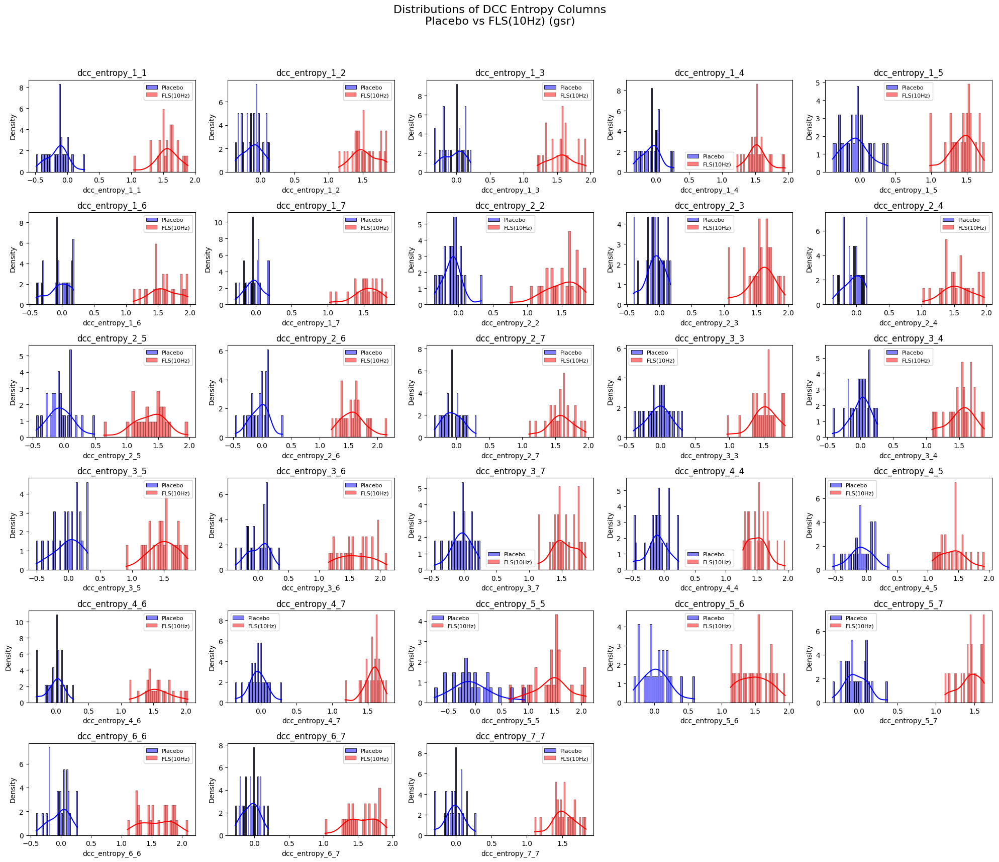

Plotting distributions for FLS(10Hz) (confound: compcor)


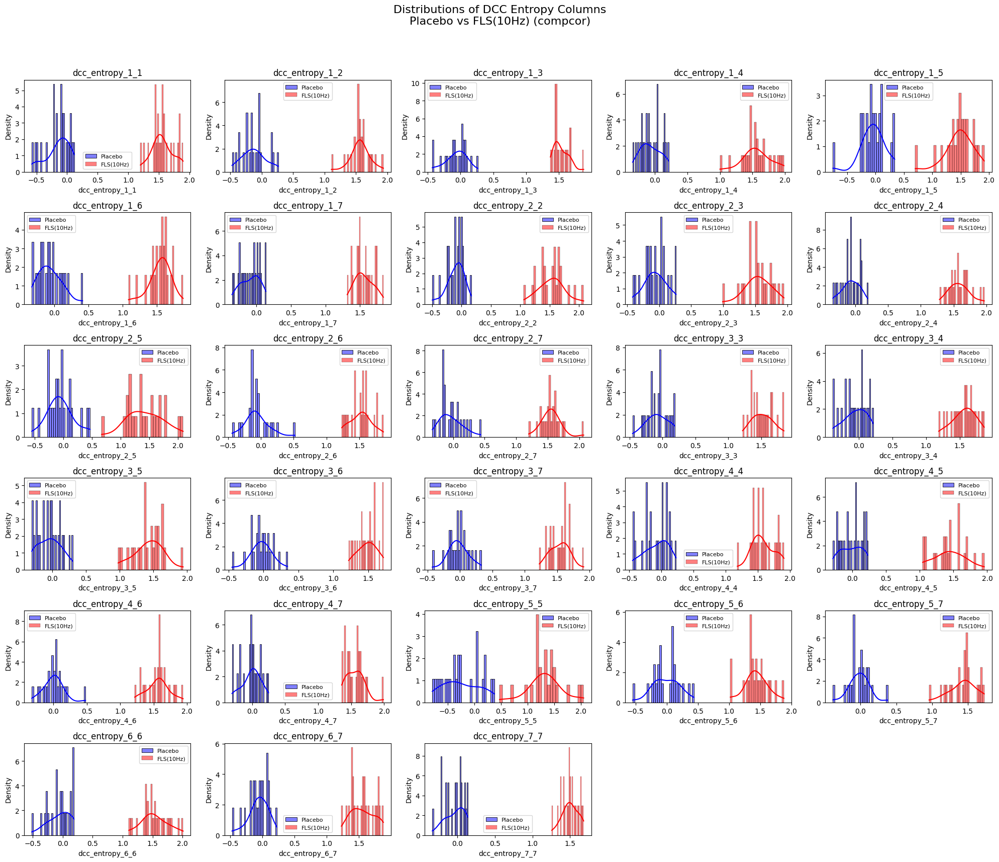

Plotting distributions for FLS(3Hz) (confound: gsr)


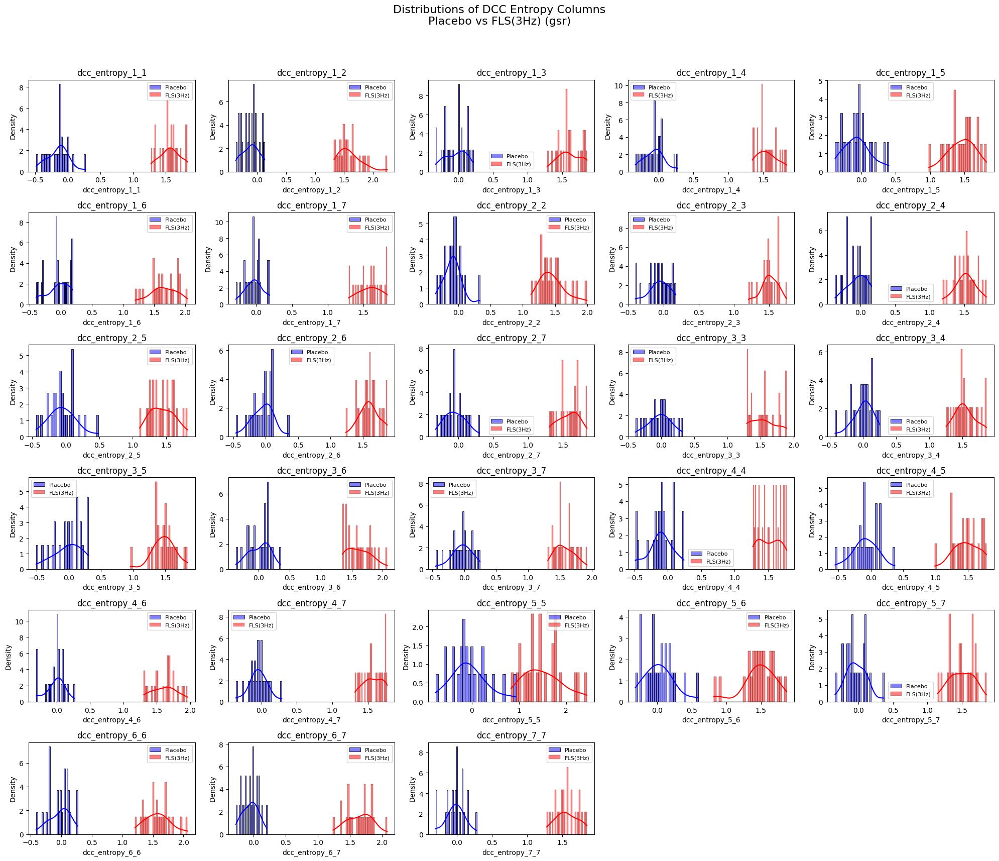

Plotting distributions for FLS(3Hz) (confound: compcor)


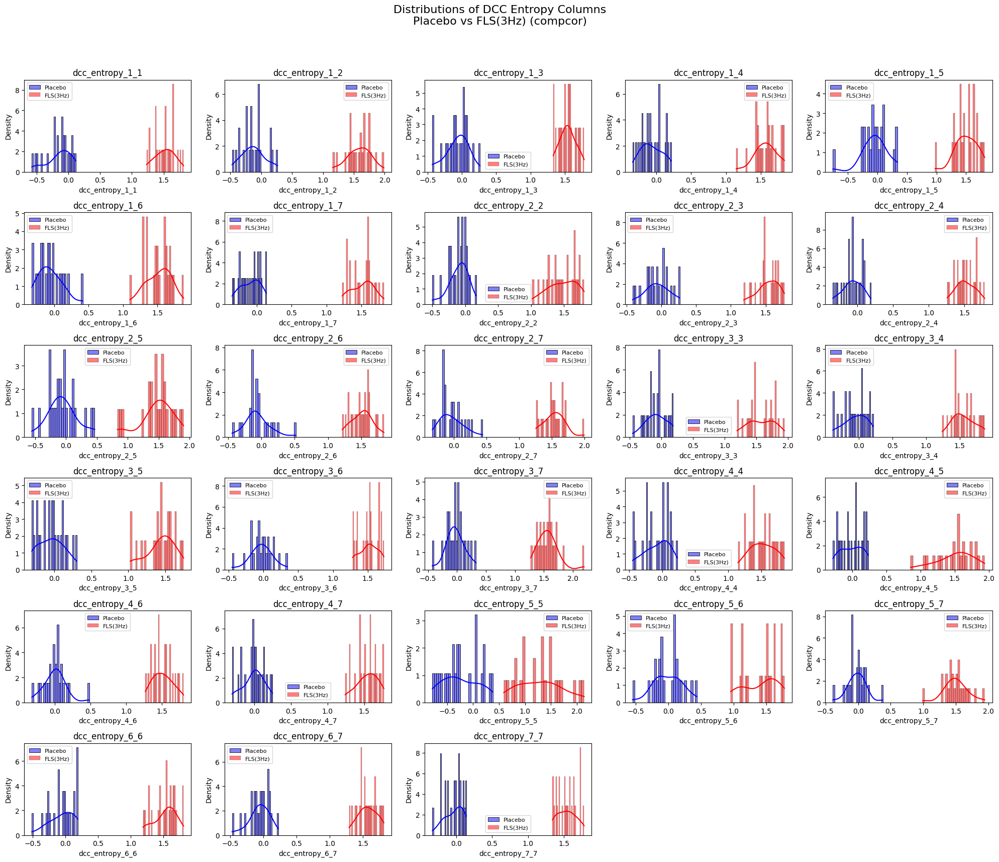

Plotting distributions for Ganzfeld (confound: gsr)


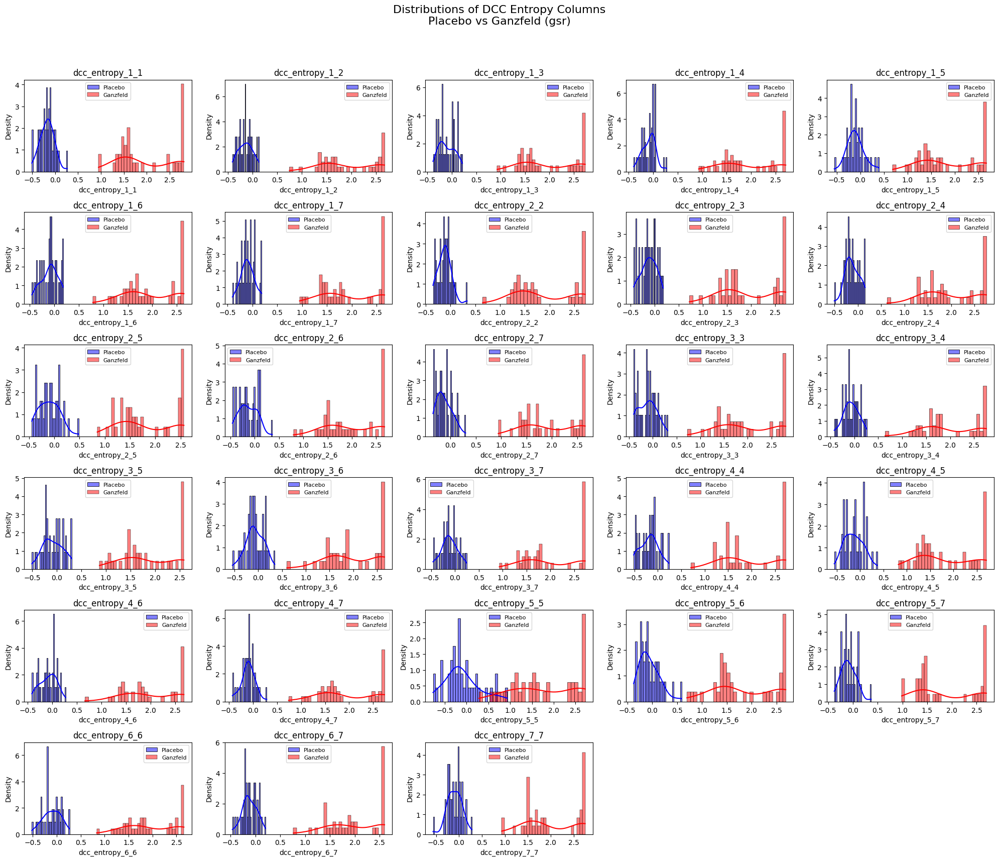

Plotting distributions for Ganzfeld (confound: compcor)


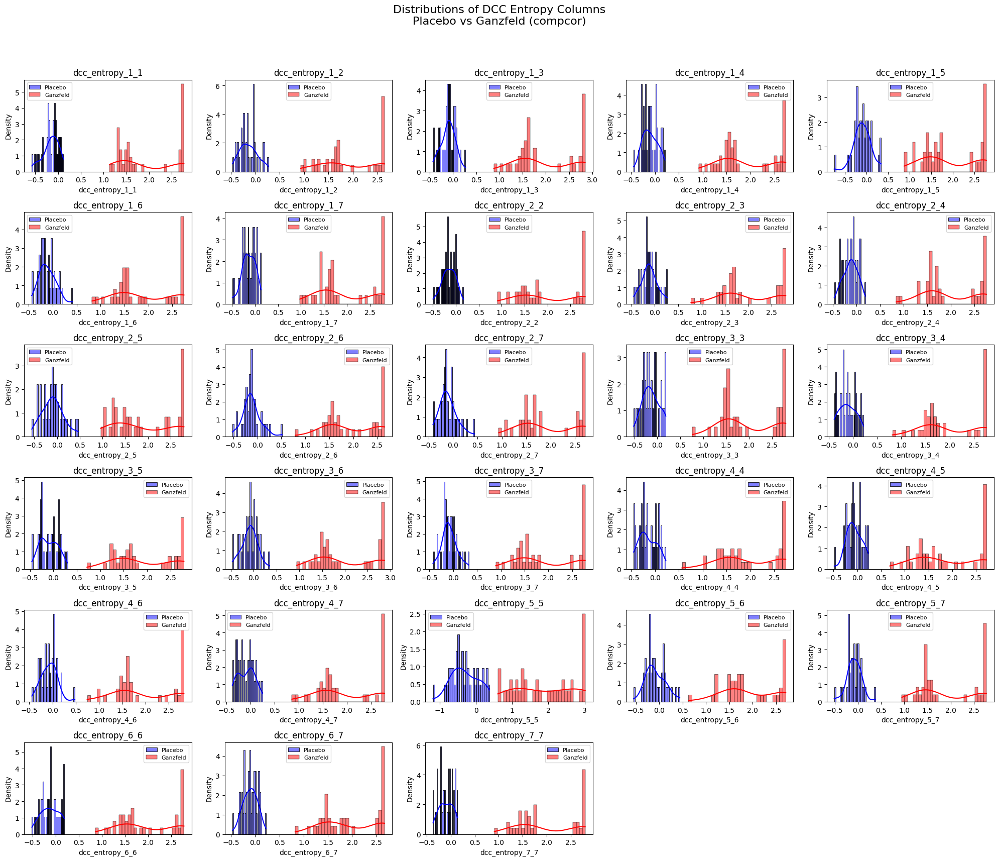

Plotting distributions for Psilocybin (confound: gsr)


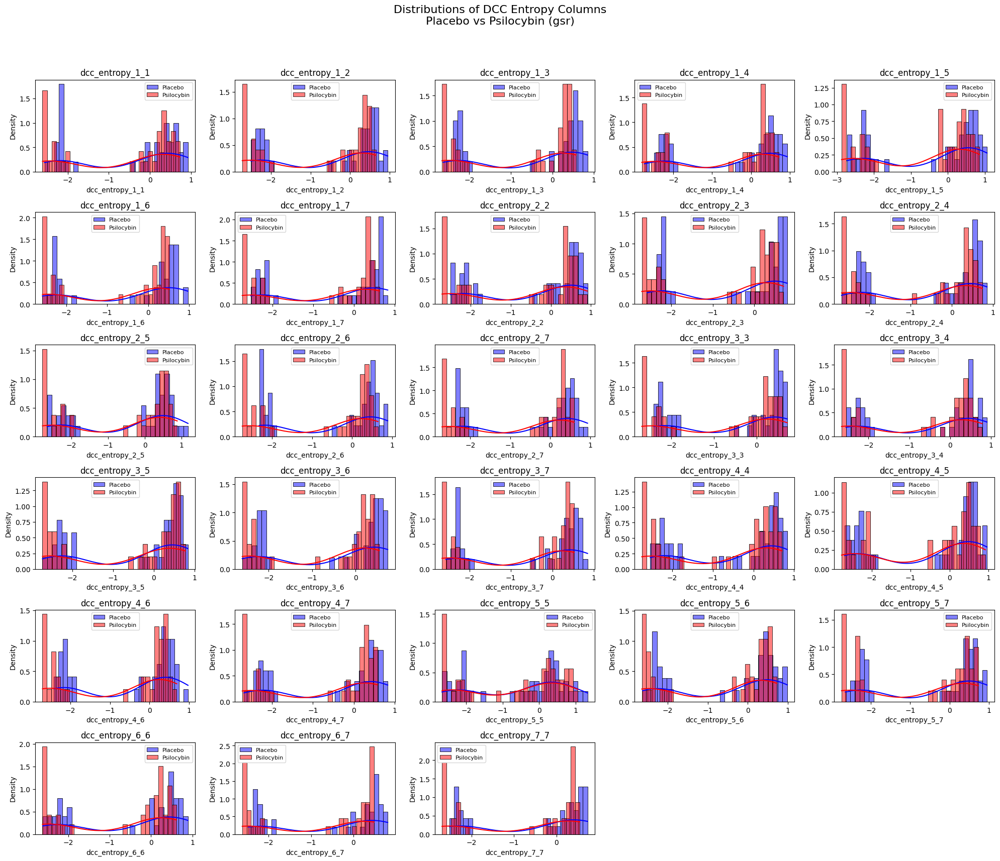

Plotting distributions for Psilocybin (confound: compcor)


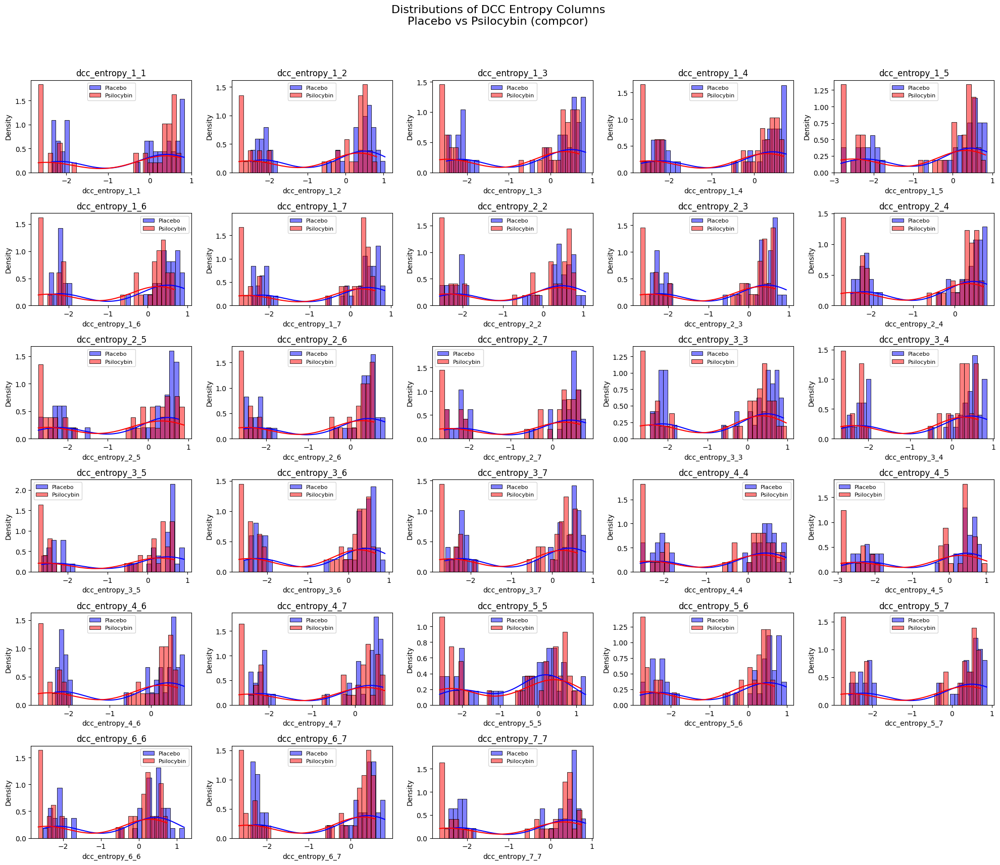

Plotting distributions for LSD (confound: gsr)


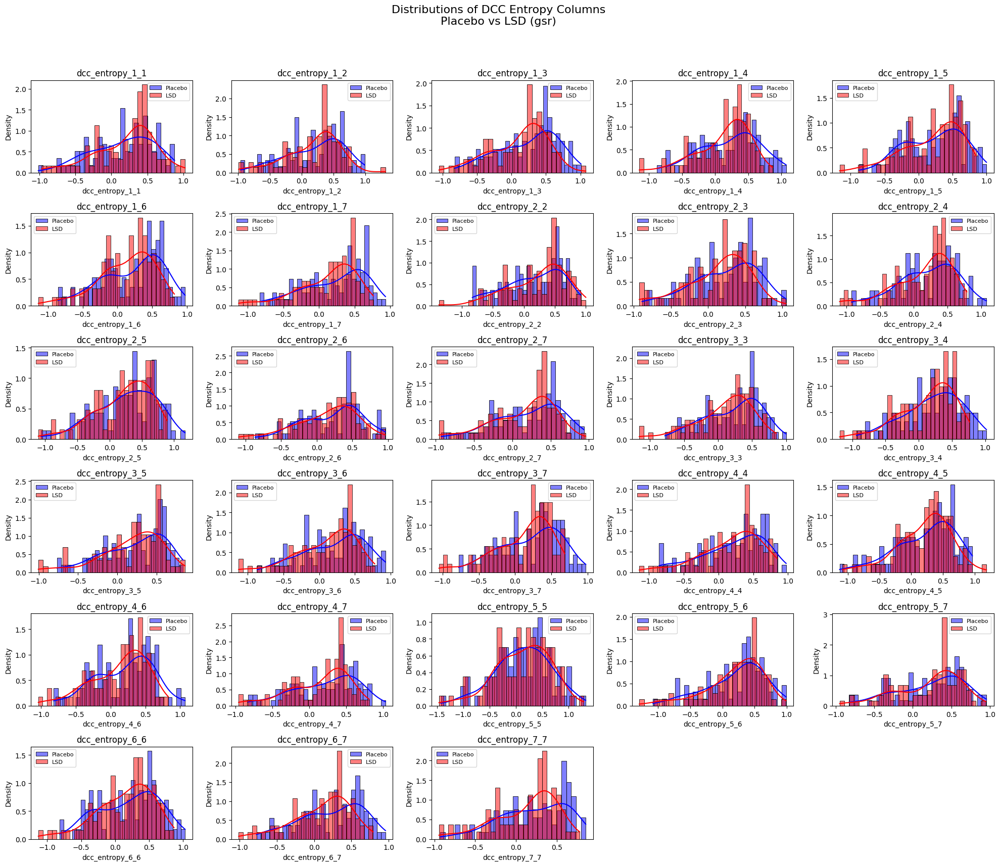

Plotting distributions for LSD (confound: compcor)


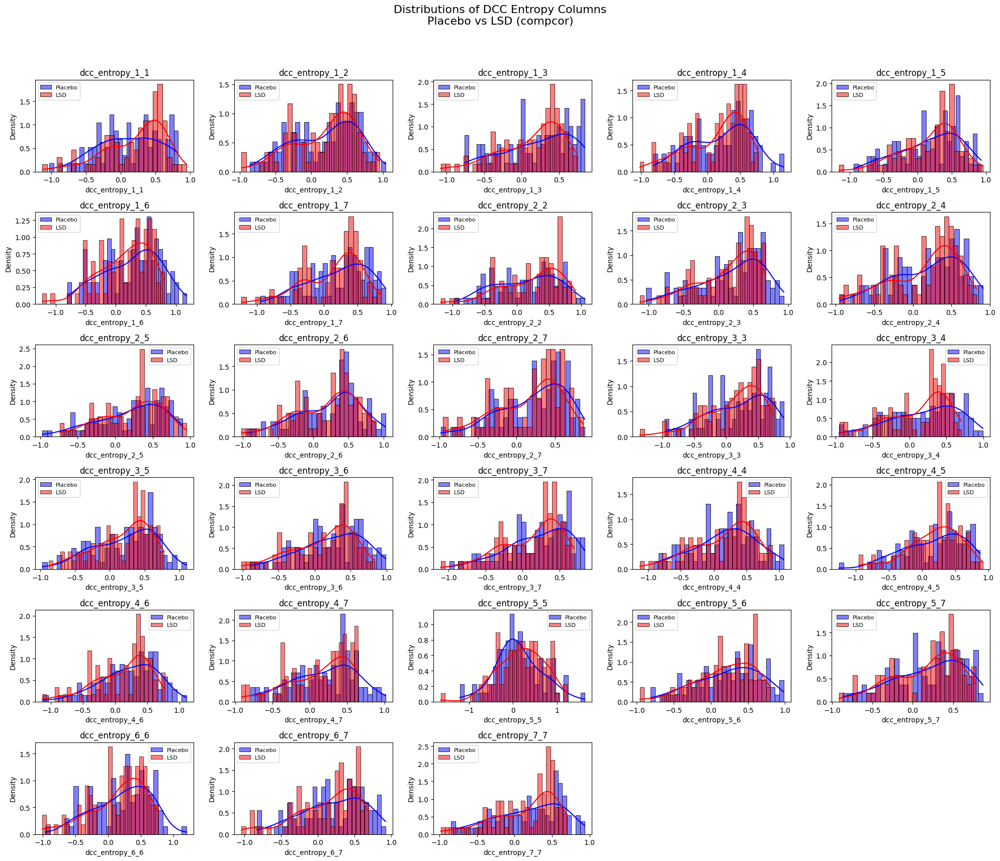

In [158]:
#### PLOT PLACEBO AND SUBSTANCE DCC ENTROPY DISTRIBUTIONS ####
## Gain insight in the distibution of task and placebo conditions per ASC

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def plot_distributions_for_substance(df, substance, confound_reg, entropy_cols, bins=30):
    """
    For a given substance (e.g., '10Hz', '3Hz', or 'Ganzfeld') and a confound regression method,
    this function plots in a grid the distributions of each DCC entropy column for the paired data
    of active (substance) and placebo conditions. Only subjects that have data in both conditions are used.
    
    Parameters:
      df: DataFrame containing your data (e.g., df_winsorized_scaled)
      substance: string for the active condition (should not be 'Placebo')
      confound_reg: string (e.g., 'gsr' or 'compcor')
      entropy_cols: list of column names to plot (e.g., all columns starting with 'dcc_entropy_')
      bins: number of bins for the histogram (default 30)
    """
    # Filter data for the given confound regression method.
    df_conf = df[df['conreg'] == confound_reg]
    
    # Get the set of subjects that have data for both conditions.
    subjects_task = set(df_conf[df_conf['task'] == substance]['unique_subject'])
    subjects_placebo = set(df_conf[df_conf['task'] == 'Placebo']['unique_subject'])
    common_subjects = subjects_task.intersection(subjects_placebo)
    
    # Filter the data to only those common subjects.
    df_placebo = df_conf[(df_conf['task'] == 'Placebo') & (df_conf['unique_subject'].isin(common_subjects))]
    df_active = df_conf[(df_conf['task'] == substance) & (df_conf['unique_subject'].isin(common_subjects))]
    
    # Determine grid size based on number of DCC entropy columns.
    n_cols_total = len(entropy_cols)
    nrows = int(np.ceil(np.sqrt(n_cols_total)))
    ncols = int(np.ceil(n_cols_total / nrows))
    
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols * 4, nrows * 3))
    # If there's only one subplot, make it a list for consistency.
    if nrows * ncols == 1:
        axes = [axes]
    else:
        axes = axes.flatten()
    
    for i, col in enumerate(entropy_cols):
        ax = axes[i]
        # Drop NaN values in each subset for the current column.
        placebo_vals = df_placebo[col].dropna()
        active_vals = df_active[col].dropna()
        
        # Plot histograms (with KDE) of both distributions on the same axes.
        sns.histplot(placebo_vals, color='blue', bins=bins, kde=True, stat='density',
                     label='Placebo', ax=ax, alpha=0.5)
        sns.histplot(active_vals, color='red', bins=bins, kde=True, stat='density',
                     label=substance, ax=ax, alpha=0.5)
        
        ax.set_title(col)
        ax.legend(fontsize=8)
    
    # Remove any unused axes.
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    fig.suptitle(f"Distributions of DCC Entropy Columns\nPlacebo vs {substance} ({confound_reg})",
                 fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Example usage:
# Assume 'df_winsorized_scaled' is your processed DataFrame.
# And define your entropy columns (excluding any whole-brain one if needed).
entropy_cols = [col for col in df_winsorized_scaled.columns 
                if col.startswith('dcc_entropy_') and col != 'dcc_entropy_entire_brain']

# List of substances for which you want to compare with their paired placebo
substances = ['FLS(10Hz)', 'FLS(3Hz)', 'Ganzfeld', 'Psilocybin', 'LSD']
confound_methods = ['gsr', 'compcor']

# Loop over each substance and each confound regression method
for substance in substances:
    for conf in confound_methods:
        print(f"Plotting distributions for {substance} (confound: {conf})")
        plot_distributions_for_substance(df_winsorized_scaled, substance, conf, entropy_cols)


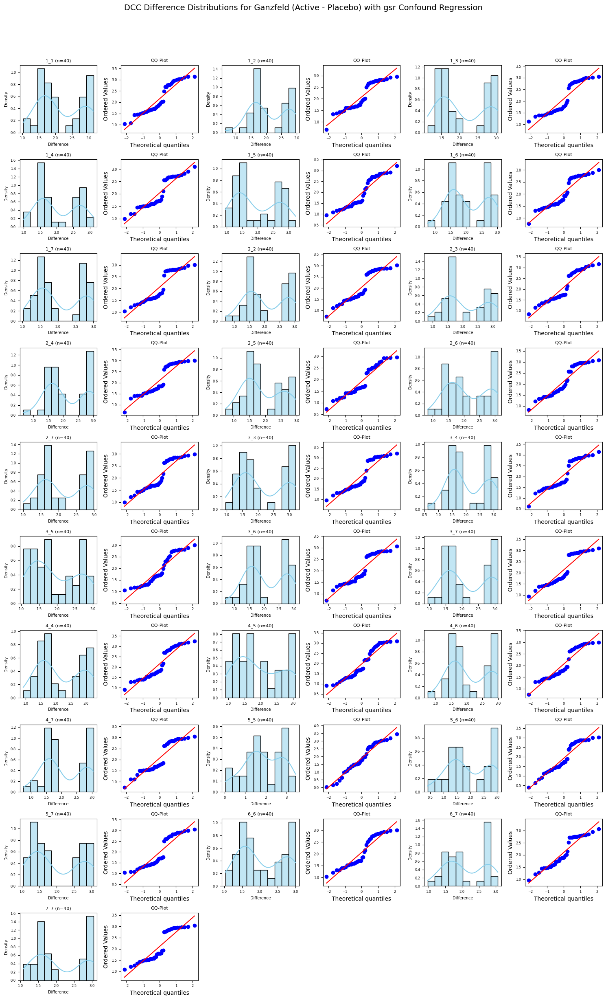

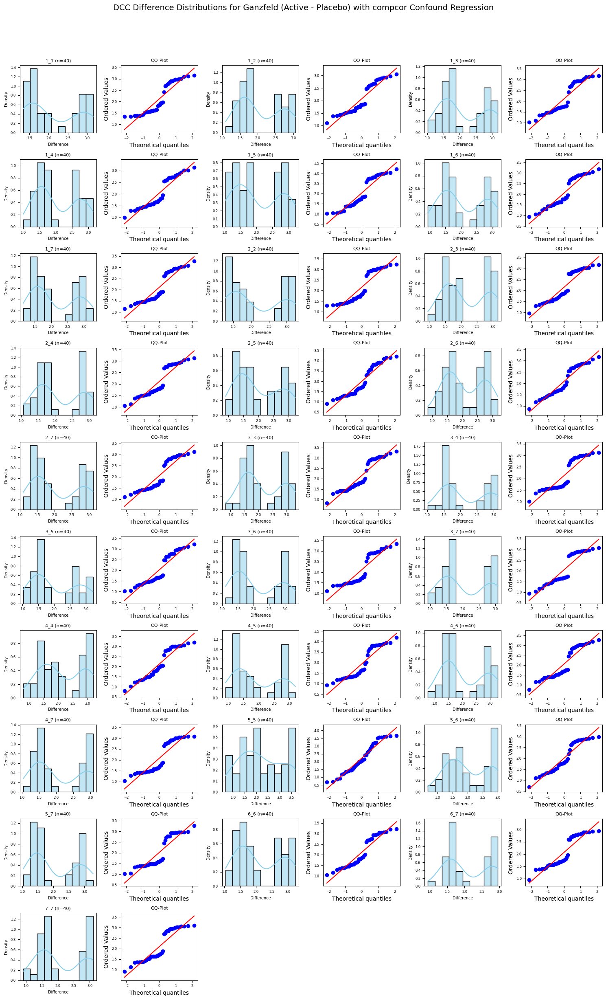

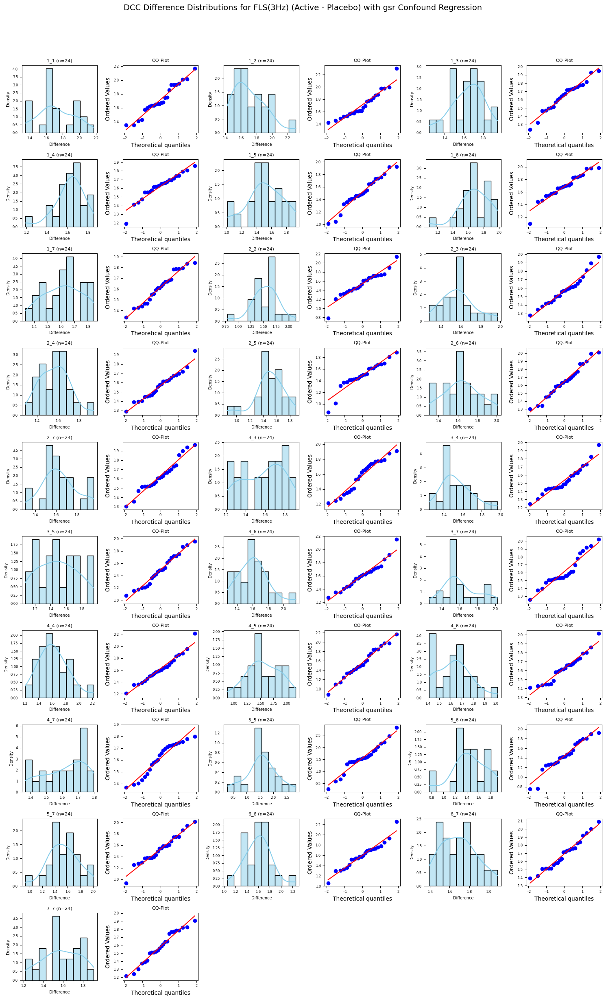

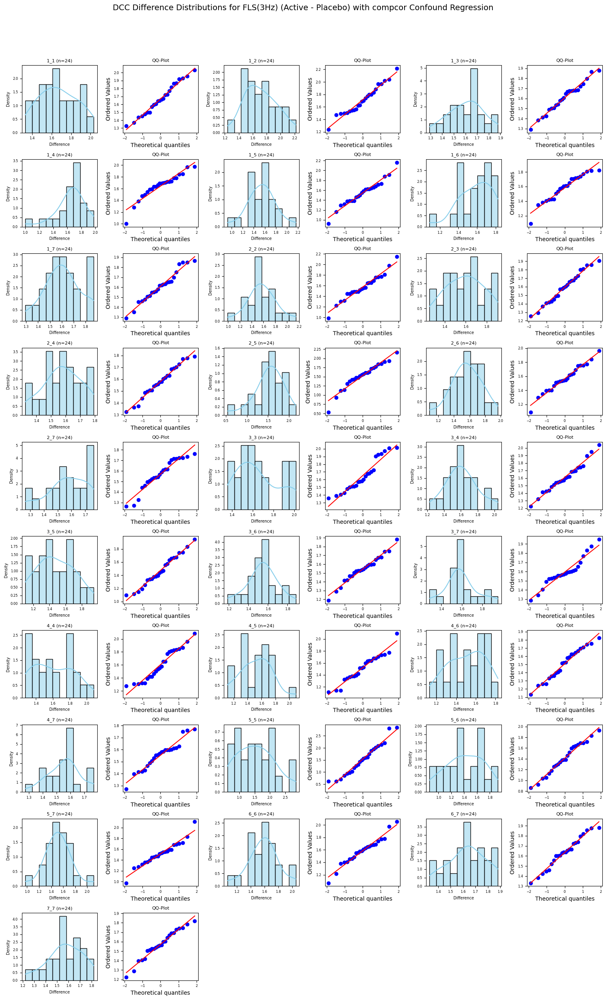

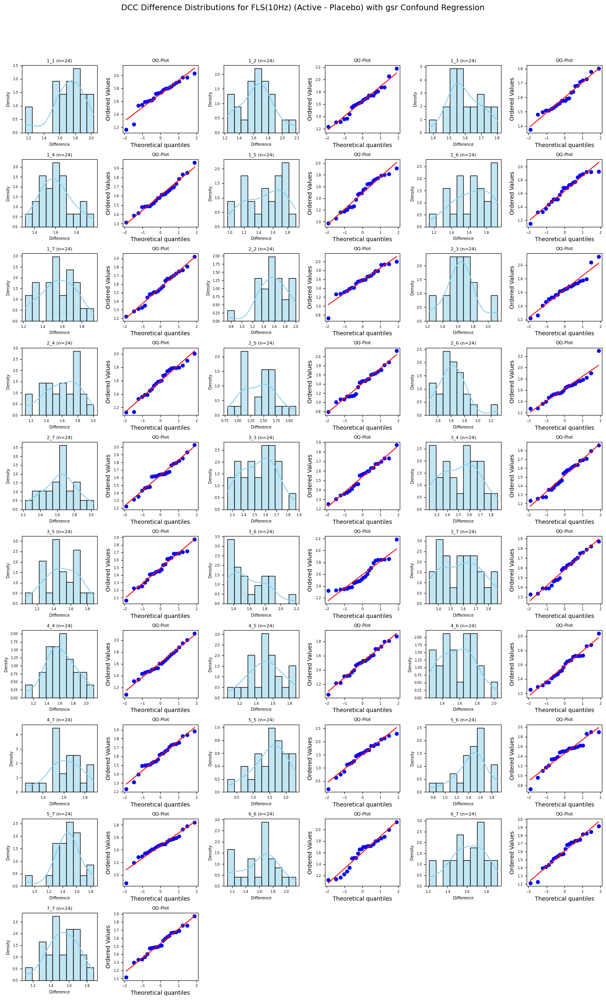

...

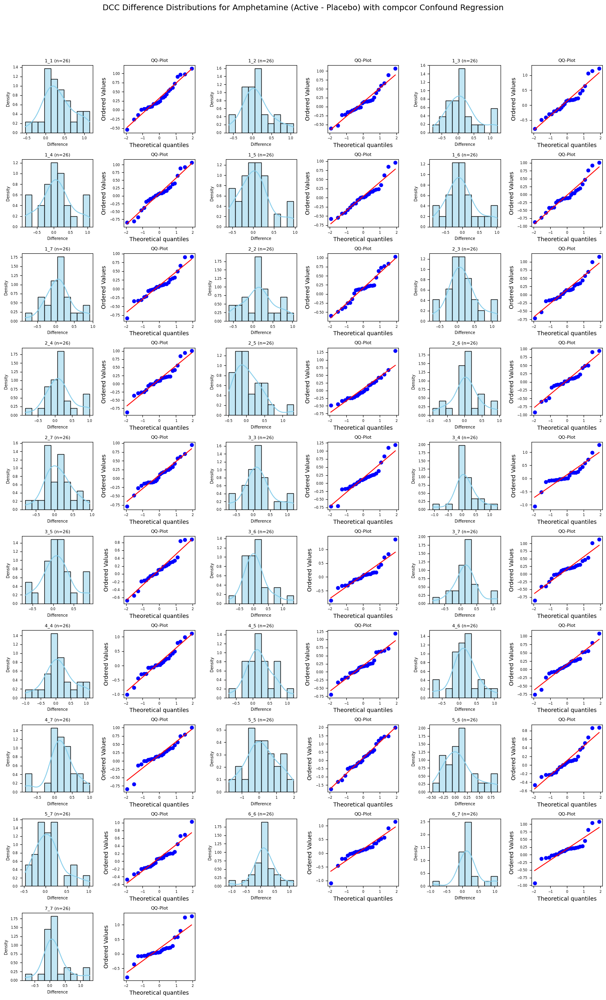

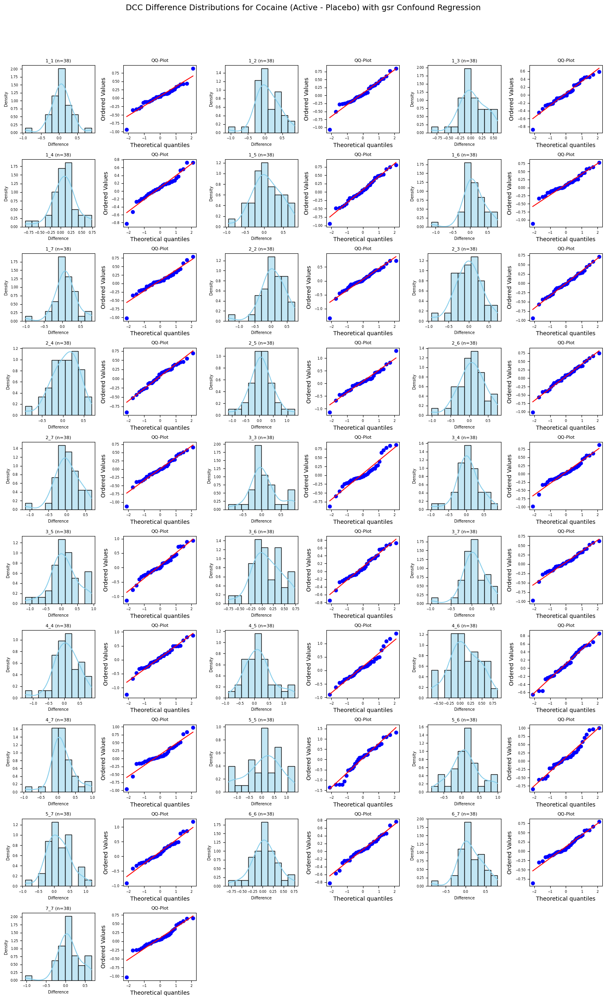

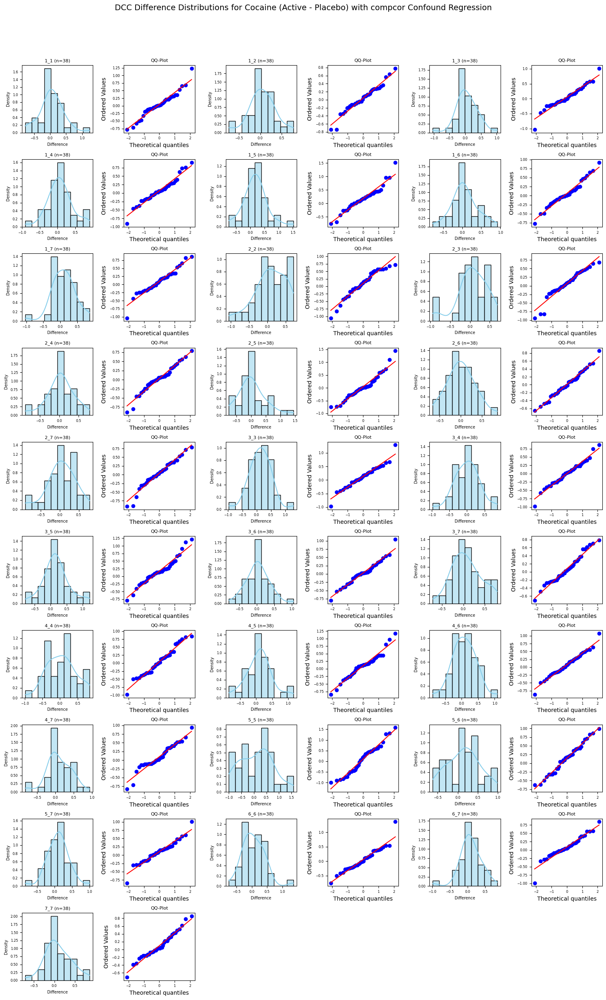

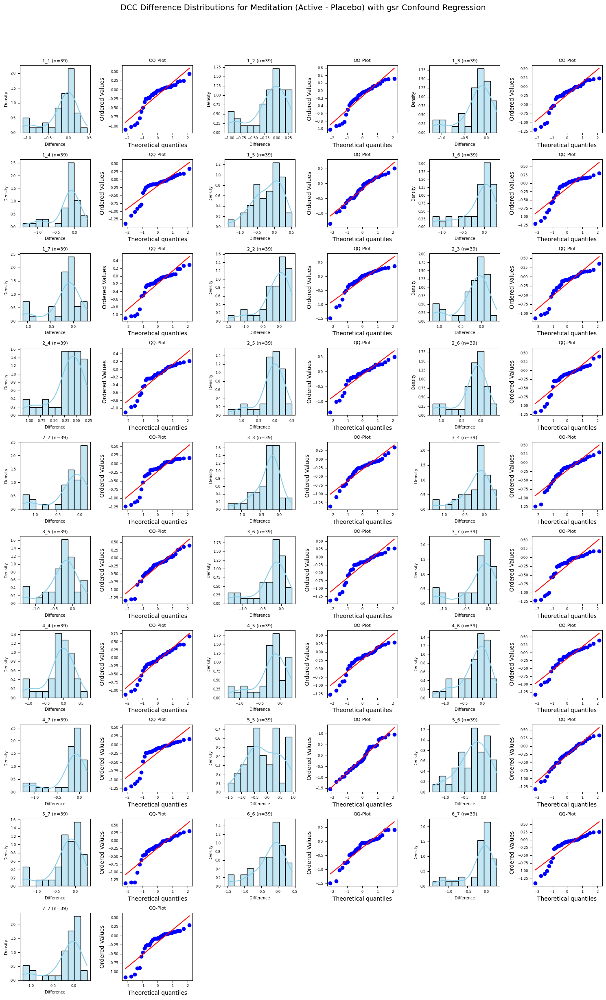

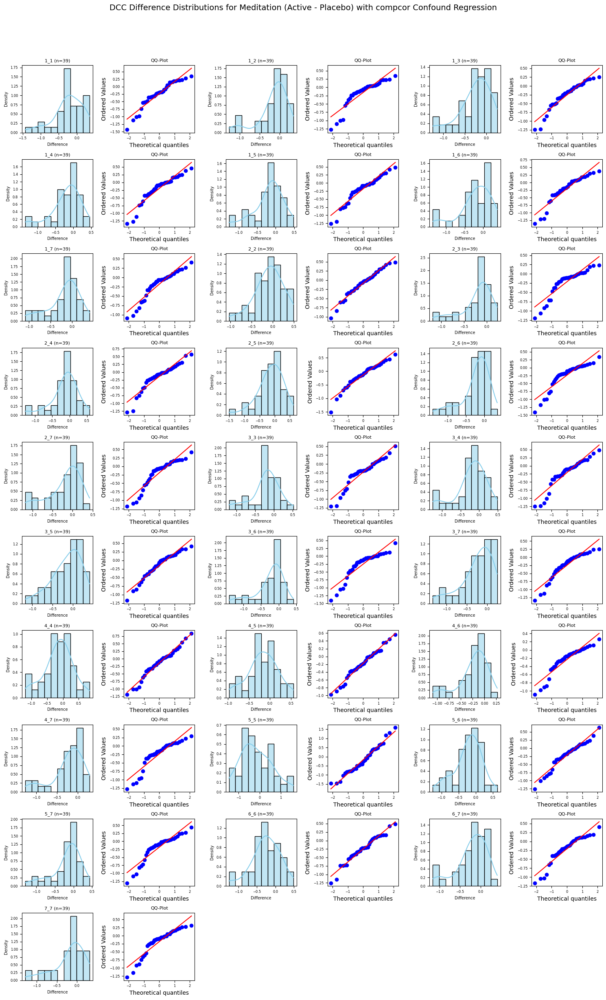

In [159]:
## CHECK NORMALITY VISUALLY ##

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import math

def plot_difference_distribution_all(df, tasks, confound_methods, entropy_cols):
    """
    Creates compact grid plots for difference distributions (active - placebo) organized by
    substance (task) and confound regression method.
    
    Uses a compact layout with 6 columns per row (3 pairs of density+QQ plots).
    
    Parameters:
    -----------
    df : pandas.DataFrame
        The full dataset.
    tasks : list of str
        List of active tasks/substances to consider (e.g., ['Ganzfeld', '3Hz', '10Hz']).
    confound_methods : list of str
        List of confound regression methods (e.g., ['gsr', 'compcor']).
    entropy_cols : list of str
        List of DCC entropy columns representing network connections.
    """
    # Go through each task+confound method combination
    for task in tasks:
        for conf in confound_methods:
            # Collect data for all entropy columns for this task+confound combination
            valid_data = []
            
            # Filter the data for the current confound method
            df_conf = df[df['conreg'] == conf]
            
            # Get placebo and active data
            df_placebo = df_conf[df_conf['task'] == 'Placebo']
            df_active = df_conf[df_conf['task'] == task]
            
            # Check if there is data for this combination
            if df_placebo.empty or df_active.empty:
                print(f"No data for {task} with {conf}.")
                continue
            
            # Process each entropy column
            for col in entropy_cols:
                # Get the subject-specific data
                placebo_data = df_placebo[['unique_subject', col]]
                active_data = df_active[['unique_subject', col]]
                
                # Merge to get only subjects with both conditions
                merged = pd.merge(placebo_data, active_data, on='unique_subject', suffixes=('_placebo', '_active'))
                
                if merged.empty or merged.shape[0] < 2:  # Need at least 2 subjects for meaningful plots
                    print(f"Insufficient paired data for {task} with {conf} in {col}.")
                    continue
                
                # Compute the difference (active - placebo)
                merged['difference'] = merged[f"{col}_active"] - merged[f"{col}_placebo"]
                
                # Store valid data
                valid_data.append({
                    'col': col,
                    'diff': merged['difference'],
                    'n': len(merged)
                })
            
            # Skip if no valid data for this combination
            if not valid_data:
                print(f"No valid network connections for {task} with {conf}.")
                continue
            
            # Calculate grid dimensions - 6 columns (3 pairs of plots)
            n_connections = len(valid_data)
            plots_per_row = 3  # Number of network connections per row
            cols_per_plot = 2  # One for density, one for QQ
            total_cols = plots_per_row * cols_per_plot
            n_rows = math.ceil(n_connections / plots_per_row)
            
            # Create figure
            fig = plt.figure(figsize=(15, 2.5 * n_rows))
            fig.suptitle(f"DCC Difference Distributions for {task} (Active - Placebo) with {conf} Confound Regression", 
                         fontsize=14, y=0.98)
            
            # Create a smaller outer margin
            plt.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.9, wspace=0.3, hspace=0.4)
            
            # Plot each network connection
            for i, data in enumerate(valid_data):
                col = data['col']
                diff = data['diff']
                n = data['n']
                
                # Calculate position in grid
                row_idx = i // plots_per_row
                col_pair_idx = i % plots_per_row
                
                # Calculate actual column indices for the two plots
                hist_col_idx = col_pair_idx * 2
                qq_col_idx = hist_col_idx + 1
                
                # Create subplots
                # For histogram
                ax_hist = plt.subplot2grid((n_rows, total_cols), (row_idx, hist_col_idx))
                
                # For QQ plot
                ax_qq = plt.subplot2grid((n_rows, total_cols), (row_idx, qq_col_idx))
                
                # Shortened column name for better display
                col_short = col.replace('dcc_entropy_', '')
                
                # Plot histogram with density
                sns.histplot(diff, kde=True, bins=10, color='skyblue', stat='density', ax=ax_hist)
                ax_hist.set_title(f"{col_short} (n={n})", fontsize=8)
                ax_hist.set_xlabel("Difference", fontsize=7)
                ax_hist.set_ylabel("Density", fontsize=7)
                ax_hist.tick_params(axis='both', which='major', labelsize=6)
                
                # Plot QQ-plot
                stats.probplot(diff, dist="norm", plot=ax_qq)
                ax_qq.set_title(f"QQ-Plot", fontsize=8)
                ax_qq.tick_params(axis='both', which='major', labelsize=6)
                for text in ax_qq.texts:
                    text.set_fontsize(6)
            
            plt.tight_layout()
            plt.subplots_adjust(top=0.92)  # Make room for suptitle
            plt.show()

# Example usage:
# Define your entropy columns (all dcc_entropy_ columns except the whole-brain one)
entropy_cols = [col for col in df_winsorized_scaled.columns 
                if col.startswith('dcc_entropy_') and col != 'dcc_entropy_entire_brain']

# Define the tasks you want to check (active conditions) 
tasks_to_plot = ['Ganzfeld', 'FLS(3Hz)', 'FLS(10Hz)', 'LSD', 'Psilocybin', 'MPH', "Moda", "THC", "MDMA", "Amphetamine", "Cocaine", "Meditation"]

# Define the confound regression methods
confound_methods = ['gsr', 'compcor']

# Call the function on your DataFrame
plot_difference_distribution_all(df_winsorized_scaled, tasks_to_plot, confound_methods, entropy_cols)

### DCC Testing (Non Parametric, Wilcoxon Signed-Rank test)

In [108]:
# WILCOXON SIGNED RANK + R EFFECT SIZE

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pingouin as pg
from scipy import stats
from statsmodels.stats.multitest import multipletests


# def calculate_effect_size_wilcoxon(task_data, placebo_data):
#     """
#     Calculate effect size r for Wilcoxon signed-rank test with directionality.
#     r = Z / sqrt(N), where Z is the z-statistic and N is the total number of observations.
    
#     Sign of r indicates direction:
#     - Positive r: Task > Placebo (higher values in task condition)
#     - Negative r: Task < Placebo (higher values in placebo condition)
    
#     Magnitude interpretation: |r| ≈ 0.1 (small effect), |r| ≈ 0.3 (medium effect), |r| ≈ 0.5 (large effect)
#     """
#     # Calculate differences (task - placebo)
#     diff = np.array(task_data) - np.array(placebo_data)
#     n_nonzero = np.sum(diff != 0)
    
#     # Determine direction (positive means task > placebo)
#     direction = 1 if np.sum(diff) > 0 else -1
    
#     # Perform the Wilcoxon test to get the statistic
#     stat, _ = stats.wilcoxon(task_data, placebo_data)
    
#     # Convert test statistic to z-score
#     z = (stat - (n_nonzero * (n_nonzero + 1) / 4)) / np.sqrt(n_nonzero * (n_nonzero + 1) * (2 * n_nonzero + 1) / 24)
    
#     # Calculate r with sign to preserve direction
#     r = direction * abs(z) / np.sqrt(len(task_data))
    
#     return r

def calculate_effect_size_wilcoxon(task_data, placebo_data):
    """
    Calculate effect size r and normalized W for Wilcoxon signed-rank test.
    """
    diff = np.array(task_data) - np.array(placebo_data)
    n_nonzero = np.sum(diff != 0)
    
    direction = 1 if np.sum(diff) > 0 else -1
    
    stat, _ = stats.wilcoxon(task_data, placebo_data)
    
    z = (stat - (n_nonzero * (n_nonzero + 1) / 4)) / np.sqrt(n_nonzero * (n_nonzero + 1) * (2 * n_nonzero + 1) / 24)
    r = direction * abs(z) / np.sqrt(len(task_data))


    return r, stat

def perform_statistical_tests_dcc_wilcoxon(df, entropy_cols, task, confound_reg):
    """
    For a given substance (task) and confound regression method,
    perform Wilcoxon signed-rank tests for each network-to-network connection.
    
    The pairing is done by:
      1. Extracting the relevant column (e.g., 'dcc_entropy_2_3') along with 'unique_subject'
         from the placebo data and from the task data.
      2. Dropping any rows with NaN in that column. (Thus, if a subject is missing either the
         placebo value or the active value for that connection, that subject is skipped for this test.)
      3. Merging the two subsets on 'unique_subject' to obtain the paired data.
    
    The function also calculates:
      - n_used: the number of subjects included in the paired test.
      - n_skipped: the number of subjects skipped (calculated as min(n_placebo, n_task) - n_used).
    
    Returns a DataFrame with one row per network-to-network connection.
    """
    results = []
    
    # Filter the data for the given confound method.
    df_conreg = df[df['conreg'] == confound_reg]
    df_placebo = df_conreg[df_conreg['task'] == 'Placebo']
    df_task = df_conreg[df_conreg['task'] == task]
    
    for col in entropy_cols:
        # For the pairing, select only the 'unique_subject' and the column of interest.
        placebo_sub = df_placebo[['unique_subject', col]].dropna()
        task_sub = df_task[['unique_subject', col]].dropna()
        
        # Merge on unique_subject so that only subjects with valid data in both conditions are used.
        merged = pd.merge(placebo_sub, task_sub, on='unique_subject', suffixes=('_placebo', '_task'))
        
        # Count how many subjects had valid data in each condition for this test.
        n_placebo = placebo_sub.shape[0]
        n_task = task_sub.shape[0]
        n_merged = merged.shape[0]
        n_skipped = min(n_placebo, n_task) - n_merged  # Number skipped for this test.
        
        # Only perform the test if at least 3 subjects are paired.
        if n_merged < 3:
            continue
        
        # Perform the Wilcoxon signed-rank test
        statistic, p_value = stats.wilcoxon(merged[col + '_task'], merged[col + '_placebo'])
        test_type = "Wilcoxon signed-rank test"
        
        # Compute effect size r for Wilcoxon
        #effect_size_r = calculate_effect_size_wilcoxon(merged[col + '_task'], merged[col + '_placebo'])
        effect_size_r, statistic = calculate_effect_size_wilcoxon(merged[col + '_task'], merged[col + '_placebo'])
        
        # uncomment to revert 
        # # Extract network numbers from the column name; expecting format "dcc_entropy_<net1>_<net2>"
        # try:
        #     net1, net2 = map(int, col.split('_')[2:])
        # except Exception:
        #     net1, net2 = None, None


        # hopefully to fix mismatch with heatmaps
        # Fixed: always sort network numbers
        try:
            net1, net2 = map(int, col.split('_')[2:])
            net1, net2 = sorted([net1, net2])
        except Exception:
            net1, net2 = None, None
        
        results.append({
            'network1': net1,
            'network2': net2,
            'network1_name': network_labels.get(net1, "Unknown"),
            'network2_name': network_labels.get(net2, "Unknown"),
            'W_statistic': statistic,
            'pvalue': p_value,
            'effect_size': effect_size_r,
            'test_type': test_type,
            'n_used': n_merged,
            'n_skipped': n_skipped
        })
        
    return pd.DataFrame(results)


def analyze_all_tasks_dcc(df, entropy_cols):
    """
    For each substance (task, excluding Placebo) and for each confound regression method,
    perform the Wilcoxon signed-rank tests (using unique_subject for pairing) for all 
    network-to-network connections. Then, for each substance and each confound method separately, 
    apply FDR correction treating all tests for that substance and confound as a family.
    
    Rows with NaN values for a specific test are dropped (thus a subject is skipped for that test
    if either the placebo or task value is missing).
    
    Returns a nested dictionary:
      results_by_substance[task][confound] = DataFrame with test results (including 'pvalue_fdr')
    """
    tasks = [t for t in df['task'].unique() if t.lower() != 'placebo']
    confound_techniques = ['gsr', 'compcor']
    results_by_substance = {}
    
    for task in tasks:
        results_by_substance[task] = {}
        for conf in confound_techniques:
            res = perform_statistical_tests_dcc_wilcoxon(df, entropy_cols, task, conf)
            results_by_substance[task][conf] = res
            print(f"Task {task}, confound {conf}: {res.shape[0]} tests performed.")
            
            # Apply FDR correction for tests within this substance and confound method.
            if not res.empty and 'pvalue' in res.columns:
                pvals = res['pvalue'].tolist()
                _, corrected_pvals, _, _ = multipletests(pvals, method='fdr_bh')
                results_by_substance[task][conf]['pvalue_fdr'] = corrected_pvals
    return results_by_substance

# Example usage:
# Define entropy columns for DCC metric.
entropy_cols = [col for col in df_winsorized_scaled if col.startswith('dcc_entropy_') 
                and col != 'dcc_entropy_entire_brain']

# Run the analysis across all tasks (substances) for the DCC metric.
results_dcc_nonpar = analyze_all_tasks_dcc(df_winsorized_scaled, entropy_cols)

# Now, print the detailed results for each substance and confound method.
for task, conf_data in results_dcc_nonpar.items():
    print(f"\nSubstance: {task}")
    for conf, df_res in conf_data.items():
        print(f"  Confound: {conf}")
        for idx, row in df_res.iterrows():
            # Skip rows with NaNs (though they should have been dropped in each test).
            if pd.isnull(row['effect_size']) or pd.isnull(row['pvalue']) or pd.isnull(row['pvalue_fdr']):
                continue
            # Determine significance stars.
            if row['pvalue_fdr'] < 0.001:
                stars = '***'
            elif row['pvalue_fdr'] < 0.01:
                stars = '**'
            elif row['pvalue_fdr'] < 0.05:
                stars = '*'
            else:
                stars = ''
            print(f"    {row['network1_name']} -> {row['network2_name']}: W = {row['W_statistic']:.3f} "
                  f"raw p = {row['pvalue']:.3e}, FDR p = {row['pvalue_fdr']:.3e} {stars}, r = {row['effect_size']:.3f}, "
                  f"n_used = {row['n_used']}, n_skipped = {row['n_skipped']}, "
                  f"test type: {row['test_type']}")

Task Amphetamine, confound gsr: 28 tests performed.
Task Amphetamine, confound compcor: 28 tests performed.
Task LSD, confound gsr: 28 tests performed.
Task LSD, confound compcor: 28 tests performed.
Task MDMA, confound gsr: 28 tests performed.
Task MDMA, confound compcor: 28 tests performed.
Task MPH, confound gsr: 28 tests performed.
Task MPH, confound compcor: 28 tests performed.
Task Moda, confound gsr: 28 tests performed.
Task Moda, confound compcor: 28 tests performed.
Task Mescaline, confound gsr: 28 tests performed.
Task Mescaline, confound compcor: 28 tests performed.
Task Psilocybin, confound gsr: 28 tests performed.
Task Psilocybin, confound compcor: 28 tests performed.
Task FLS(10Hz), confound gsr: 28 tests performed.
Task FLS(10Hz), confound compcor: 28 tests performed.
Task FLS(3Hz), confound gsr: 28 tests performed.
Task FLS(3Hz), confound compcor: 28 tests performed.
Task Ganzfeld, confound gsr: 28 tests performed.
Task Ganzfeld, confound compcor: 28 tests performed.
Ta

In [109]:
import pandas as pd
import numpy as np
from openpyxl import Workbook
from openpyxl.styles import Font, Alignment, PatternFill, Border, Side
from openpyxl.utils.dataframe import dataframe_to_rows
import warnings
warnings.filterwarnings('ignore')

def format_pvalue_apa(p):
    """Format p-values according to APA style"""
    if pd.isna(p):
        return ""
    elif p < 0.001:
        return "< .001"
    else:
        return f"{p:.3f}".lstrip('0')

def format_effect_size_apa(r):
    """Format effect size according to APA style"""
    if pd.isna(r):
        return ""
    return f"{r:.3f}".lstrip('0') if r >= 0 else f"{r:.3f}"

def format_statistic_apa(stat):
    """Format test statistic according to APA style"""
    if pd.isna(stat):
        return ""
    return f"{stat:.2f}"

def get_significance_stars(p):
    """Get significance stars for p-values"""
    if pd.isna(p):
        return ""
    elif p < 0.001:
        return "***"
    elif p < 0.01:
        return "**"
    elif p < 0.05:
        return "*"
    else:
        return ""

def create_apa_table_dataframe(results_dict):
    """Convert the nested results dictionary into a single APA-formatted DataFrame"""
    all_results = []
    
    for substance, confound_data in results_dict.items():
        for confound_method, df_results in confound_data.items():
            if df_results.empty:
                continue
                
            for _, row in df_results.iterrows():
                if pd.isnull(row['pvalue']) or pd.isnull(row['effect_size']):
                    continue
                
                connection = f"{row['network1_name']} – {row['network2_name']}"
                sig_raw = get_significance_stars(row['pvalue'])
                sig_fdr = get_significance_stars(row['pvalue_fdr'])
                
                result_row = {
                    'Substance': substance,
                    'Confound Method': confound_method.upper(),
                    'Network Connection': connection,
                    'Network 1': row['network1_name'],
                    'Network 2': row['network2_name'],
                    'W': format_statistic_apa(row['W_statistic']),
                    'p (raw)': format_pvalue_apa(row['pvalue']),
                    'Sig (raw)': sig_raw,
                    'p (FDR)': format_pvalue_apa(row['pvalue_fdr']),
                    'Sig (FDR)': sig_fdr,
                    'r': format_effect_size_apa(row['effect_size']),
                    'n': int(row['n_used']) if not pd.isna(row['n_used']) else "",
                    'n skipped': int(row['n_skipped']) if not pd.isna(row['n_skipped']) else "",
                    'Test': row['test_type']
                }
                all_results.append(result_row)
    
    return pd.DataFrame(all_results)

def apply_apa_excel_formatting(worksheet, df):
    """Apply APA style formatting to the Excel worksheet"""
    
    header_font = Font(name='Times New Roman', size=12, bold=True)
    body_font = Font(name='Times New Roman', size=12)
    italic_font = Font(name='Times New Roman', size=12, italic=True)
    
    header_fill = PatternFill(start_color='E6E6E6', end_color='E6E6E6', fill_type='solid')
    
    center_align = Alignment(horizontal='center', vertical='center')
    left_align = Alignment(horizontal='left', vertical='center')
    
    thin_border = Border(
        left=Side(style='thin'),
        right=Side(style='thin'),
        top=Side(style='thin'),
        bottom=Side(style='thin')
    )
    
    # Apply header formatting
    for col_num, column_title in enumerate(df.columns, 1):
        cell = worksheet.cell(row=1, column=col_num)
        cell.font = header_font
        cell.fill = header_fill
        cell.alignment = center_align
        cell.border = thin_border
        
        if column_title in ['p (raw)', 'p (FDR)', 'r', 'W']:
            cell.font = Font(name='Times New Roman', size=12, bold=True, italic=True)
    
    # Apply body formatting
    for row_num in range(2, len(df) + 2):
        for col_num in range(1, len(df.columns) + 1):
            cell = worksheet.cell(row=row_num, column=col_num)
            cell.font = body_font
            cell.border = thin_border
            
            if df.columns[col_num-1] in ['W', 'p (raw)', 'Sig (raw)', 'p (FDR)', 'Sig (FDR)', 'r', 'n', 'n skipped']:
                cell.alignment = center_align
            else:
                cell.alignment = left_align
            
            if df.columns[col_num-1] in ['p (raw)', 'p (FDR)', 'r', 'W']:
                cell.font = italic_font
    
    # Auto-adjust column widths
    for column in worksheet.columns:
        max_length = 0
        column_letter = column[0].column_letter
        
        for cell in column:
            try:
                if len(str(cell.value)) > max_length:
                    max_length = len(str(cell.value))
            except:
                pass
        
        adjusted_width = min(max_length + 2, 50)
        worksheet.column_dimensions[column_letter].width = adjusted_width

def create_summary_table(df):
    """Create a summary table showing counts of significant results"""
    summary_data = []
    
    for substance in df['Substance'].unique():
        for confound in df['Confound Method'].unique():
            subset = df[(df['Substance'] == substance) & (df['Confound Method'] == confound)]
            
            if subset.empty:
                continue
            
            total_tests = len(subset)
            sig_raw_05 = len(subset[subset['Sig (raw)'].isin(['*', '**', '***'])])
            sig_raw_01 = len(subset[subset['Sig (raw)'].isin(['**', '***'])])
            sig_raw_001 = len(subset[subset['Sig (raw)'] == '***'])
            
            sig_fdr_05 = len(subset[subset['Sig (FDR)'].isin(['*', '**', '***'])])
            sig_fdr_01 = len(subset[subset['Sig (FDR)'].isin(['**', '***'])])
            sig_fdr_001 = len(subset[subset['Sig (FDR)'] == '***'])
            
            summary_data.append({
                'Substance': substance,
                'Confound Method': confound,
                'Total Tests': total_tests,
                'Sig p < .05 (raw)': sig_raw_05,
                'Sig p < .01 (raw)': sig_raw_01,
                'Sig p < .001 (raw)': sig_raw_001,
                'Sig p < .05 (FDR)': sig_fdr_05,
                'Sig p < .01 (FDR)': sig_fdr_01,
                'Sig p < .001 (FDR)': sig_fdr_001
            })
    
    return pd.DataFrame(summary_data)

def export_results_to_excel(results_dict, filename='statistical_results_apa.xlsx'):
    """
    Export the statistical results to an APA-formatted Excel file
    
    Parameters:
    -----------
    results_dict : dict
        The nested dictionary from your analyze_all_tasks_dcc function
    filename : str
        Name of the Excel file to create
    """
    
    df_apa = create_apa_table_dataframe(results_dict)
    
    if df_apa.empty:
        print("No data to export!")
        return None, None
    
    df_summary = create_summary_table(df_apa)
    
    wb = Workbook()
    wb.remove(wb.active)
    
    # Create summary sheet
    ws_summary = wb.create_sheet("Summary")
    for r_idx, row in enumerate(dataframe_to_rows(df_summary, index=False, header=True), 1):
        for c_idx, value in enumerate(row, 1):
            ws_summary.cell(row=r_idx, column=c_idx, value=value)
    apply_apa_excel_formatting(ws_summary, df_summary)
    
    # Create full results sheet
    ws_full = wb.create_sheet("All Results")
    for r_idx, row in enumerate(dataframe_to_rows(df_apa, index=False, header=True), 1):
        for c_idx, value in enumerate(row, 1):
            ws_full.cell(row=r_idx, column=c_idx, value=value)
    apply_apa_excel_formatting(ws_full, df_apa)
    
    # Create separate sheets for each substance
    for substance in df_apa['Substance'].unique():
        sheet_name = f"{substance}"[:31]
        ws_substance = wb.create_sheet(sheet_name)
        
        df_substance = df_apa[df_apa['Substance'] == substance].copy()
        
        for r_idx, row in enumerate(dataframe_to_rows(df_substance, index=False, header=True), 1):
            for c_idx, value in enumerate(row, 1):
                ws_substance.cell(row=r_idx, column=c_idx, value=value)
        apply_apa_excel_formatting(ws_substance, df_substance)
    
    wb.save(filename)
    print(f"Results exported to {filename}")
    print(f"Total rows in main table: {len(df_apa)}")
    print(f"Sheets created: {[sheet.title for sheet in wb.worksheets]}")
    
    return df_apa, df_summary

# To use with your existing results:
df_main, df_summary = export_results_to_excel(results_dcc_nonpar, 'my_dcc_results_v1.xlsx')

Results exported to my_dcc_results_v1.xlsx
Total rows in main table: 728
Sheets created: ['Summary', 'All Results', 'Amphetamine', 'LSD', 'MDMA', 'MPH', 'Moda', 'Mescaline', 'Psilocybin', 'FLS(10Hz)', 'FLS(3Hz)', 'Ganzfeld', 'Cocaine', 'THC', 'Meditation']


### Heatmap to visualize all network-to-network connections

In [180]:
## plot the heatmaps nonpar ##

import numpy as np
from matplotlib.collections import PatchCollection
import matplotlib.colors as mcolors
import matplotlib.patches as patches
import seaborn as sns

def format_results_for_heatmap(results, task):
    """
    Convert statistical results into a dictionary for plotting.
    """

    print(f"Formatting results for task: {task}")

    gsr_data = {}
    compcor_data = {}
    
    if task in results:
        for conf_reg in ['gsr', 'compcor']:
            if conf_reg in results[task]:
                for _, row in results[task][conf_reg].iterrows():
                    key = (row['network1'], row['network2'])
                    if conf_reg == 'gsr':
                        gsr_data[key] = row['effect_size']
                    else:
                        compcor_data[key] = row['effect_size']
    
    return gsr_data, compcor_data

def pick_text_color(value, cmap, norm, threshold=0.7):
    """
    Dynamically choose black or white text depending on
    the luminance of the background color from 'cmap(norm(value))'.
    A higher threshold means text is black on lighter backgrounds more often.
    """
    if np.isnan(value):
        # If value is NaN, default to black text
        return 'black'
    # Map value to [0..1] in the colormap, then get RGBA
    r, g, b, _ = cmap(norm(value))
    # Approximate luminance (Rec. 709)
    luminance = 0.2126*r + 0.7152*g + 0.0722*b
    return 'black' if luminance > threshold else 'black'

def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    """Truncate a colormap to avoid extreme dark/light colors for better readability."""
    new_cmap = mcolors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),
        cmap(np.linspace(minval, maxval, n))
    )
    return new_cmap

def get_significance_stars(pvalue):
    """Return significance stars based on p-value."""
    if pvalue < 0.001:
        return '***'
    elif pvalue < 0.01:
        return '**'
    elif pvalue < 0.05:
        return '*'
    return ''

def plot_all_task_heatmaps_grid_np(results, network_labels):
    """
    Generate one heatmap per task arranged in a grid (3 columns wide) in one figure.
    The plots themselves remain unchanged.
    """

    # Convert dict-based labels (1-based) to a list, if needed
    if isinstance(network_labels, dict):
        max_net = max(network_labels.keys())
        labels = [network_labels[i] for i in range(1, max_net + 1)] 
    else:
        labels = list(network_labels)

    n = len(labels)

    # Consistent color scale for r
    vmin, vmax, center = -1, 1, 0
    cmap = sns.color_palette("RdBu_r", as_cmap=True)
    cmap = truncate_colormap(cmap, minval=0.15, maxval=0.85)
    norm = plt.Normalize(vmin=vmin, vmax=vmax)

    # Define the desired ordering of tasks to match the forest plot:
    desired_order = [
        "LSD", "Psilocybin", "Mescaline", "Cocaine", "Amphetamine", 
        "MPH", "Moda", "MDMA", "THC", "Meditation", 
        "FLS(3Hz)" , "Ganzfeld"
    ]

    # Filter the keys in `results` so that they appear in `desired_order` sequence
    tasks = [task for task in desired_order if task in results.keys()]

    # Create grid of subplots
    num_tasks = len(tasks)
    num_cols = 3
    num_rows = int(np.ceil(num_tasks / num_cols))
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(8*num_cols, 6*num_rows))
    # Flatten axes array (works whether there's 1 row or more)
    axs = axs.flatten() if num_tasks > 1 else [axs]

    for idx, task in enumerate(tasks):
        print(f"\nGenerating heatmap for task: {task}")
        ax = axs[idx]

        # 1) Extract effect sizes
        gsr_data, compcor_data = format_results_for_heatmap(results, task)

        # 2) Build NxN matrix for off-diagonal squares
        matrix = np.full((n, n), np.nan, dtype=float)
        for i in range(n):
            for j in range(n):
                key = (min(i+1, j+1), max(i+1, j+1))
                if i < j and key in gsr_data:
                    matrix[i, j] = gsr_data[key]
                elif i > j and key in compcor_data:
                    matrix[i, j] = compcor_data[key]
                # Diagonals remain NaN

        # 3) Plot the base heatmap (no grid lines, no text)
        sns.heatmap(
            matrix,
            cmap=cmap, norm=norm,
            square=True, annot=False,
            cbar=True,
            #cbar_kws={"label": "Effect Size (r)"},
            xticklabels=labels, yticklabels=labels,
            linewidths=0, linecolor=None,  # no grid lines
            ax=ax
        )
        colorbar = ax.collections[0].colorbar
        colorbar.set_label("Effect Size (r)", rotation=270, labelpad=15)

        ax.invert_yaxis()  # row 0 at top to facilitate putting both GSR and CompCor labels on top and next to the plot
        plt.setp(ax.get_xticklabels(), rotation=45, ha='right')



        # 4) Off-diagonal text & significance stars
        for row in range(n):
            for col in range(n):
                if row == col:
                    continue  # diagonal handled separately
                key = (min(row+1, col+1), max(row+1, col+1))
                if row < col:
                    # Upper => GSR
                    effect = gsr_data.get(key, np.nan)
                    try:
                        pval = results[task]['gsr'].loc[
                            (results[task]['gsr']['network1'] == key[0]) &
                            (results[task]['gsr']['network2'] == key[1]),
                            'pvalue_fdr'
                        ].iloc[0]
                    except (KeyError, IndexError):
                        pval = np.nan
                else:
                    # Lower => CompCor
                    effect = compcor_data.get(key, np.nan)
                    try:
                        pval = results[task]['compcor'].loc[
                            (results[task]['compcor']['network1'] == key[0]) &
                            (results[task]['compcor']['network2'] == key[1]),
                            'pvalue_fdr'
                        ].iloc[0]
                    except (KeyError, IndexError):
                        pval = np.nan

                if not np.isnan(effect):
                    stars = get_significance_stars(pval)
                    label = f"{effect:.2f}"
                    if stars:
                        label += f"\n{stars}"
                    text_color = pick_text_color(effect, cmap, norm)
                    ax.text(col + 0.5, row + 0.5, label,
                            ha='center', va='center', fontsize=8,
                            color=text_color)

        # # 5) Diagonal (split GSR top, CompCor bottom)
        # for i in range(n):
        #     key = (i+1, i+1)
        #     gsr_val = gsr_data.get(key, np.nan)
        #     compcor_val = compcor_data.get(key, np.nan)
        #     try:
        #         gsr_pval = results[task]['gsr'].loc[
        #             (results[task]['gsr']['network1'] == key[0]) &
        #             (results[task]['gsr']['network2'] == key[1]),
        #             'pvalue_fdr'
        #         ].iloc[0]
        #     except (KeyError, IndexError):
        #         gsr_pval = np.nan
        #     try:
        #         compcor_pval = results[task]['compcor'].loc[
        #             (results[task]['compcor']['network1'] == key[0]) &
        #             (results[task]['compcor']['network2'] == key[1]),
        #             'pvalue_fdr'
        #         ].iloc[0]
        #     except (KeyError, IndexError):
        #         compcor_pval = np.nan

        #     # Top triangle (GSR)
        #     tri_gsr = patches.Polygon(
        #         [(i, i), (i+1, i), (i+1, i+1)],
        #         closed=True,
        #         facecolor=cmap(norm(gsr_val)) if not np.isnan(gsr_val) else 'white',
        #         edgecolor='none'
        #     )
        #     ax.add_patch(tri_gsr)

        #     # Bottom triangle (CompCor)
        #     tri_cc = patches.Polygon(
        #         [(i, i), (i+1, i+1), (i, i+1)],
        #         closed=True,
        #         facecolor=cmap(norm(compcor_val)) if not np.isnan(compcor_val) else 'white',
        #         edgecolor='none'
        #     )
        #     ax.add_patch(tri_cc)

        #     # GSR text (slightly smaller & lower)
        #     if not np.isnan(gsr_val):
        #         gsr_stars = get_significance_stars(gsr_pval)
        #         gsr_label = f"{gsr_val:.2f}"
        #         if gsr_stars:
        #             gsr_label += f"\n{gsr_stars}"
        #         gsr_text_color = pick_text_color(gsr_val, cmap, norm)
        #         ax.text(i + 0.8, i + 0.36, gsr_label,
        #                 ha='center', va='center', fontsize=7.5,
        #                 color=gsr_text_color)

        #     # CompCor text (slightly smaller & higher)
        #     if not np.isnan(compcor_val):
        #         cc_stars = get_significance_stars(compcor_pval)
        #         cc_label = f"{compcor_val:.2f}"
        #         if cc_stars:
        #             cc_label += f"\n{cc_stars}"
        #         cc_text_color = pick_text_color(compcor_val, cmap, norm)
        #         ax.text(i + 0.3, i + 0.54, cc_label,
        #                 ha='center', va='center', fontsize=7.5,
        #                 color=cc_text_color)


        # 5b) Diagonal GSR on top, CompCor on bottom, second try

        # Instead of adding patches immediately, collect them first:
        triangles = []  # to store all diagonal polygons

        for i in range(n):
            key = (i+1, i+1)
            gsr_val = gsr_data.get(key, np.nan)
            compcor_val = compcor_data.get(key, np.nan)
            try:
                gsr_pval = results[task]['gsr'].loc[
                    (results[task]['gsr']['network1'] == key[0]) &
                    (results[task]['gsr']['network2'] == key[1]),
                    'pvalue_fdr'
                ].iloc[0]
            except (KeyError, IndexError):
                gsr_pval = np.nan
            try:
                compcor_pval = results[task]['compcor'].loc[
                    (results[task]['compcor']['network1'] == key[0]) &
                    (results[task]['compcor']['network2'] == key[1]),
                    'pvalue_fdr'
                ].iloc[0]
            except (KeyError, IndexError):
                compcor_pval = np.nan

            # Top triangle (GSR)
            tri_gsr = patches.Polygon(
                [(i, i), (i+1, i), (i+1, i+1)],
                closed=True,
                facecolor=cmap(norm(gsr_val)) if not np.isnan(gsr_val) else 'white',
                edgecolor='none'  # no edge stroke
            )
            # Append, do NOT add_patch yet
            triangles.append(tri_gsr)

            # Bottom triangle (CompCor)
            tri_cc = patches.Polygon(
                [(i, i), (i+1, i+1), (i, i+1)],
                closed=True,
                facecolor=cmap(norm(compcor_val)) if not np.isnan(compcor_val) else 'white',
                edgecolor='none'
            )
            triangles.append(tri_cc)

        # Create one collection from all diagonal triangles
        collection = PatchCollection(
            triangles, match_original=True,
            linewidth=0, edgecolors='none', snap=True
        )
        collection.set_antialiaseds(False)  # turn off anti-aliasing
        ax.add_collection(collection)

        # --- Now do the diagonal text after adding the patches ---
        for i in range(n):
            # Recompute values for diagonal text
            key = (i+1, i+1)
            gsr_val = gsr_data.get(key, np.nan)
            compcor_val = compcor_data.get(key, np.nan)
            #...
            

            # refetch p-values for text
            try:
                gsr_pval = results[task]['gsr'].loc[
                    (results[task]['gsr']['network1'] == key[0]) &
                    (results[task]['gsr']['network2'] == key[1]),
                    'pvalue_fdr'
                ].iloc[0]
            except (KeyError, IndexError):
                gsr_pval = np.nan

            try:
                compcor_pval = results[task]['compcor'].loc[
                    (results[task]['compcor']['network1'] == key[0]) &
                    (results[task]['compcor']['network2'] == key[1]),
                    'pvalue_fdr'
                ].iloc[0]
            except (KeyError, IndexError):
                compcor_pval = np.nan


            # GSR text
            if not np.isnan(gsr_val):
                gsr_stars = get_significance_stars(gsr_pval)
                gsr_label = f"{gsr_val:.2f}"
                if gsr_stars:
                    gsr_label += f"\n{gsr_stars}"
                gsr_text_color = pick_text_color(gsr_val, cmap, norm)
                ax.text(i + 0.75, i + 0.3, gsr_label,
                        ha='center', va='center', fontsize=7.5,
                        color=gsr_text_color, zorder=5)  # ensure on top

            # CompCor text
            if not np.isnan(compcor_val):
                cc_stars = get_significance_stars(compcor_pval)
                cc_label = f"{compcor_val:.2f}"
                if cc_stars:
                    cc_label += f"\n{cc_stars}"
                cc_text_color = pick_text_color(compcor_val, cmap, norm)
                ax.text(i + 0.3, i + 0.60, cc_label,
                        ha='center', va='center', fontsize=7.5,
                        color=cc_text_color, zorder=5)

        # 6) White line from bottom-left to top-right (tiny "gap")
        ax.plot([n + 0.5, -0.5], [n + 0.5, -0.5],
                color='white', linewidth=2, zorder=6) # were 1 and 11 before, zorder means layering order
        

        # 7) final formatting

        # The GSR and CompCor labels are flipped because the y axis is inverted.
        # So, the top triangle is truly GSR and the bottom triangle is CompCor but only with a non inverted Y axis
        # now that the y axis is inverted it appears as if CompCor is on top and Gsr is at the bottom so let's change the labels

        # Add "CompCor" label on top (centered)
        ax.text(0.5, 1.02, "CompCor", fontsize=10, fontweight='regular',
                ha='center', transform=ax.transAxes)

        # Add "GSR" label on the side of the color bar
        ax.text(n + 0.10, n/2, "GSR", fontsize=10, fontweight='regular',
                va='center', rotation=-90, color='black')
        
        # Title
        ax.set_title(f"\n{task} vs Placebo", fontsize=14, pad=22)

    # Turn off any unused subplots if the grid has extra axes
    for j in range(len(tasks), len(axs)):
        axs[j].axis('off')

    plt.tight_layout()
    plt.show()
    


Generating heatmap for task: LSD
Formatting results for task: LSD

Generating heatmap for task: Psilocybin
Formatting results for task: Psilocybin

Generating heatmap for task: Mescaline
Formatting results for task: Mescaline

Generating heatmap for task: Cocaine
Formatting results for task: Cocaine

Generating heatmap for task: Amphetamine
Formatting results for task: Amphetamine

Generating heatmap for task: MPH
Formatting results for task: MPH

Generating heatmap for task: Moda
Formatting results for task: Moda

Generating heatmap for task: MDMA
Formatting results for task: MDMA

Generating heatmap for task: THC
Formatting results for task: THC

Generating heatmap for task: Meditation
Formatting results for task: Meditation

Generating heatmap for task: FLS(3Hz)
Formatting results for task: FLS(3Hz)

Generating heatmap for task: Ganzfeld
Formatting results for task: Ganzfeld


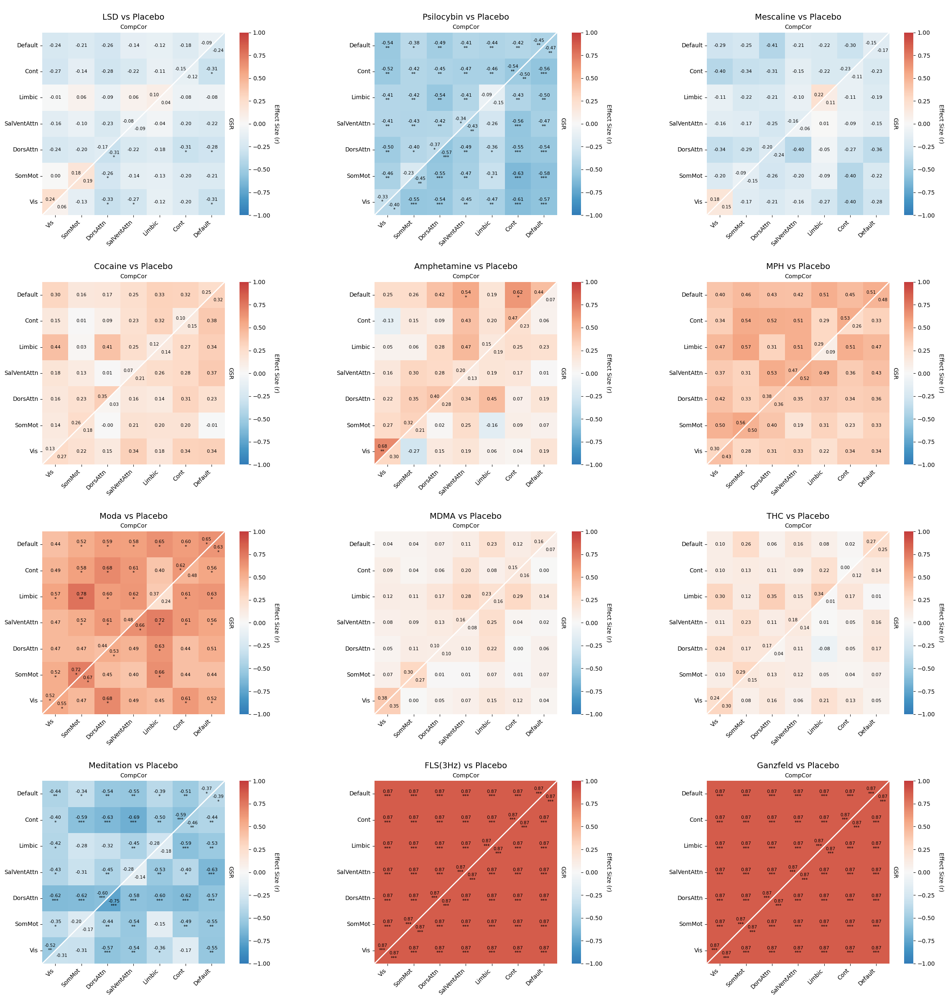

In [181]:
# (non parametric results)

plot_all_task_heatmaps_grid_np(results_dcc_nonpar, network_labels)

### DCC Entropy Over the Entire Brain

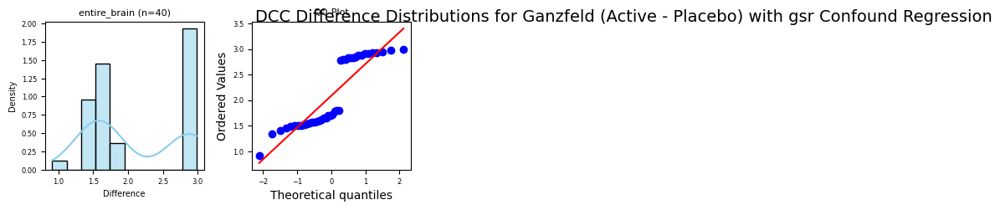

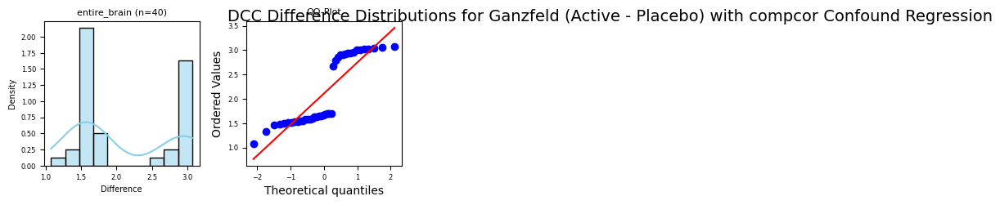

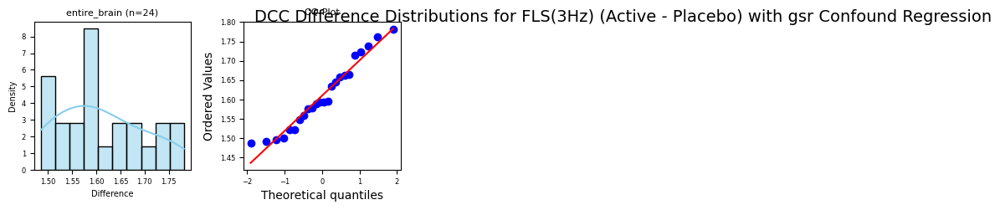

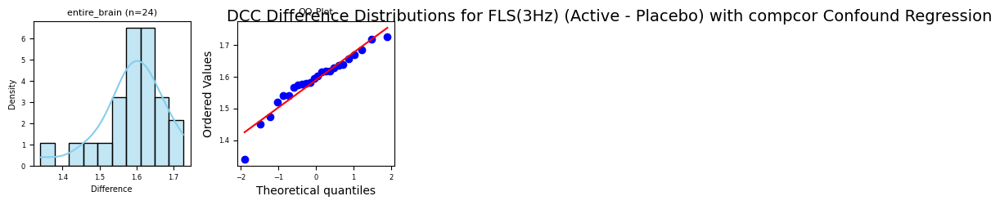

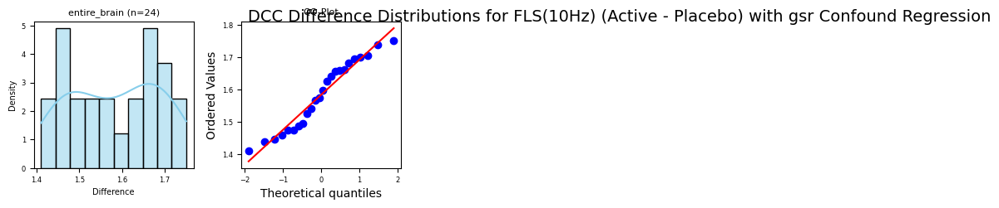

...

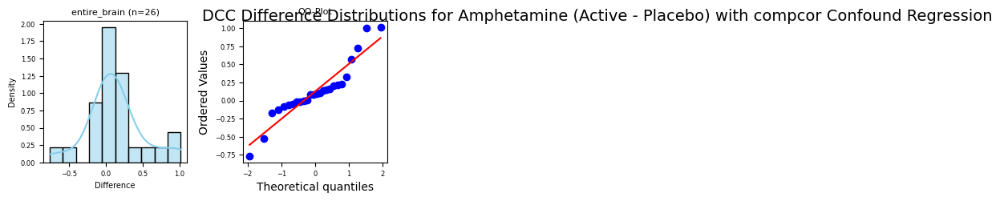

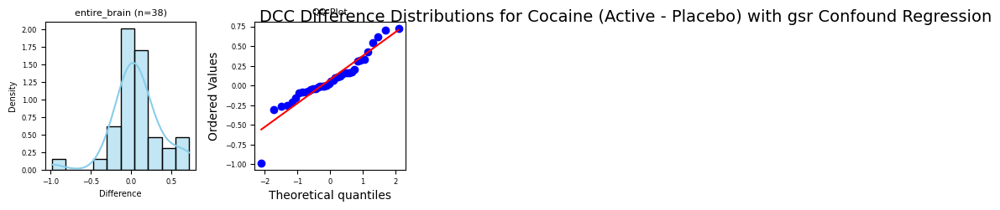

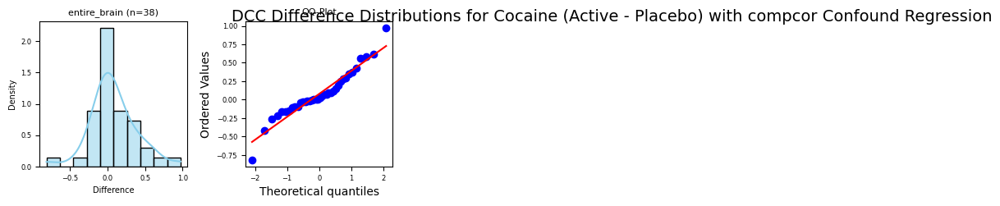

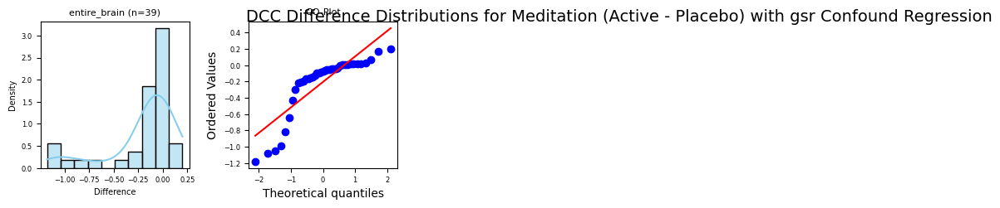

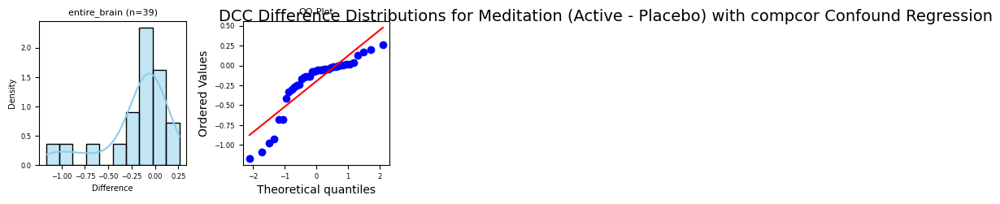

In [8]:
## CHECK NORMALITY OF ENTIRE BRAIN DCC ENTROPY ##

# Define your entropy columns (all dcc_entropy_ columns except the whole-brain one)
entropy_cols = ['dcc_entropy_entire_brain']

# Define the tasks you want to check (active conditions) 
tasks_to_plot = ['Ganzfeld', 'FLS(3Hz)', 'FLS(10Hz)', 'LSD', 'Psilocybin', 'MPH', "Moda", "THC", "MDMA", "Amphetamine", "Cocaine", "Meditation"]

# Define the confound regression methods
confound_methods = ['gsr', 'compcor']

# Call the function on your DataFrame
plot_difference_distribution_all(df_winsorized_scaled, tasks_to_plot, confound_methods, entropy_cols)

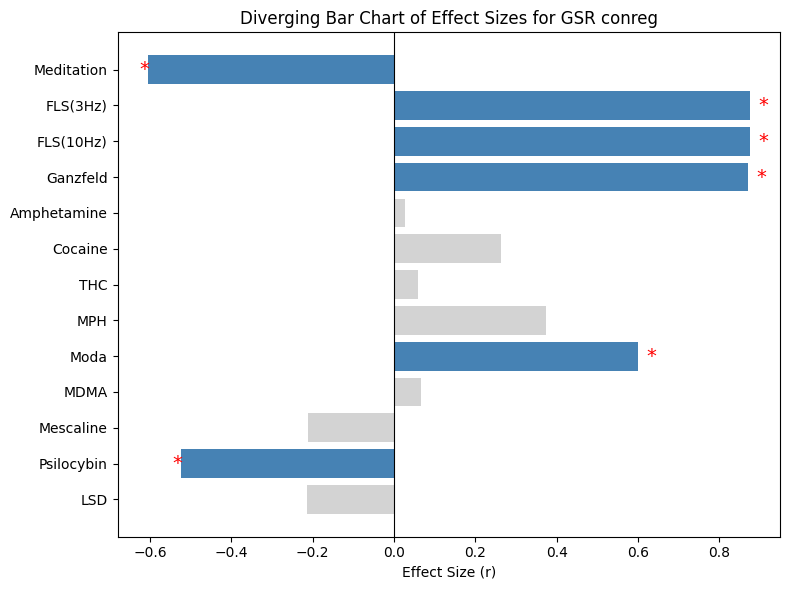

In [302]:
import matplotlib.pyplot as plt
import pandas as pd

# Example subset of results_df for one conreg style (e.g., "gsr")
df_vis = results_dcc_entirebrain_np[results_dcc_entirebrain_np['Conreg'] == 'gsr'].copy()

# Define the desired ordering of tasks to match the forest plot:
desired_order = [
    "LSD", "Psilocybin", "Mescaline", "MDMA", "Moda", 
    "MPH", "THC", "Cocaine", "Amphetamine", "Ganzfeld", 
    "FLS(10Hz)", "FLS(3Hz)", "Meditation"
]

# Convert the "Task" column into a categorical variable with the fixed order
df_vis['Task'] = pd.Categorical(df_vis['Task'], categories=desired_order, ordered=True)
# Sort the DataFrame by the fixed categorical order
df_vis = df_vis.sort_values('Task')

# Create a color mapping: significant results in a distinct color
colors = df_vis['significant_after_fdr'].map({True: 'steelblue', False: 'lightgray'})

plt.figure(figsize=(8, 6))
bars = plt.barh(df_vis['Task'], df_vis['r_effect_size'], color=colors)

# Add annotations for significance (e.g., asterisk if significant)
for bar, sig in zip(bars, df_vis['significant_after_fdr']):
    width = bar.get_width()
    if sig:
        plt.text(width + 0.02 if width > 0 else width - 0.02, 
                 bar.get_y() + bar.get_height()/2, 
                 '*', va='center', color='red', fontsize=14)

plt.axvline(0, color='black', linewidth=0.8)
plt.xlabel('Effect Size (r)')
plt.title('Diverging Bar Chart of Effect Sizes for GSR conreg')
plt.tight_layout()
plt.show()

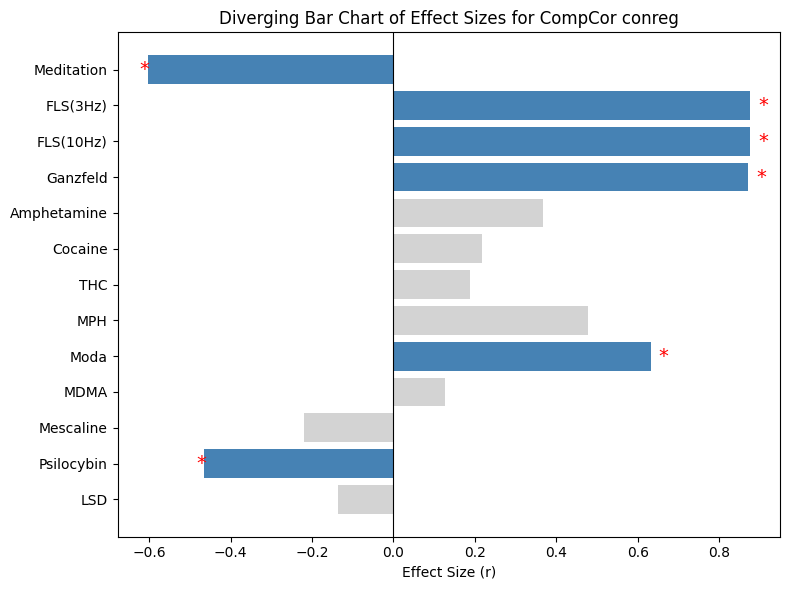

In [303]:
import matplotlib.pyplot as plt
import pandas as pd

# Example subset of results_df for one conreg style (e.g., "gsr")
df_vis = results_dcc_entirebrain_np[results_dcc_entirebrain_np['Conreg'] == 'compcor'].copy()

# Define the desired ordering of tasks to match the forest plot:
desired_order = [
    "LSD", "Psilocybin", "Mescaline", "MDMA", "Moda", 
    "MPH", "THC", "Cocaine", "Amphetamine", "Ganzfeld", 
    "FLS(10Hz)", "FLS(3Hz)", "Meditation"
]

# Convert the "Task" column into a categorical variable with the fixed order
df_vis['Task'] = pd.Categorical(df_vis['Task'], categories=desired_order, ordered=True)
# Sort the DataFrame by the fixed categorical order
df_vis = df_vis.sort_values('Task')

# Create a color mapping: significant results in a distinct color
colors = df_vis['significant_after_fdr'].map({True: 'steelblue', False: 'lightgray'})

plt.figure(figsize=(8, 6))
bars = plt.barh(df_vis['Task'], df_vis['r_effect_size'], color=colors)

# Add annotations for significance (e.g., asterisk if significant)
for bar, sig in zip(bars, df_vis['significant_after_fdr']):
    width = bar.get_width()
    if sig:
        plt.text(width + 0.02 if width > 0 else width - 0.02, 
                 bar.get_y() + bar.get_height()/2, 
                 '*', va='center', color='red', fontsize=14)

plt.axvline(0, color='black', linewidth=0.8)
plt.xlabel('Effect Size (r)')
plt.title('Diverging Bar Chart of Effect Sizes for CompCor conreg')
plt.tight_layout()
plt.show()

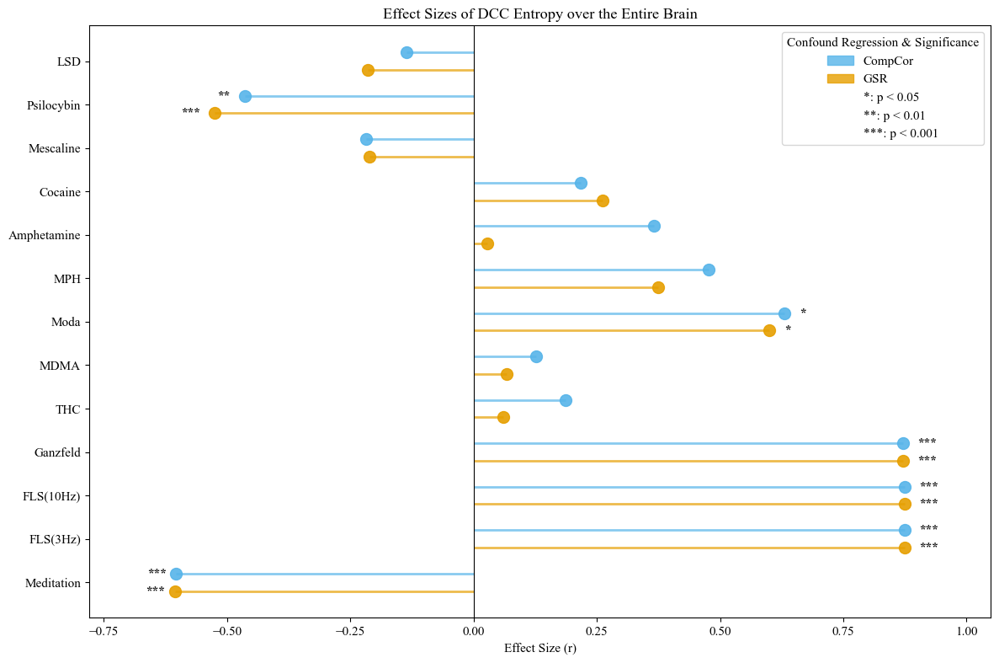

In [267]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import matplotlib.patches as mpatches

def plot_combined_lollipop(results_dcc_entirebrain_np, desired_order=None):
    """
    Creates a combined grouped lollipop chart comparing the effect sizes 
    from two confound regression methods (e.g., CompCor and GSR) for each substance.
    
    Parameters:
      results_dcc_entirebrain_np : pd.DataFrame
          The DataFrame containing your analysis results. It must include at least
          the following columns:
            'Conreg'            - confound regression method (e.g., "compcor", "gsr")
            'Task'              - substance or altered state (e.g., "LSD", "Psilocybin", etc.)
            'r_effect_size'     - averaged effect size value (number)
            'significant_after_fdr' - a boolean column indicating significance 
                                      (after FDR correction)
            'fdr_p_value'       - p-value for the effect (optional, for automatic significance level)
      desired_order : list or None
          Optional list defining the order of substances along the y-axis. If None,
          a default ordering will be used.
    """
    
    if desired_order is None:
        desired_order = [
            "Meditation", "FLS(3Hz)", "FLS(10Hz)", "Ganzfeld", "THC",
            "MDMA", "Moda", "MPH", "Amphetamine", "Cocaine",
            "Mescaline", "Psilocybin", "LSD"
        ]
    
    # Make a local copy without modifying the global DataFrame
    local_data = results_dcc_entirebrain_np.copy()
    
    # Drop any rows with missing Task values
    local_data = local_data[local_data['Task'].notna()]
    
    # Add significance_level if not present but fdr_p_value is available
    if 'significance_level' not in local_data.columns and 'fdr_p_value' in local_data.columns:
        local_data['significance_level'] = 0
        local_data.loc[local_data['fdr_p_value'] < 0.05, 'significance_level'] = 1
        local_data.loc[local_data['fdr_p_value'] < 0.01, 'significance_level'] = 2
        local_data.loc[local_data['fdr_p_value'] < 0.001, 'significance_level'] = 3
    
    # For demonstration, if neither significance_level nor p-value exists, set levels for specific tasks
    # In real usage, you should provide either significance_level or p-value in your dataframe
    if 'significance_level' not in local_data.columns:
        local_data['significance_level'] = 1  # Default to 1 asterisk
        
        # Set specific tasks to have higher significance levels
        # Modify this based on your actual knowledge of which tasks should have which levels
        high_sig_tasks = ["Meditation", "FLS(3Hz)", "FLS(10Hz)", "Ganzfeld"]
        for task in high_sig_tasks:
            local_data.loc[local_data['Task'] == task, 'significance_level'] = 3
    
    # Convert the Task column to a categorical type with the desired order (for sorting)
    local_data = local_data.assign(Task=pd.Categorical(local_data['Task'], 
                                                       categories=desired_order, 
                                                       ordered=True))
    local_data.sort_values('Task', inplace=True)
    
    # Map each substance in the desired_order to a base y-coordinate.
    substance_to_y = {sub: i for i, sub in enumerate(desired_order)}
    vertical_offset = 0.2  # Offset for differentiating the two methods on the same substance
    
    plt.figure(figsize=(12, 8))
    
    # Loop over local_data rows to plot each effect size.
    for _, row in local_data.iterrows():
        # Get the base y-coordinate for this Task (substance)
        base_y = substance_to_y.get(row['Task'])
        if base_y is None:
            continue  # Skip if the task isn't in the mapping
        
        # Adjust y-position by a vertical offset based on the confound regression method.
        conreg_lower = str(row['Conreg']).lower()
        if conreg_lower == 'compcor':
            y_pos = base_y + vertical_offset
        elif conreg_lower == 'gsr':
            y_pos = base_y - vertical_offset
        else:
            y_pos = base_y
        
        # Choose a color based on the regression method.
        color = '#56B4E9' if conreg_lower == 'compcor' else '#E69F00'
        
        # Draw a horizontal line ("lollipop stick") from 0 to the effect size.
        plt.hlines(y=y_pos, xmin=0, xmax=row['r_effect_size'], color=color, lw=2, alpha=0.7)
        
        # Draw the marker ("lollipop head").
        plt.scatter(row['r_effect_size'], y_pos, color=color, s=100, zorder=3, alpha=0.9)
        
        # Annotate significance using a marker next to the point if significant after FDR correction
        if row.get('significant_after_fdr', False):
            # Get significance level (default to 1 if not provided)
            sig_level = int(row.get('significance_level', 1))
            
            # Calculate marker position based on effect size direction
            direction = 1 if row['r_effect_size'] >= 0 else -1
            
            # Base offset for the asterisk (slightly larger than before)
            marker_x = row['r_effect_size'] + (0.03 * direction)  # Smaller offset to be closer to the dot
            
            # Draw significance level with a compact text tag
            sig_text = ''
            if sig_level == 1:
                sig_text = '*'
            elif sig_level == 2:
                sig_text = '**'
            else:  # level 3
                sig_text = '***'
                
            text_align = 'left' if direction > 0 else 'right'
            
            # Handle the special case for Meditation with negative values
            # Place the significance indicators slightly differently
            if row['Task'] == 'Meditation':
                # For Meditation, place asterisks even closer
                marker_x = row['r_effect_size'] + (0.02 * direction)
                plt.text(marker_x, y_pos, sig_text, 
                         fontsize=11, fontweight='bold', 
                         ha=text_align, va='center', 
                         color='black')
            else:
                # For all other tasks
                plt.text(marker_x, y_pos, sig_text, 
                         fontsize=11, fontweight='bold', 
                         ha=text_align, va='center', 
                         color='black')
    
    # Draw a vertical reference line at 0.
    plt.axvline(0, color='black', lw=0.8)
    
    # Set y-ticks at the base positions with substance names.
    plt.yticks(list(substance_to_y.values()), list(substance_to_y.keys()))
    plt.xlabel('Effect Size (r)')
    plt.title('Effect Sizes of DCC Entropy over the Entire Brain')
    
    # Create a legend for the confound regression methods.
    compcor_patch = mpatches.Patch(color='#56B4E9', label='CompCor', alpha=0.8)
    gsr_patch = mpatches.Patch(color='#E69F00', label='GSR', alpha=0.8)
    
    # Add legend entries for significance levels
    sig_handles = []
    sig_labels = []
    
    sig_handles.append(plt.Line2D([0], [0], marker='', linestyle='', label='*: p < 0.05'))
    sig_labels.append('*: p < 0.05')
    
    sig_handles.append(plt.Line2D([0], [0], marker='', linestyle='', label='**: p < 0.01'))
    sig_labels.append('**: p < 0.01')
    
    sig_handles.append(plt.Line2D([0], [0], marker='', linestyle='', label='***: p < 0.001'))
    sig_labels.append('***: p < 0.001')
    
    # Combine both legends
    plt.legend(handles=[compcor_patch, gsr_patch] + sig_handles, 
               labels=['CompCor', 'GSR'] + sig_labels,
               title='Confound Regression & Significance')
    
    # Adjust the x-axis limits to provide space for significance markers
    x_min, x_max = plt.xlim()
    plt.xlim(x_min - 0.1, x_max + 0.1)  # Add 10% more space on both sides
    
    plt.tight_layout()
    plt.show()



plot_combined_lollipop(results_dcc_entirebrain_np_v2)


In [17]:
### RUN TESTS ENTIRE BRAIN DCC ENTROPY ###

import pandas as pd
import numpy as np
from scipy.stats import wilcoxon
import math
from statsmodels.stats.multitest import fdrcorrection

def calculate_r_effect_size(statistic, n, placebo_vals, task_vals):
    """
    Calculate r effect size for Wilcoxon test with sign direction
    r = Z / sqrt(N)
    where Z is the z-score and N is the total number of observations
    
    For brain entropy research on psychedelics/altered states:
    * Positive r: task values are HIGHER than placebo values (task > placebo)
      This suggests INCREASED entropy in the altered state
    * Negative r: task values are LOWER than placebo values (task < placebo)
      This suggests DECREASED entropy in the altered state
    """
    # Calculate differences for finding non-zero pairs
    differences = np.array(task_vals) - np.array(placebo_vals)
    n_nonzero = np.sum(differences != 0)
    
    # If all differences are zero, we can't calculate effect size
    if n_nonzero == 0:
        return 0, 0, differences
    
    # Determine sign direction based on the mean difference
    mean_diff = np.mean(differences)
    direction = 1 if mean_diff > 0 else -1
    
    # Convert Wilcoxon statistic to Z-score using non-zero pairs
    # This is mathematically more precise for Wilcoxon tests
    z = (statistic - (n_nonzero * (n_nonzero + 1) / 4)) / np.sqrt(n_nonzero * (n_nonzero + 1) * (2 * n_nonzero + 1) / 24)
    
    # Apply sign to z-score
    z = z * direction
    
    # Calculate r effect size with direction
    r = z / np.sqrt(n)  # Still use total n for final normalization
    
    return r, z, differences

def interpret_r_effect(r):
    """
    Interpret the r effect size based on common thresholds
    Accounts for both positive and negative r values
    """
    r_abs = abs(r)
    direction = "positive" if r > 0 else "negative"
    
    if r_abs < 0.1:
        return f"Negligible ({direction})"
    elif r_abs < 0.3:
        return f"Small ({direction})"
    elif r_abs < 0.5:
        return f"Medium ({direction})"
    else:
        return f"Large ({direction})"

def run_dcc_entirebrain_nonpar_tests(df):
    """
    Run paired Wilcoxon tests comparing 'placebo' task to all other tasks
    for the dcc_entropy_entire_brain measure, separately for each conreg style.
    
    Parameters:
    df (DataFrame): Pandas DataFrame containing the data with columns:
                   'subject', 'task', 'unique_subject', 'conreg', 'dcc_entropy_entire_brain'
    
    Returns:
    DataFrame containing test results
    """
    # First, filter out subjects with missing data or exclude_motion=True
    if 'exclude_motion' in df.columns:
        df = df[~df['exclude_motion']]
    
    # Identify all unique conreg styles
    conreg_styles = df['conreg'].unique()
    
    # Identify all unique tasks except placebo
    all_tasks = df['task'].unique()
    tasks_to_compare = [task for task in all_tasks if task.lower() != 'placebo']
    
    # Print minimal diagnostic information
    print(f"Total observations: {len(df)}")
    print(f"Conreg styles: {conreg_styles}")
    print(f"Tasks to compare: {len(tasks_to_compare)}")
    
    # Prepare results storage
    results = []
    
    # Run analysis for each conreg style
    for conreg in conreg_styles:
        # Filter data for current conreg style
        conreg_data = df[df['conreg'] == conreg]
        
        # Extract placebo data for this conreg style
        placebo_data = conreg_data[conreg_data['task'].str.lower() == 'placebo']
        
        # Get unique subjects with placebo data
        placebo_subjects = placebo_data['unique_subject'].unique()
        
        # Run analysis for each task compared to placebo (within this conreg style)
        for task in tasks_to_compare:
            # Get task data
            task_data = conreg_data[conreg_data['task'] == task]
            
            # Get subjects with both placebo and task data
            task_subjects = task_data['unique_subject'].unique()
            common_subjects = np.intersect1d(placebo_subjects, task_subjects)
            
            # Skip empty comparisons
            if len(common_subjects) == 0:
                results.append({
                    'Conreg': conreg,
                    'Task': task,
                    'n': 0,
                    'Wilcoxon_statistic': float('nan'),
                    'p_value': float('nan'),
                    'z_score': float('nan'),
                    'r_effect_size': float('nan'),
                    'effect_interpretation': 'No paired data',
                    'mean_difference': float('nan'),
                    'median_difference': float('nan'),
                    'significant': 'N/A'
                })
                continue
                
            # Build paired data
            pairs = []
            for subj in common_subjects:
                # Get placebo value(s) for this subject
                subj_placebo = placebo_data[placebo_data['unique_subject'] == subj]['dcc_entropy_entire_brain'].values
                
                # Get task value(s) for this subject
                subj_task = task_data[task_data['unique_subject'] == subj]['dcc_entropy_entire_brain'].values
                
                # If multiple values exist for a subject, take the mean
                if len(subj_placebo) > 0 and len(subj_task) > 0:
                    placebo_val = np.mean(subj_placebo)
                    task_val = np.mean(subj_task)
                    pairs.append((placebo_val, task_val))
            
            # Run Wilcoxon test if we have paired data
            if len(pairs) > 0:
                placebo_vals, task_vals = zip(*pairs)
                n_pairs = len(pairs)
                
                if n_pairs >= 6:  # Minimum recommended sample size for Wilcoxon
                    test_result = wilcoxon(placebo_vals, task_vals)
                    statistic = test_result.statistic
                    p_value = test_result.pvalue
                    
                    # Calculate effect size with direction
                    r_effect, z_score, differences = calculate_r_effect_size(statistic, n_pairs, task_vals, placebo_vals)
                    effect_interpretation = interpret_r_effect(r_effect)
                    
                    # Calculate direction statistics
                    n_positive = sum(differences > 0)  
                    n_negative = sum(differences < 0)  
                    n_equal = sum(differences == 0)    
                    
                    # Calculate descriptive statistics
                    mean_diff = np.mean(np.array(task_vals) - np.array(placebo_vals))
                    median_diff = np.median(np.array(task_vals) - np.array(placebo_vals))
                    
                    # Store results
                    results.append({
                        'Conreg': conreg,
                        'Task': task,
                        'n': n_pairs,
                        'Wilcoxon_statistic': statistic,
                        'p_value': p_value,
                        'z_score': z_score,
                        'r_effect_size': r_effect,
                        'effect_interpretation': effect_interpretation,
                        'direction': 'Increased entropy' if r_effect > 0 else 'Decreased entropy',
                        'n_increased': n_positive,
                        'n_decreased': n_negative,
                        'n_unchanged': n_equal,
                        'mean_difference': mean_diff,
                        'median_difference': median_diff,
                        'significant': 'Yes' if p_value < 0.05 else 'No'
                    })
                else:
                    results.append({
                        'Conreg': conreg,
                        'Task': task,
                        'n': n_pairs,
                        'Wilcoxon_statistic': float('nan'),
                        'p_value': float('nan'),
                        'z_score': float('nan'),
                        'r_effect_size': float('nan'),
                        'effect_interpretation': 'Insufficient sample size',
                        'mean_difference': np.mean(np.array(task_vals) - np.array(placebo_vals)) if len(pairs) else float('nan'),
                        'median_difference': np.median(np.array(task_vals) - np.array(placebo_vals)) if len(pairs) else float('nan'),
                        'significant': 'N/A'
                    })
            else:
                results.append({
                    'Conreg': conreg,
                    'Task': task,
                    'n': 0,
                    'Wilcoxon_statistic': float('nan'),
                    'p_value': float('nan'),
                    'z_score': float('nan'),
                    'r_effect_size': float('nan'),
                    'effect_interpretation': 'No paired data',
                    'mean_difference': float('nan'),
                    'median_difference': float('nan'),
                    'significant': 'N/A'
                })
    
    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    
    # Apply FDR correction separately for each conreg style
    if len(results_df) > 0:  # Only if we have results
        for conreg in conreg_styles:
            conreg_mask = results_df['Conreg'] == conreg
            p_values = results_df.loc[conreg_mask, 'p_value'].values
            
            # Skip if no p-values for this conreg
            if len(p_values) == 0:
                continue
                
            # Apply FDR correction using the simpler approach
            significant_fdr, corrected_p = fdrcorrection(p_values)
            
            # Add to results DataFrame
            results_df.loc[conreg_mask, 'fdr_p_value'] = corrected_p
            results_df.loc[conreg_mask, 'significant_after_fdr'] = significant_fdr
    
    return results_df

def print_organized_results(results_df):
    """
    Print results in an organized way by substance/task and conreg type
    """
    # Define the specific order for tasks
    task_order = [
        'LSD', 
        'Psilocybin', 
        'Mescaline', 
        'Cocaine', 'Amphetamine', 'Methylphenidate', 'Modafinil',
        'MDMA', 
        'THC', 
        'Meditation', 
        'FLS_1', 'FLS_2',  # Assuming these are the FLS conditions
        'Ganzfeld'
    ]
    
    # Sort the results by the predefined task order and then by conreg (GSR first, then compcor)
    # Create a task order map for sorting
    task_order_map = {task: i for i, task in enumerate(task_order)}
    
    # Create a function to get the sort key for a task (even if not in our list)
    def get_task_order(task):
        # Check if task is in our predefined order
        if task in task_order_map:
            return task_order_map[task]
        # Handle similar names or variations
        for ordered_task in task_order:
            if ordered_task.lower() in task.lower():
                return task_order_map[ordered_task]
        # If not found, place at the end
        return len(task_order)
    
    # Sort the results
    sorted_tasks = sorted(results_df['Task'].unique(), key=get_task_order)
    
    # Print header
    print("\n===== ENTROPY ANALYSIS RESULTS =====")
    print("* Effect direction: + means increased entropy, - means decreased entropy")
    print("* Significance: * p<0.05, ** p<0.01, *** p<0.001 (uncorrected)")
    print("* FDR significance: † p<0.05 after FDR correction")
    print("=======================================")
    
    for task in sorted_tasks:
        # Get results for this task
        task_results = results_df[results_df['Task'] == task]
        
        if len(task_results) == 0:
            continue
            
        print(f"\n## {task} ##")
        
        # Loop through conreg types (GSR first, then compcor)
        for conreg in ['gsr', 'compcor']:
            conreg_results = task_results[task_results['Conreg'] == conreg]
            
            if len(conreg_results) == 0:
                continue
                
            print(f"\n  {conreg.upper()} Results:")
            
            # Print results for each analysis
            for _, row in conreg_results.iterrows():
                # Skip if no data
                if row['n'] < 6 or pd.isna(row['p_value']):
                    print(f"  • Insufficient sample size (n={row['n']})")
                    continue
                
                # Determine significance markers
                sig_marker = ""
                if row['p_value'] < 0.001:
                    sig_marker = "***"
                elif row['p_value'] < 0.01:
                    sig_marker = "**"
                elif row['p_value'] < 0.05:
                    sig_marker = "*"
                
                # Add FDR marker if significant after correction
                fdr_marker = "†" if row.get('significant_after_fdr', False) else ""
                
                # Direction symbol
                direction = "+" if row['r_effect_size'] > 0 else "-"
                
                # Format the output
                print(f"  • W={row['Wilcoxon_statistic']:.2f}, r={row['r_effect_size']:.3f} ({direction}), " +
                      f"p={row['p_value']:.4f}{sig_marker}{fdr_marker}, n={row['n']} " +
                      f"[{row['effect_interpretation']}]")
                
                # Add mean difference
                print(f"    Mean difference: {row['mean_difference']:.3f}")
    
    print("\n=======================================")

# Main execution
if __name__ == "__main__":
    # Run the analysis
    results_df_dcc_entirebrain = run_dcc_entirebrain_nonpar_tests(df_winsorized_scaled)

    # Print results in an organized way
    print_organized_results(results_df_dcc_entirebrain)

Total observations: 1464
Conreg styles: ['gsr' 'compcor']
Tasks to compare: 13

===== ENTROPY ANALYSIS RESULTS =====
* Effect direction: + means increased entropy, - means decreased entropy
* Significance: * p<0.05, ** p<0.01, *** p<0.001 (uncorrected)
* FDR significance: † p<0.05 after FDR correction

## LSD ##

  GSR Results:
  • W=1647.00, r=-0.214 (-), p=0.0391*, n=93 [Small (negative)]
    Mean difference: -0.063

  COMPCOR Results:
  • W=1845.00, r=-0.135 (-), p=0.1920, n=93 [Small (negative)]
    Mean difference: -0.039

## Psilocybin ##

  GSR Results:
  • W=188.00, r=-0.525 (-), p=0.0004***†, n=43 [Large (negative)]
    Mean difference: -0.257

  COMPCOR Results:
  • W=221.00, r=-0.464 (-), p=0.0019**†, n=43 [Medium (negative)]
    Mean difference: -0.252

## Mescaline ##

  GSR Results:
  • W=165.00, r=-0.211 (-), p=0.2652, n=29 [Small (negative)]
    Mean difference: -0.070

  COMPCOR Results:
  • W=163.00, r=-0.219 (-), p=0.2470, n=29 [Small (negative)]
    Mean difference:

In [15]:
results_dcc_entirebrain_np_v2 = run_dcc_entirebrain_nonpar_tests(df_winsorized_scaled)

# Display the results
display(results_dcc_entirebrain_np_v2)

Total observations: 1464
Conreg styles: ['gsr' 'compcor']
Tasks to compare: ['Amphetamine', 'LSD', 'MDMA', 'MPH', 'Moda', 'Mescaline', 'Psilocybin', 'FLS(10Hz)', 'FLS(3Hz)', 'Ganzfeld', 'Cocaine', 'THC', 'Meditation']

Analyzing conreg style: gsr
Total observations for gsr: 732
Placebo observations for gsr: 248
Unique subjects with placebo data for gsr: 248

  Analyzing task: Amphetamine
  Task observations: 26
  Subjects with both placebo and Amphetamine data: 26
  Valid pairs for analysis: 26
  Direction breakdown: 12 subjects with INCREASED entropy in task,
                      14 subjects with DECREASED entropy in task,
                      0 subjects with NO CHANGE in entropy
  Mean difference (task - placebo): 0.0828
  Effect direction: r = 0.027 (INCREASED entropy in altered state)

  Analyzing task: LSD
  Task observations: 95
  Subjects with both placebo and LSD data: 93
  Valid pairs for analysis: 93
  Direction breakdown: 56 subjects with INCREASED entropy in task,
       

,Conreg,Task,n,Wilcoxon_statistic,p_value,z_score,r_effect_size,effect_interpretation,direction,n_increased,n_decreased,n_unchanged,mean_difference,median_difference,significant,fdr_p_value,significant_after_fdr
0,gsr,Amphetamine,26,170.0,9.006587e-01,0.139689,0.027395,Negligible (positive),Increased entropy,12,14,0,0.082771,0.018932,No,9.006587e-01,False
1,gsr,LSD,93,1647.0,3.908290e-02,-2.063313,-0.213956,Small (negative),Decreased entropy,56,37,0,-0.063122,-0.078077,Yes,7.258252e-02,False
2,gsr,MDMA,44,457.0,6.646806e-01,0.443467,0.066855,Negligible (positive),Increased entropy,25,19,0,0.112254,-0.062179,No,7.799861e-01,False
3,gsr,MPH,18,49.0,1.187057e-01,1.589588,0.374669,Medium (positive),Increased entropy,7,11,0,0.291290,0.173398,No,1.714639e-01,False
4,gsr,Moda,18,27.0,8.964539e-03,2.547696,0.600498,Large (positive),Increased entropy,4,14,0,0.353754,0.189991,Yes,1.942317e-02,True
5,gsr,Mescaline,29,165.0,2.652079e-01,-1.135218,-0.210805,Small (negative),Decreased entropy,15,14,0,-0.069559,-0.052408,No,3.447703e-01,False
6,gsr,Psilocybin,43,188.0,3.711554e-04,-3.441361,-0.524803,Large (negative),Decreased entropy,32,11,0,-0.257190,-0.186949,Yes,9.650039e-04,True
7,gsr,FLS(10Hz),24,0.0,1.192093e-07,4.285714,0.874818,Large (positive),Increased entropy,0,24,0,1.584000,1.585359,Yes,5.165736e-07,True
8,gsr,FLS(3Hz),24,0.0,1.192093e-07,4.285714,0.874818,Large (positive),Increased entropy,0,24,0,1.609493,1.592203,Yes,5.165736e-07,True
9,gsr,Ganzfeld,40,0.0,1.818989e-12,5.510932,0.871355,Large (positive),Increased entropy,0,40,0,2.086390,1.708211,Yes,2.364686e-11,True


## Additional analyses

### Intercorrelation between metrics (LMM)

In [17]:
### first get changes in entroy relative to placebo, difference scores ###

def calculate_entropy_changes(df):
    """
    Calculate changes in metastate_entropy and dcc_entropy_entire_brain
    relative to placebo, along with motion parameter differences (FD_diff, ts_fd_diff).
    Also includes raw motion metrics for analysis.
    """
    entropy_changes = []
    
    for conreg in ['compcor', 'gsr']:
        df_conreg = df[df['conreg'] == conreg]
        
        for dataset in df_conreg['dataset'].unique():
            df_dataset = df_conreg[df_conreg['dataset'] == dataset]
            
            for subject in df_dataset['unique_subject'].unique():
                subject_data = df_dataset[df_dataset['unique_subject'] == subject]
                
                # Identify the subject's placebo row
                placebo_data = subject_data[subject_data['task'] == 'Placebo']
                if len(placebo_data) == 0:
                    continue  # skip if no placebo found
                
                # Grab baseline (placebo) values
                placebo_metastate = placebo_data['entropy_metastate'].values[0]
                placebo_dcc = placebo_data['dcc_entropy_entire_brain'].values[0]
                placebo_fd = placebo_data['FD_mean'].values[0]
                placebo_ts_fd = placebo_data['proportion_ts_fd'].values[0]
                
                # For each non-placebo condition, compute the difference from placebo
                for idx, row in subject_data[subject_data['task'] != 'Placebo'].iterrows():
                    entropy_changes.append({
                        'dataset': dataset,
                        'subject': subject,
                        'unique_subject': subject,
                        'conreg': conreg,
                        'task': row['task'],
                        
                        # The changes in your new metrics:
                        'metastate_change': row['entropy_metastate'] - placebo_metastate,
                        'dcc_change': row['dcc_entropy_entire_brain'] - placebo_dcc,
                        
                        # The motion differences:
                        'FD_diff': row['FD_mean'] - placebo_fd,
                        'ts_fd_diff': row['proportion_ts_fd'] - placebo_ts_fd,
                        
                        # Also include raw motion values:
                        'FD_mean': row['FD_mean'],
                        'proportion_ts_fd': row['proportion_ts_fd']
                    })
    
    df_changes = pd.DataFrame(entropy_changes)
    
    # Calculate z-scores for these two new change variables
    df_changes['metastate_z'] = stats.zscore(df_changes['metastate_change'])
    df_changes['dcc_z'] = stats.zscore(df_changes['dcc_change'])
    
    # Filter out outliers (beyond 3 SD in either measure)
    mask = (abs(df_changes['metastate_z']) <= 3) & (abs(df_changes['dcc_z']) <= 3)
    df_changes_filtered = df_changes[mask].copy()
    
    # Print summary
    n_total = len(df_changes)
    n_remaining = len(df_changes_filtered)
    n_removed = n_total - n_remaining
    
    print(f"\nOutlier Removal Summary:")
    print(f"Total observations: {n_total}")
    print(f"Observations removed: {n_removed} ({(n_removed/n_total)*100:.1f}%)")
    print(f"Remaining observations: {n_remaining}")
    
    # Print outlier details by task
    print("\nOutliers removed by task:")
    outliers = df_changes[~mask]
    task_outliers = outliers.groupby('task').size()
    if not task_outliers.empty:
        print(task_outliers)
    
    return df_changes_filtered

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.stats.diagnostic import het_breuschpagan
import pingouin as pg

def check_correlation_assumptions(df_method, verbose=True):
    """
    Comprehensive assumption checking for correlation analysis 
    between metastate_change and dcc_change.
    """
    # 1. Partial out dataset + FD_diff + ts_fd_diff for metastate
    model_meta = smf.ols("metastate_change ~ C(dataset) + FD_diff + ts_fd_diff", 
                         data=df_method).fit()
    df_method['metastate_adj'] = model_meta.resid

    # 2. Partial out dataset + FD_diff + ts_fd_diff for dcc
    model_dcc = smf.ols("dcc_change ~ C(dataset) + FD_diff + ts_fd_diff", 
                        data=df_method).fit()
    df_method['dcc_adj'] = model_dcc.resid
    
    results = {}
    
    # Create figure for all plots
    fig = plt.figure(figsize=(20, 15))
    
    # 1. Check for missing values
    results['missing_values'] = {
        'metastate_adj': df_method['metastate_adj'].isna().sum(),
        'dcc_adj': df_method['dcc_adj'].isna().sum()
    }
    
    if verbose:
        print("\n1. Missing Values Check:")
        print(f"Metastate missing: {results['missing_values']['metastate_adj']}")
        print(f"DCC missing: {results['missing_values']['dcc_adj']}")
    
    # Remove any missing
    df_clean = df_method.dropna(subset=['metastate_adj', 'dcc_adj'])
    
    # 2. Check outliers (z > 3)
    z_meta = np.abs(stats.zscore(df_clean['metastate_adj']))
    z_dcc = np.abs(stats.zscore(df_clean['dcc_adj']))
    results['outliers'] = {
        'metastate': np.sum(z_meta > 3),
        'dcc': np.sum(z_dcc > 3),
        'total_points': len(df_clean)
    }
    
    plt.subplot(331)
    plt.scatter(df_clean['metastate_adj'], df_clean['dcc_adj'])
    plt.title('Scatter with Potential Outliers\n(points in red are >3 SD)')
    outlier_mask = (z_meta > 3) | (z_dcc > 3)
    plt.scatter(df_clean.loc[outlier_mask, 'metastate_adj'],
                df_clean.loc[outlier_mask, 'dcc_adj'],
                color='red')
    plt.xlabel('Metastate (Adj)')
    plt.ylabel('DCC (Adj)')
    
    if verbose:
        print("\n2. Outlier Detection:")
        print(f"Points >3 SD from mean:")
        print(f"Metastate: {results['outliers']['metastate']} ({results['outliers']['metastate']/len(df_clean)*100:.1f}%)")
        print(f"DCC: {results['outliers']['dcc']} ({results['outliers']['dcc']/len(df_clean)*100:.1f}%)")
    
    # 3. Check normality
    plt.subplot(332)
    stats.probplot(df_clean['metastate_adj'], dist="norm", plot=plt)
    plt.title('Q-Q Plot: Metastate (Adj)')
    
    plt.subplot(333)
    stats.probplot(df_clean['dcc_adj'], dist="norm", plot=plt)
    plt.title('Q-Q Plot: DCC (Adj)')
    
    results['normality'] = {
        'metastate': stats.shapiro(df_clean['metastate_adj']),
        'dcc': stats.shapiro(df_clean['dcc_adj'])
    }
    if verbose:
        print("\n3. Normality Tests (Shapiro-Wilk):")
        print(f"Metastate: W={results['normality']['metastate'][0]:.3f}, p={results['normality']['metastate'][1]:.3e}")
        print(f"DCC: W={results['normality']['dcc'][0]:.3f}, p={results['normality']['dcc'][1]:.3e}")
    
    # 4. Check linearity
    plt.subplot(334)
    sns.regplot(data=df_clean, x='metastate_adj', y='dcc_adj', scatter_kws={'alpha':0.5})
    plt.title('Linearity Check')
    
    X = sm.add_constant(df_clean['metastate_adj'])
    y = df_clean['dcc_adj']
    model_lin = sm.OLS(y, X).fit()
    X2 = sm.add_constant(np.column_stack((df_clean['metastate_adj'], np.power(model_lin.fittedvalues, 2))))
    model_lin2 = sm.OLS(y, X2).fit()
    f_stat = ((model_lin.ssr - model_lin2.ssr)/1) / (model_lin2.ssr/(len(y)-3))
    p_val = 1 - stats.f.cdf(f_stat, 1, len(y)-3)
    results['linearity'] = {'f_stat': f_stat, 'p_value': p_val}
    
    if verbose:
        print("\n4. Linearity Check (RESET test):")
        print(f"F-statistic={f_stat:.3f}, p={p_val:.3e}")
    
    # 5. Homoscedasticity
    results['homoscedasticity'] = het_breuschpagan(model_lin.resid, model_lin.model.exog)
    plt.subplot(335)
    plt.scatter(model_lin.fittedvalues, model_lin.resid)
    plt.axhline(y=0, color='r', linestyle='--')
    plt.xlabel('Fitted values')
    plt.ylabel('Residuals')
    plt.title('Residual Plot for Homoscedasticity')
    
    if verbose:
        print("\n5. Homoscedasticity (Breusch-Pagan test):")
        print(f"LM stat={results['homoscedasticity'][0]:.3f}, p={results['homoscedasticity'][1]:.3e}")
    
    # 6. Calculate correlation with confidence intervals
    corr_res = pg.corr(df_clean['metastate_adj'], df_clean['dcc_adj'], method='pearson')
    results['correlation'] = corr_res
    
    if verbose:
        print("\n6. Correlation Results:")
        print(results['correlation'])
    
    # Finish up
    plt.tight_layout()
    plt.show()
    
    return results

In [19]:
import statsmodels.formula.api as smf
import warnings

def analyze_correlation_with_motion(changes_df, conreg_method):
    """
    Fit a mixed model with nested random effects of dataset + subject,
    analyzing how dcc_change relates to metastate_change, controlling for motion.
    """
    df_method = changes_df[changes_df['conreg'] == conreg_method].copy()
    
    # Optional: Check correlation of motion vs. your new metrics
    print(f"\nMotion Correlations for {conreg_method}:")
    for motion_var in ['FD_diff', 'ts_fd_diff']:
        for entropy_var in ['metastate_change', 'dcc_change']:
            # Could do Pearson or Spearman
            corr = stats.pearsonr(df_method[motion_var], df_method[entropy_var])
            print(f"{motion_var} vs {entropy_var}: r = {corr[0]:.3f}, p = {corr[1]:.3e}")
    
    try:
        # Fit the mixed model: dcc_change ~ metastate_change + FD_diff + ts_fd_diff
        with warnings.catch_warnings(record=True) as w:
            model = smf.mixedlm(
                formula="dcc_change ~ metastate_change + FD_diff + ts_fd_diff",
                data=df_method,
                groups="dataset",  
                re_formula="~1",
                vc_formula={"subject": "0 + C(unique_subject)"}
            ).fit(reml=True, method='bfgs')
        
        print("\nMixed Model Summary:")
        print(model.summary())

        # Calculate “adjusted” values
        # For instance, partial out motion and dataset from metastate & dcc
        # We'll do it the same way you did for LZc & pl:
        df_method['metastate_change_adj'] = model.resid + model.params['metastate_change'] * df_method['metastate_change']
        df_method['dcc_change_adj'] = model.fittedvalues
        
        # Pearson & Spearman between these adjusted metrics
        pearson_r = stats.pearsonr(df_method['metastate_change_adj'], df_method['dcc_change_adj'])
        spearman_r = stats.spearmanr(df_method['metastate_change_adj'], df_method['dcc_change_adj'])
        
        # Partial correlation using pingouin
        partial = pg.partial_corr(
            data=df_method,
            x='metastate_change',
            y='dcc_change',
            covar=['FD_diff', 'ts_fd_diff']
        )

        return {
            'pearson_r': pearson_r,
            'spearman_r': spearman_r,
            'partial_corr': partial,
            'model': model,
            'coefficient': model.params['metastate_change'],
            'df_method': df_method
        }
    
    except Exception as e:
        print(f"Error in analysis for {conreg_method}: {str(e)}")
        return None


Outlier Removal Summary:
Total observations: 720
Observations removed: 35 (4.9%)
Remaining observations: 685

Outliers removed by task:
task
Ganzfeld      32
Moda           1
Psilocybin     1
THC            1
dtype: int64

Checking assumptions for COMPCOR preprocessing:

1. Missing Values Check:
Metastate missing: 0
DCC missing: 0

2. Outlier Detection:
Points >3 SD from mean:
Metastate: 0 (0.0%)
DCC: 3 (1.0%)

3. Normality Tests (Shapiro-Wilk):
Metastate: W=0.996, p=5.999e-01
DCC: W=0.981, p=6.117e-04

4. Linearity Check (RESET test):
F-statistic=1.992, p=1.592e-01

5. Homoscedasticity (Breusch-Pagan test):
LM stat=2.426, p=1.193e-01

6. Correlation Results:
           n         r          CI95%     p-val   BF10     power
pearson  301  0.068105  [-0.05, 0.18]  0.238784  0.144  0.218258


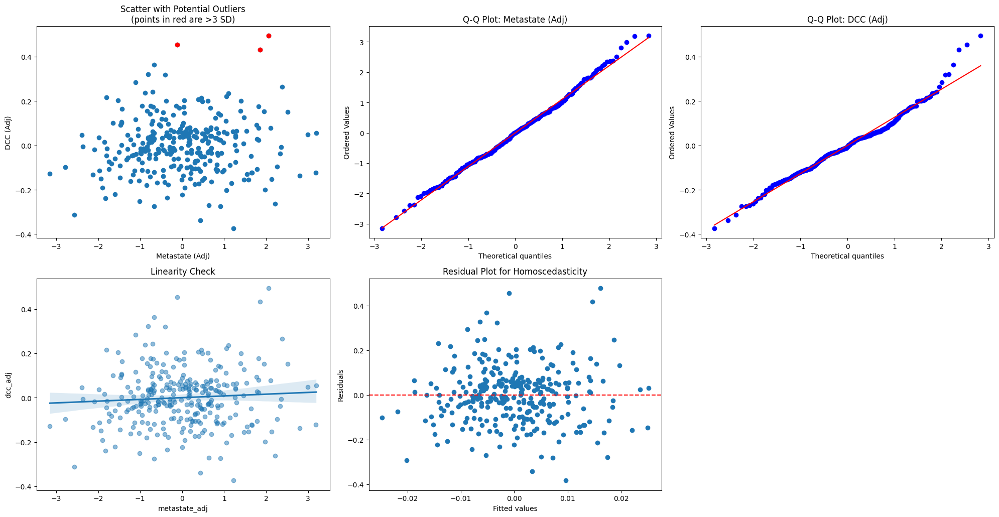


Checking assumptions for GSR preprocessing:

1. Missing Values Check:
Metastate missing: 0
DCC missing: 0

2. Outlier Detection:
Points >3 SD from mean:
Metastate: 0 (0.0%)
DCC: 6 (1.6%)

3. Normality Tests (Shapiro-Wilk):
Metastate: W=0.995, p=2.209e-01
DCC: W=0.966, p=1.007e-07

4. Linearity Check (RESET test):
F-statistic=0.929, p=3.356e-01

5. Homoscedasticity (Breusch-Pagan test):
LM stat=0.455, p=5.001e-01

6. Correlation Results:
           n         r          CI95%     p-val   BF10    power
pearson  384 -0.066796  [-0.17, 0.03]  0.191514  0.149  0.25746


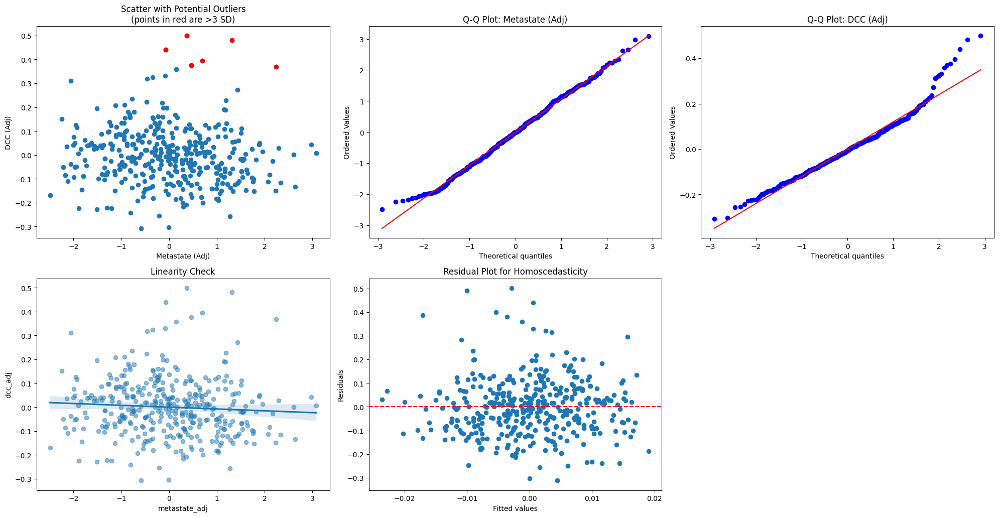


Results for CompCor:

Motion Correlations for compcor:
FD_diff vs metastate_change: r = 0.244, p = 1.808e-05
FD_diff vs dcc_change: r = -0.436, p = 2.099e-15
ts_fd_diff vs metastate_change: r = 0.278, p = 9.165e-07
ts_fd_diff vs dcc_change: r = -0.956, p = 9.497e-162

Mixed Model Summary:
           Mixed Linear Model Regression Results
Model:              MixedLM  Dependent Variable:  dcc_change
No. Observations:   301      Method:              REML      
No. Groups:         7        Scale:               0.0062    
Min. group size:    15       Log-Likelihood:      208.4072  
Max. group size:    78       Converged:           Yes       
Mean group size:    43.0                                    
------------------------------------------------------------
                 Coef.  Std.Err.    z    P>|z| [0.025 0.975]
------------------------------------------------------------
Intercept        -0.018    0.026  -0.697 0.486 -0.068  0.032
metastate_change  0.001    0.006   0.224 0.823 -0.

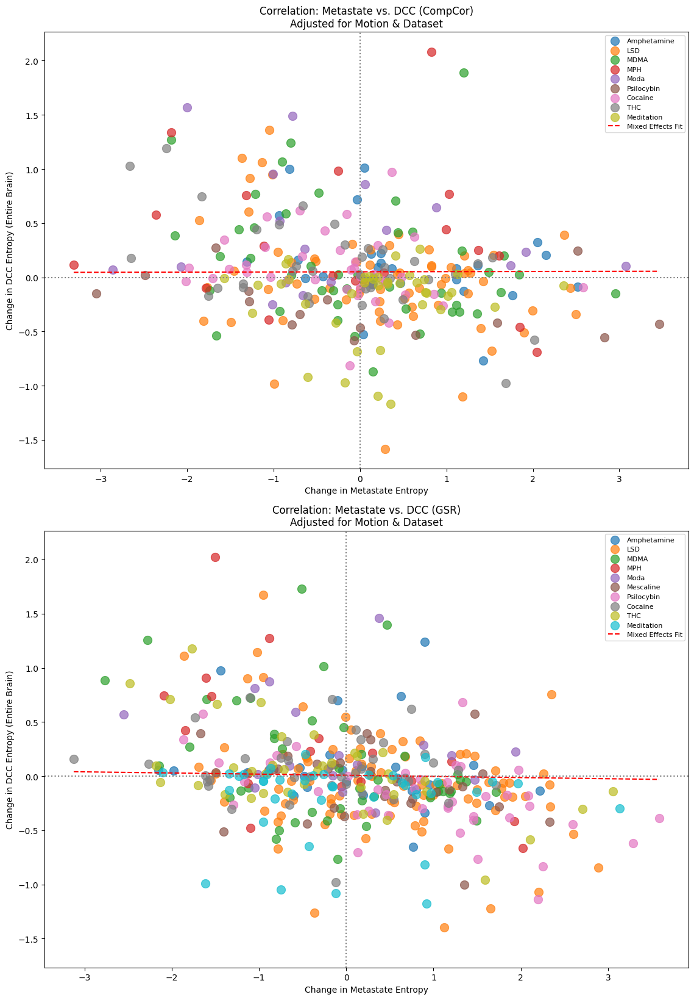


CompCor Model Results:
Coefficient for Metastate Change: β = 0.001
Pearson Correlation: r = 0.086, p = 1.388e-01
Spearman Correlation: ρ = 0.072, p = 2.145e-01

Partial Correlation Results:
           n         r          CI95%    p-val
pearson  301 -0.000207  [-0.11, 0.11]  0.99715

GSR Model Results:
Coefficient for Metastate Change: β = -0.011
Pearson Correlation: r = 0.168, p = 9.172e-04
Spearman Correlation: ρ = 0.109, p = 3.301e-02

Partial Correlation Results:
           n         r           CI95%     p-val
pearson  384 -0.152239  [-0.25, -0.05]  0.002853

Comparison of Results:
CompCor Mixed Effects Coefficient for Metastate Change: β = 0.001
GSR Mixed Effects Coefficient for Metastate Change: β = -0.011


In [20]:
# Main Analysis

# 1) Filter your DataFrame for required columns:
df_clean = df_winsorized_scaled.dropna(subset=[
    'entropy_metastate', 'dcc_entropy_entire_brain',
    'FD_mean', 'proportion_ts_fd'
])

# 2) Calculate changes
entropy_changes = calculate_entropy_changes(df_clean)

# 3) Run the assumption checks for each method (CompCor & GSR)
for method in ['compcor', 'gsr']:
    print(f"\n{'='*50}")
    print(f"Checking assumptions for {method.upper()} preprocessing:")
    print(f"{'='*50}")
    df_method = entropy_changes[entropy_changes['conreg'] == method].copy()
    results = check_correlation_assumptions(df_method)
    # results dict will have outlier info, normality, correlation, etc.

# 4) Analyze correlation with the mixed model
print("\nResults for CompCor:")
results_compcor = analyze_correlation_with_motion(entropy_changes, 'compcor')

print("\nResults for GSR:")
results_gsr = analyze_correlation_with_motion(entropy_changes, 'gsr')

# 5) If you want to replicate the final combined plot, 
#    just rename the variables from lzc_change, pl_change
#    to metastate_change, dcc_change in your final figure code.
#    For example:
if results_compcor and results_gsr:
    import numpy as np
    import matplotlib.pyplot as plt
    
    fig, axes = plt.subplots(2, 1, figsize=(11.5, 16.5), sharey=True)
    
    for ax, results, title in zip(axes, [results_compcor, results_gsr], ['CompCor', 'GSR']):
        df_method = results['df_method']
        
        # Plot individual points by task
        for task in df_method['task'].unique():
            task_data = df_method[df_method['task'] == task]
            ax.scatter(
                task_data['metastate_change'], 
                task_data['dcc_change'],   
                # pick some color map or use a dict if you have one
                alpha=0.7,
                s=100,
                label=task
            )
        
        # Add regression line from the mixed model
        x_range = np.linspace(df_method['metastate_change'].min(), df_method['metastate_change'].max(), 100)
        # We'll predict using the model's parameters:
        y_pred = (results['model'].params['Intercept'] + 
                  results['model'].params['metastate_change']*x_range +
                  results['model'].params['FD_diff']*df_method['FD_diff'].mean() +
                  results['model'].params['ts_fd_diff']*df_method['ts_fd_diff'].mean())
        ax.plot(x_range, y_pred, 'r--', label='Mixed Effects Fit')
        
        # Reference lines
        ax.axhline(y=0, color='gray', linestyle=':')
        ax.axvline(x=0, color='gray', linestyle=':')
        
        # Labels
        ax.set_title(f'Correlation: Metastate vs. DCC ({title})\nAdjusted for Motion & Dataset',
                     fontsize=12)
        ax.set_xlabel('Change in Metastate Entropy', fontsize=10)
        ax.set_ylabel('Change in DCC Entropy (Entire Brain)', fontsize=10)
        
        # Legend
        ax.legend(loc='best', fontsize=8)
    
    plt.tight_layout()
    plt.show()


# 6) Print final summaries
if results_compcor:
    print("\nCompCor Model Results:")
    print(f"Coefficient for Metastate Change: β = {results_compcor['coefficient']:.3f}")
    print(f"Pearson Correlation: r = {results_compcor['pearson_r'][0]:.3f}, p = {results_compcor['pearson_r'][1]:.3e}")
    print(f"Spearman Correlation: ρ = {results_compcor['spearman_r'][0]:.3f}, p = {results_compcor['spearman_r'][1]:.3e}")
    print("\nPartial Correlation Results:")
    print(results_compcor['partial_corr'])

if results_gsr:
    print("\nGSR Model Results:")
    print(f"Coefficient for Metastate Change: β = {results_gsr['coefficient']:.3f}")
    print(f"Pearson Correlation: r = {results_gsr['pearson_r'][0]:.3f}, p = {results_gsr['pearson_r'][1]:.3e}")
    print(f"Spearman Correlation: ρ = {results_gsr['spearman_r'][0]:.3f}, p = {results_gsr['spearman_r'][1]:.3e}")
    print("\nPartial Correlation Results:")
    print(results_gsr['partial_corr'])

if results_compcor and results_gsr:
    print("\nComparison of Results:")
    print(f"CompCor Mixed Effects Coefficient for Metastate Change: β = {results_compcor['coefficient']:.3f}")
    print(f"GSR Mixed Effects Coefficient for Metastate Change: β = {results_gsr['coefficient']:.3f}")

### Assess motion confound (LMM) 

DCC change transformed (rank-inverse-normal).


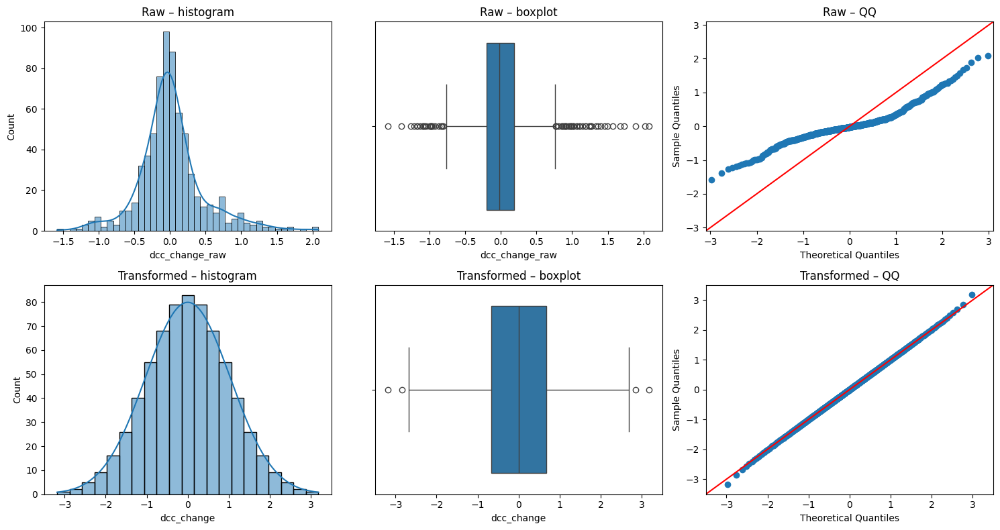

Raw        : n= 685, mean= 0.020, sd= 0.461, skew= 0.732, kurtosis= 2.748
Transformed: n= 685, mean= 0.000, sd= 1.000, skew= 0.000, kurtosis=-0.038


In [ ]:

from scipy.stats import rankdata, norm, skew, kurtosis
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt

def rin(series):
    r = rankdata(series, method="average")
    return norm.ppf((r - 0.5) / len(r))

# 1) store raw values if we haven't done so yet
if "dcc_change_raw" not in entropy_changes.columns:
    entropy_changes["dcc_change_raw"] = entropy_changes["dcc_change"]

# 2) overwrite dcc_change with RIN-scores
entropy_changes["dcc_change"] = rin(entropy_changes["dcc_change_raw"])
print("DCC change transformed (rank-inverse-normal).")

# 3) quick distribution visualisation
fig, ax = plt.subplots(2, 3, figsize=(15, 8))
for row, colname, label in [(0, "dcc_change_raw", "Raw"),
                            (1, "dcc_change",      "Transformed")]:
    sns.histplot(entropy_changes[colname].dropna(), kde=True, ax=ax[row,0])
    ax[row,0].set_title(f"{label} – histogram")
    
    sns.boxplot(x=entropy_changes[colname], ax=ax[row,1])
    ax[row,1].set_title(f"{label} – boxplot")
    
    sm.qqplot(entropy_changes[colname].dropna(), line="45", ax=ax[row,2])
    ax[row,2].set_title(f"{label} – QQ")

plt.tight_layout()
plt.show()

for label, col in [("Raw", "dcc_change_raw"), ("Transformed", "dcc_change")]:
    s = entropy_changes[col].dropna()
    print(f"{label:11s}: n={len(s):>4}, mean={s.mean(): .3f}, "
          f"sd={s.std(): .3f}, skew={skew(s): .3f}, kurtosis={kurtosis(s): .3f}")


Outlier Removal Summary:
Total observations: 720
Observations removed: 35 (4.9%)
Remaining observations: 685

Outliers removed by task:
task
Ganzfeld      32
Moda           1
Psilocybin     1
THC            1
dtype: int64
DCC change transformed (rank-inverse-normal).

ANALYZING COMPCOR DATA

Analyzing motion influence for COMPCOR preprocessing:

1. Direct correlations between motion and entropy:
FD_diff vs metastate_change:
  Pearson: r = 0.244, p = 1.808e-05
  Spearman: ρ = 0.244, p = 1.853e-05
FD_diff vs dcc_change:
  Pearson: r = -0.461, p = 3.167e-17
  Spearman: ρ = -0.476, p = 2.085e-18
ts_fd_diff vs metastate_change:
  Pearson: r = 0.278, p = 9.165e-07
  Spearman: ρ = 0.251, p = 1.079e-05
ts_fd_diff vs dcc_change:
  Pearson: r = -0.928, p = 1.835e-130
  Spearman: ρ = -0.919, p = 8.945e-123
FD_mean vs metastate_change:
  Pearson: r = 0.151, p = 8.568e-03
  Spearman: ρ = 0.136, p = 1.831e-02
FD_mean vs dcc_change:
  Pearson: r = -0.338, p = 1.677e-09
  Spearman: ρ = -0.264, p = 3.

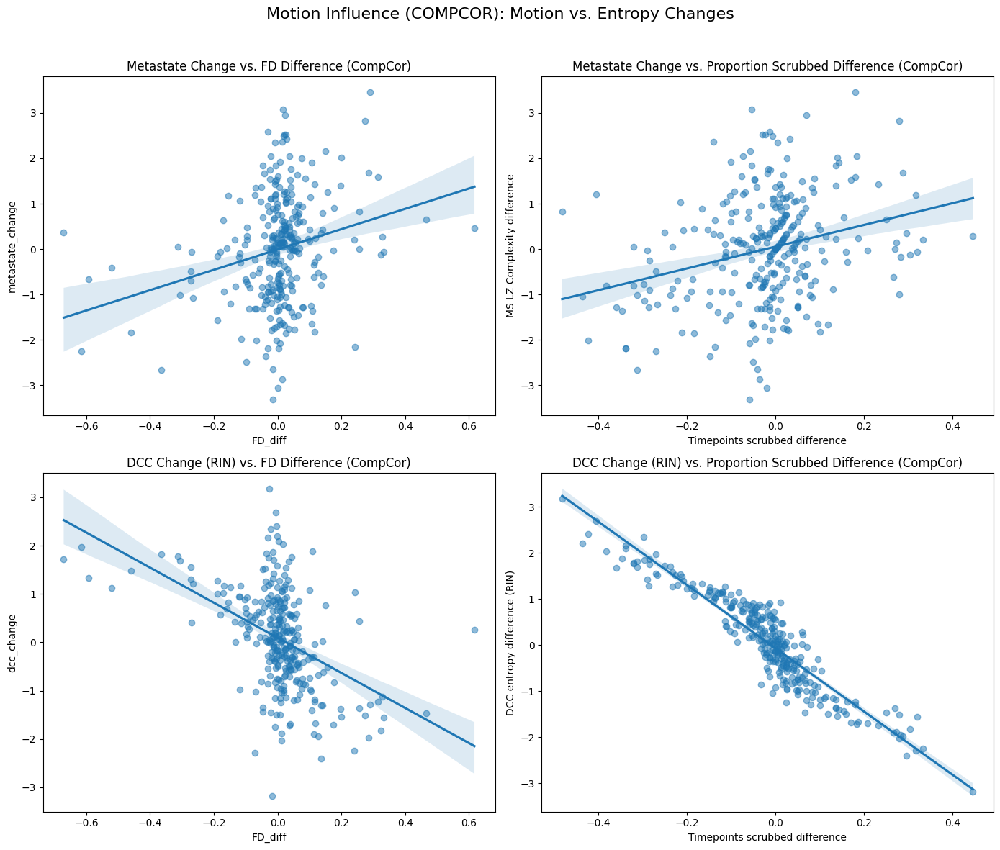


SUMMARY OF MOTION INFLUENCE ON ENTROPY METRICS (COMPCOR)

1. DIRECT CORRELATIONS BETWEEN MOTION AND ENTROPY:
FD_diff vs metastate_change:
  Pearson: r = 0.244***, p = 1.808e-05
  Spearman: ρ = 0.244***, p = 1.853e-05
FD_diff vs dcc_change:
  Pearson: r = -0.461***, p = 3.167e-17
  Spearman: ρ = -0.476***, p = 2.085e-18
ts_fd_diff vs metastate_change:
  Pearson: r = 0.278***, p = 9.165e-07
  Spearman: ρ = 0.251***, p = 1.079e-05
ts_fd_diff vs dcc_change:
  Pearson: r = -0.928***, p = 1.835e-130
  Spearman: ρ = -0.919***, p = 8.945e-123
FD_mean vs metastate_change:
  Pearson: r = 0.151**, p = 8.568e-03
  Spearman: ρ = 0.136*, p = 1.831e-02
FD_mean vs dcc_change:
  Pearson: r = -0.338***, p = 1.677e-09
  Spearman: ρ = -0.264***, p = 3.565e-06
proportion_ts_fd vs metastate_change:
  Pearson: r = 0.090, p = 1.197e-01
  Spearman: ρ = 0.074, p = 1.979e-01
proportion_ts_fd vs dcc_change:
  Pearson: r = -0.434***, p = 2.770e-15
  Spearman: ρ = -0.307***, p = 5.402e-08

2. VARIANCE EXPLAINED BY

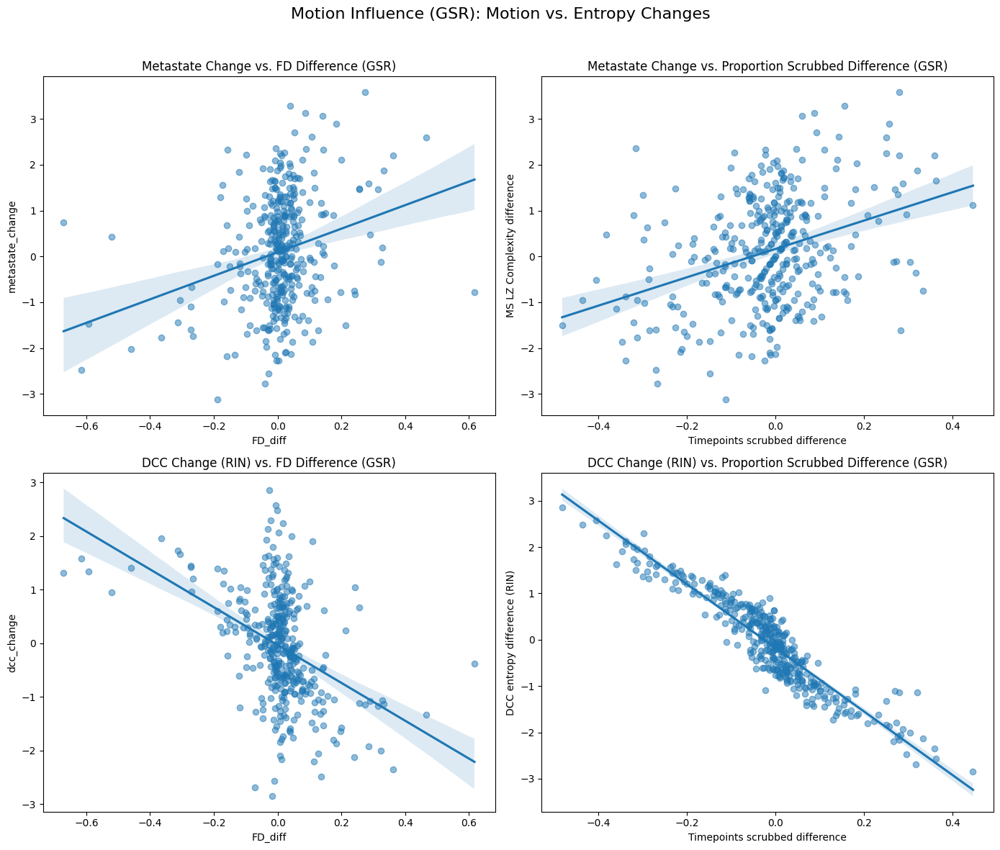


SUMMARY OF MOTION INFLUENCE ON ENTROPY METRICS (GSR)

1. DIRECT CORRELATIONS BETWEEN MOTION AND ENTROPY:
FD_diff vs metastate_change:
  Pearson: r = 0.258***, p = 2.844e-07
  Spearman: ρ = 0.217***, p = 1.737e-05
FD_diff vs dcc_change:
  Pearson: r = -0.428***, p = 1.638e-18
  Spearman: ρ = -0.422***, p = 4.899e-18
ts_fd_diff vs metastate_change:
  Pearson: r = 0.349***, p = 2.004e-12
  Spearman: ρ = 0.297***, p = 3.008e-09
ts_fd_diff vs dcc_change:
  Pearson: r = -0.933***, p = 1.186e-171
  Spearman: ρ = -0.923***, p = 2.768e-160
FD_mean vs metastate_change:
  Pearson: r = 0.115*, p = 2.375e-02
  Spearman: ρ = 0.083, p = 1.063e-01
FD_mean vs dcc_change:
  Pearson: r = -0.324***, p = 8.226e-11
  Spearman: ρ = -0.251***, p = 6.099e-07
proportion_ts_fd vs metastate_change:
  Pearson: r = 0.125*, p = 1.418e-02
  Spearman: ρ = 0.081, p = 1.109e-01
proportion_ts_fd vs dcc_change:
  Pearson: r = -0.478***, p = 2.388e-23
  Spearman: ρ = -0.371***, p = 5.535e-14

2. VARIANCE EXPLAINED BY MOTI

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
import pingouin as pg
import warnings

def analyze_motion_influence(df, conreg_method=None):
    """
    Analyze the influence of motion metrics on entropy changes.
    
    Parameters:
    -----------
    df : pandas DataFrame
        DataFrame with entropy and motion metrics
    conreg_method : str, optional
        If provided, filters data to a specific confound regression method ('compcor' or 'gsr')
        
    Returns:
    --------
    dict : Results of motion influence analysis
    """
    # Filter by confound regression method if specified
    if conreg_method:
        df_analysis = df[df['conreg'] == conreg_method].copy()
        print(f"\nAnalyzing motion influence for {conreg_method.upper()} preprocessing:")
    else:
        df_analysis = df.copy()
        print("\nAnalyzing motion influence across all preprocessing methods:")
    
    results = {}
    
    # 1. Direct correlation analysis
    print("\n1. Direct correlations between motion and entropy:")
    correlation_results = []
    
    for motion_var in ['FD_diff', 'ts_fd_diff', 'FD_mean', 'proportion_ts_fd']:
        for entropy_var in ['metastate_change', 'dcc_change']:
            corr = stats.pearsonr(df_analysis[motion_var], df_analysis[entropy_var])
            spearman = stats.spearmanr(df_analysis[motion_var], df_analysis[entropy_var])
            
            correlation_results.append({
                'motion_metric': motion_var,
                'entropy_metric': entropy_var,
                'pearson_r': corr[0],
                'pearson_p': corr[1],
                'spearman_rho': spearman[0],
                'spearman_p': spearman[1]
            })
            
            print(f"{motion_var} vs {entropy_var}:")
            print(f"  Pearson: r = {corr[0]:.3f}, p = {corr[1]:.3e}")
            print(f"  Spearman: ρ = {spearman[0]:.3f}, p = {spearman[1]:.3e}")
    
    results['correlations'] = pd.DataFrame(correlation_results)
    
    # 2. Mixed model analysis accounting for dataset and subject
    print("\n2. Mixed models for motion influence:")
    
    # Metastate model
    try:
        with warnings.catch_warnings(record=True) as w:
            metastate_model = smf.mixedlm(
                formula="metastate_change ~ FD_diff + ts_fd_diff",
                data=df_analysis,
                groups="dataset",
                re_formula="~1",
                vc_formula={"subject": "0 + C(unique_subject)"}
            ).fit(reml=True, method='bfgs')
        
        print("\nMixed Model for Metastate Change:")
        print(metastate_model.summary().tables[1])  # Just the coefficients table
        results['metastate_model'] = metastate_model
    except Exception as e:
        print(f"Error in metastate model: {str(e)}")
        results['metastate_model'] = None
    
    # DCC model
    try:
        with warnings.catch_warnings(record=True) as w:
            dcc_model = smf.mixedlm(
                formula="dcc_change ~ FD_diff + ts_fd_diff",
                data=df_analysis,
                groups="dataset",
                re_formula="~1",
                vc_formula={"subject": "0 + C(unique_subject)"}
            ).fit(reml=True, method='bfgs')
        
        print("\nMixed Model for DCC Change:")
        print(dcc_model.summary().tables[1])  # Just the coefficients table
        results['dcc_model'] = dcc_model
    except Exception as e:
        print(f"Error in DCC model: {str(e)}")
        results['dcc_model'] = None
    
    # 3. Variance explained by motion
    print("\n3. Variance explained by motion:")
    
    # Simple linear models to estimate R² for motion metrics
    meta_motion_model = sm.OLS.from_formula("metastate_change ~ FD_diff + ts_fd_diff", data=df_analysis).fit()
    dcc_motion_model = sm.OLS.from_formula("dcc_change ~ FD_diff + ts_fd_diff", data=df_analysis).fit()
    
    print(f"Metastate change variance explained by motion (R²): {meta_motion_model.rsquared:.3f}")
    print(f"DCC change variance explained by motion (R²): {dcc_motion_model.rsquared:.3f}")
    
    results['variance_explained'] = {
        'metastate': meta_motion_model.rsquared,
        'dcc': dcc_motion_model.rsquared
    }
    
    # 4. Task-specific motion influence
    print("\n4. Task-specific motion influence:")
    
    # First check if there are multiple tasks
    tasks = df_analysis['task'].unique()
    if len(tasks) > 1:
        task_results = []
        
        for task in tasks:
            task_data = df_analysis[df_analysis['task'] == task]
            
            # Skip tasks with too few data points
            if len(task_data) < 10:
                print(f"Skipping task {task} (insufficient data: n={len(task_data)})")
                continue
            
            # Calculate correlations by task
            for motion_var in ['FD_diff', 'ts_fd_diff']:
                for entropy_var in ['metastate_change', 'dcc_change']:
                    corr = stats.pearsonr(task_data[motion_var], task_data[entropy_var])
                    
                    task_results.append({
                        'task': task,
                        'motion_metric': motion_var,
                        'entropy_metric': entropy_var,
                        'pearson_r': corr[0],
                        'pearson_p': corr[1],
                        'n': len(task_data)
                    })
        
        task_df = pd.DataFrame(task_results)
        print(task_df)
        results['task_specific'] = task_df
    else:
        print("Only one task found. Skipping task-specific analysis.")
    
    return results

def visualize_motion_influence(df, results, conreg_method=None):
    """
    Visualize the relationship between motion metrics and entropy changes.
    
    Parameters:
    -----------
    df : pandas DataFrame
        DataFrame with entropy and motion metrics
    results : dict
        Results from analyze_motion_influence function
    conreg_method : str, optional
        If provided, filters data to a specific confound regression method
    """

    # -- choose suffix ----------------------------------------------------
    if conreg_method is None:
        suffix = ""
    else:
        # keep the exact capitalisation you asked for
        suffix = f" ({'GSR' if conreg_method.lower()=='gsr' else 'CompCor'})"


    # Filter by confound regression method if specified
    if conreg_method:
        df_vis = df[df['conreg'] == conreg_method].copy()
        title_prefix = f"Motion Influence ({conreg_method.upper()})"
    else:
        df_vis = df.copy()
        title_prefix = "Motion Influence (All Methods)"
    
    # 1. Correlation scatterplots
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))
    fig.suptitle(f"{title_prefix}: Motion vs. Entropy Changes", fontsize=16)
    
    # Metastate vs FD_diff
    ax = axes[0, 0]
    sns.regplot(x='FD_diff', y='metastate_change', data=df_vis, ax=ax, scatter_kws={'alpha': 0.5})
    r, p = stats.pearsonr(df_vis['FD_diff'], df_vis['metastate_change'])
    #ax.set_title(f"Metastate Change vs. FD Difference{suffix}\nr = {r:.3f}, p = {p:.3e}")
    ax.set_title(f"Metastate Change vs. FD Difference{suffix}")
    
    # Metastate vs ts_fd_diff
    ax = axes[0, 1]
    sns.regplot(x='ts_fd_diff', y='metastate_change', data=df_vis, ax=ax, scatter_kws={'alpha': 0.5})
    # change axis labels
    ax.set_xlabel("Timepoints scrubbed difference")
    ax.set_ylabel("MS LZ Complexity difference")
    r, p = stats.pearsonr(df_vis['ts_fd_diff'], df_vis['metastate_change'])
    #ax.set_title(f"Metastate Change vs. Proportion Scrubbed Difference{suffix}\nr = {r:.3f}, p = {p:.3e}")
    ax.set_title(f"Metastate Change vs. Proportion Scrubbed Difference{suffix}")
    
    # DCC vs FD_diff
    ax = axes[1, 0]
    sns.regplot(x='FD_diff', y='dcc_change', data=df_vis, ax=ax, scatter_kws={'alpha': 0.5})
    r, p = stats.pearsonr(df_vis['FD_diff'], df_vis['dcc_change'])
    #ax.set_title(f"DCC Change (RIN) vs. FD Difference{suffix}\nr = {r:.3f}, p = {p:.3e}")
    ax.set_title(f"DCC Change (RIN) vs. FD Difference{suffix}")

    # DCC vs ts_fd_diff
    ax = axes[1, 1]
    sns.regplot(x='ts_fd_diff', y='dcc_change', data=df_vis, ax=ax, scatter_kws={'alpha': 0.5})
    ax.set_xlabel("Timepoints scrubbed difference")   # new x‑label
    ax.set_ylabel("DCC entropy difference (RIN)")           # new y‑label
    r, p = stats.pearsonr(df_vis['ts_fd_diff'], df_vis['dcc_change'])
    #ax.set_title(f"DCC Change (RIN) vs. Proportion Scrubbed Difference{suffix}\nr = {r:.3f}, p = {p:.3e}")
    ax.set_title(f"DCC Change (RIN) vs. Proportion Scrubbed Difference{suffix}")

    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust for suptitle
    plt.show()
    


def summarize_motion_influence(results, conreg_method=None):
    """
    Provide a comprehensive summary of motion influence on entropy metrics.
    
    Parameters:
    -----------
    results : dict
        Results from analyze_motion_influence function
    conreg_method : str, optional
        Label for the confound regression method
    """
    method_label = conreg_method.upper() if conreg_method else "All Methods"
    
    print(f"\n{'='*70}")
    print(f"SUMMARY OF MOTION INFLUENCE ON ENTROPY METRICS ({method_label})")
    print(f"{'='*70}")
    
    # 1. Direct correlations
    print("\n1. DIRECT CORRELATIONS BETWEEN MOTION AND ENTROPY:")
    if 'correlations' in results:
        # Format as a neat table
        corr_table = results['correlations'].copy()
        
        # Add significance indicators
        corr_table['pearson_sig'] = ['***' if p < 0.001 else '**' if p < 0.01 else '*' if p < 0.05 else '' 
                                   for p in corr_table['pearson_p']]
        corr_table['spearman_sig'] = ['***' if p < 0.001 else '**' if p < 0.01 else '*' if p < 0.05 else '' 
                                    for p in corr_table['spearman_p']]
        
        # Create formatted output
        for _, row in corr_table.iterrows():
            print(f"{row['motion_metric']} vs {row['entropy_metric']}:")
            print(f"  Pearson: r = {row['pearson_r']:.3f}{row['pearson_sig']}, p = {row['pearson_p']:.3e}")
            print(f"  Spearman: ρ = {row['spearman_rho']:.3f}{row['spearman_sig']}, p = {row['spearman_p']:.3e}")
    
    # 2. Variance explained
    print("\n2. VARIANCE EXPLAINED BY MOTION:")
    if 'variance_explained' in results:
        meta_r2 = results['variance_explained']['metastate']
        dcc_r2 = results['variance_explained']['dcc']
        
        print(f"Metastate change variance explained by motion (R²): {meta_r2:.3f} ({meta_r2*100:.1f}%)")
        print(f"DCC change variance explained by motion (R²): {dcc_r2:.3f} ({dcc_r2*100:.1f}%)")
    
    # 3. Mixed model coefficients
    print("\n3. MIXED MODEL COEFFICIENTS:")
    if results.get('metastate_model'):
        print("\nMetastate Change Model:")
        coefs = results['metastate_model'].params
        pvalues = results['metastate_model'].pvalues
        
        for param in ['FD_diff', 'ts_fd_diff']:
            if param in coefs:
                sig = '***' if pvalues[param] < 0.001 else '**' if pvalues[param] < 0.01 else '*' if pvalues[param] < 0.05 else ''
                print(f"  {param}: β = {coefs[param]:.3f}{sig}, p = {pvalues[param]:.3e}")
    
    if results.get('dcc_model'):
        print("\nDCC Change Model:")
        coefs = results['dcc_model'].params
        pvalues = results['dcc_model'].pvalues
        
        for param in ['FD_diff', 'ts_fd_diff']:
            if param in coefs:
                sig = '***' if pvalues[param] < 0.001 else '**' if pvalues[param] < 0.01 else '*' if pvalues[param] < 0.05 else ''
                print(f"  {param}: β = {coefs[param]:.3f}{sig}, p = {pvalues[param]:.3e}")
    
    
    # 5. Interpretation
    print("\n5. INTERPRETATION:")
    
    # Interpret based on results
    meta_motion_influenced = False
    dcc_motion_influenced = False
    
    if 'variance_explained' in results:
        meta_r2 = results['variance_explained']['metastate']
        dcc_r2 = results['variance_explained']['dcc']
        
        if meta_r2 > 0.05:  # 5% variance explained threshold
            meta_motion_influenced = True
        
        if dcc_r2 > 0.05:  # 5% variance explained threshold
            dcc_motion_influenced = True
    
    # Overall interpretation
    if meta_motion_influenced and dcc_motion_influenced:
        print("BOTH entropy metrics show substantial influence from motion.")
    elif meta_motion_influenced:
        print("Metastate entropy shows substantial influence from motion, while DCC entropy appears less affected.")
    elif dcc_motion_influenced:
        print("DCC entropy shows substantial influence from motion, while Metastate entropy appears less affected.")
    else:
        print("NEITHER entropy metric shows substantial influence from motion, suggesting robust findings.")
    

def run_motion_influence_analysis(entropy_changes_df):
    """
    Run the complete motion influence analysis pipeline.
    
    Parameters:
    -----------
    entropy_changes_df : pandas DataFrame
        DataFrame with entropy changes (output from calculate_entropy_changes function)
    """
    # Analyze CompCor data
    print("\n" + "="*80)
    print("ANALYZING COMPCOR DATA")
    print("="*80)
    compcor_results = analyze_motion_influence(entropy_changes_df, 'compcor')
    visualize_motion_influence(entropy_changes_df, compcor_results, 'compcor')
    summarize_motion_influence(compcor_results, 'compcor')
    
    # Analyze GSR data
    print("\n" + "="*80)
    print("ANALYZING GSR DATA")
    print("="*80)
    gsr_results = analyze_motion_influence(entropy_changes_df, 'gsr')
    visualize_motion_influence(entropy_changes_df, gsr_results, 'gsr')
    summarize_motion_influence(gsr_results, 'gsr')
    
    return {
        'compcor': compcor_results,
        'gsr': gsr_results
    }



df_clean = df_winsorized_scaled.dropna(subset=[
   'entropy_metastate', 'dcc_entropy_entire_brain',
   'FD_mean', 'proportion_ts_fd'
])
entropy_changes = calculate_entropy_changes(df_clean)


## ---- transform DCC change to RIN scores ---- ##
from scipy.stats import rankdata, norm

entropy_changes["dcc_change_raw"] = entropy_changes["dcc_change"]   # keep original
entropy_changes["dcc_change"] = norm.ppf(
    (rankdata(entropy_changes["dcc_change_raw"], method="average") - 0.5)
    / len(entropy_changes)
)
print("DCC change transformed (rank-inverse-normal).")


# Run the motion influence analysis
results_just_motion = run_motion_influence_analysis(entropy_changes)


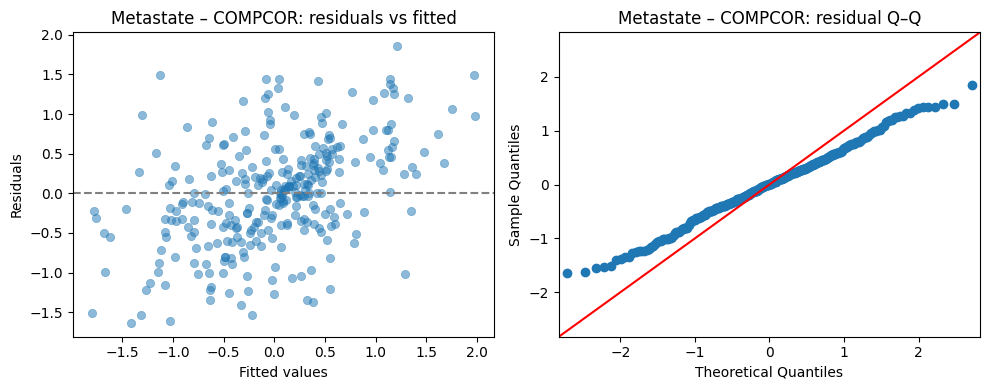

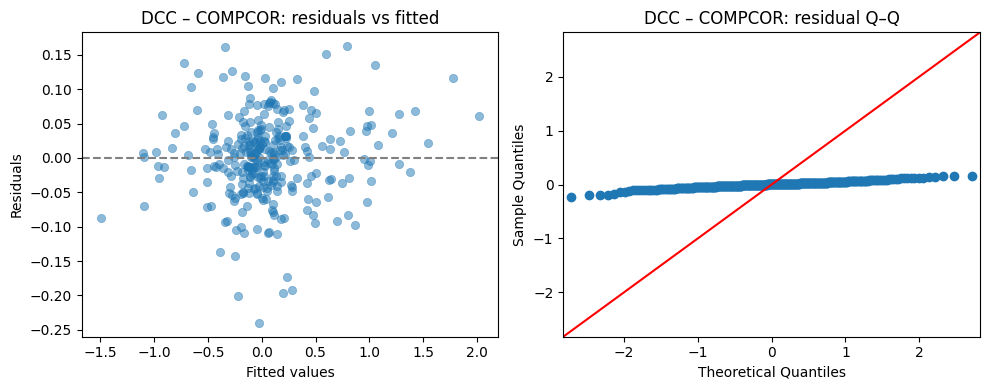

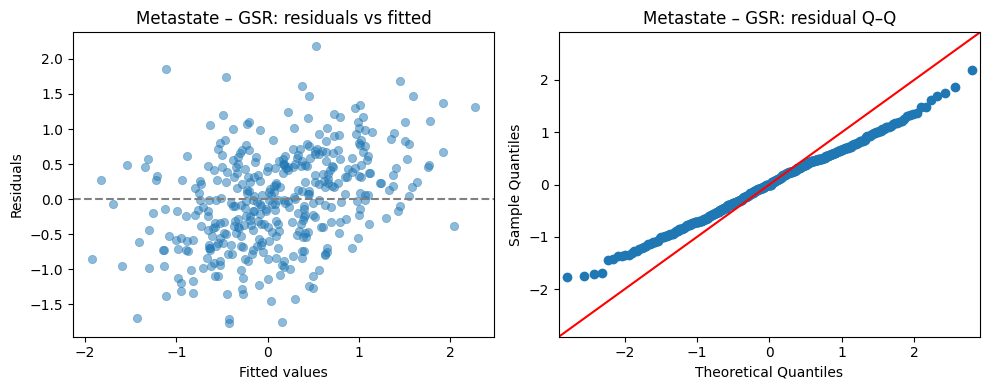

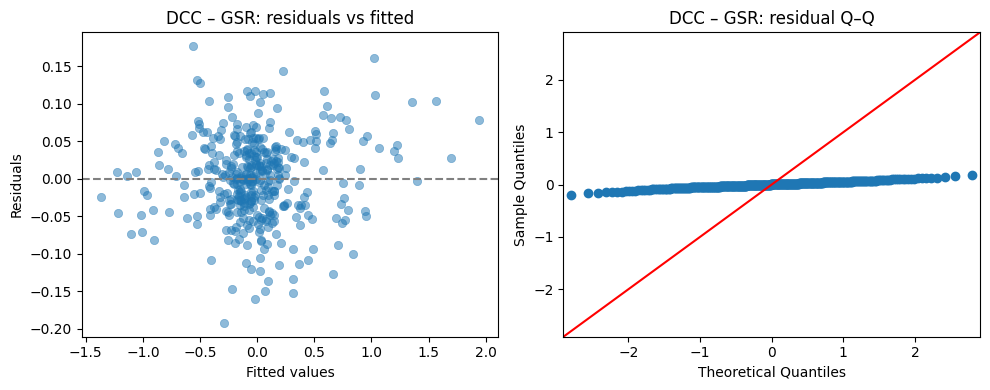

In [ ]:
# check residual diagnostics for the models

import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import numpy as np

def plot_lmm_diagnostics(model, title="model"):
    """
    Residual-vs-fitted scatter and Q–Q plot for a statsmodels MixedLMResults.
    Skips silently if `model` is None.
    """
    if model is None:
        print(f"{title}: model is None – skipped.")
        return
    
    resid  = model.resid
    fitted = model.fittedvalues

    fig, ax = plt.subplots(1, 2, figsize=(10, 4))

    # 1) residuals vs fitted
    sns.scatterplot(x=fitted, y=resid, ax=ax[0], alpha=0.5, edgecolor=None)
    ax[0].axhline(0, ls="--", c="grey")
    ax[0].set_xlabel("Fitted values")
    ax[0].set_ylabel("Residuals")
    ax[0].set_title(f"{title}: residuals vs fitted")

    # 2) Q-Q plot of residuals
    sm.qqplot(resid, line="45", ax=ax[1])
    ax[1].set_title(f"{title}: residual Q–Q")

    plt.tight_layout()
    plt.show()

# ─── Run diagnostics for every model we have ──────────────────────────────────
# Works with your `results_just_motion` dict; falls back to globals if needed.
if "results_just_motion" in globals():           # → pipeline output dict exists
    for method_name, res in results_just_motion.items():
        plot_lmm_diagnostics(res.get("metastate_model"),
                             f"Metastate – {method_name.upper()}")
        plot_lmm_diagnostics(res.get("dcc_model"),
                             f"DCC – {method_name.upper()}")
else:                                            # → use standalone models if defined
    plot_lmm_diagnostics(globals().get("metastate_model"), "Metastate")
    plot_lmm_diagnostics(globals().get("dcc_model"),       "DCC")

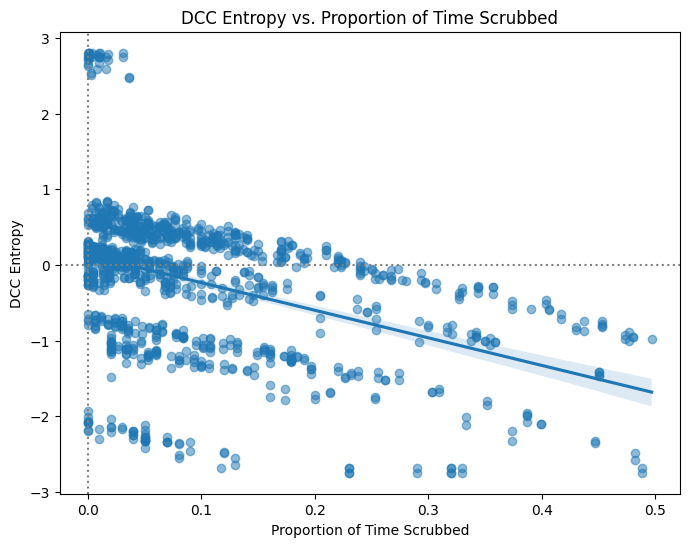

In [202]:
# plot proportion_ts_fd against dcc_entropy_entire_brain

plt.figure(figsize=(8, 6))
sns.regplot(x='proportion_ts_fd', y='dcc_entropy_entire_brain', data=df_clean, scatter_kws={'alpha': 0.5})
plt.title('DCC Entropy vs. Proportion of Time Scrubbed')
plt.xlabel('Proportion of Time Scrubbed')
plt.ylabel('DCC Entropy')
plt.axhline(y=0, color='gray', linestyle=':')
plt.axvline(x=0, color='gray', linestyle=':')
plt.savefig('dcc_entropy_vs_proportion_ts_fd.png', dpi=300)
plt.show()


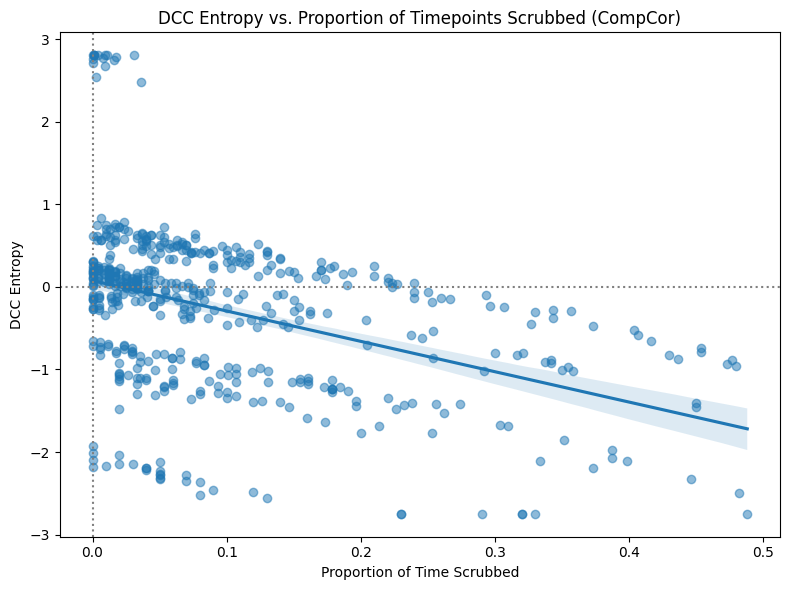

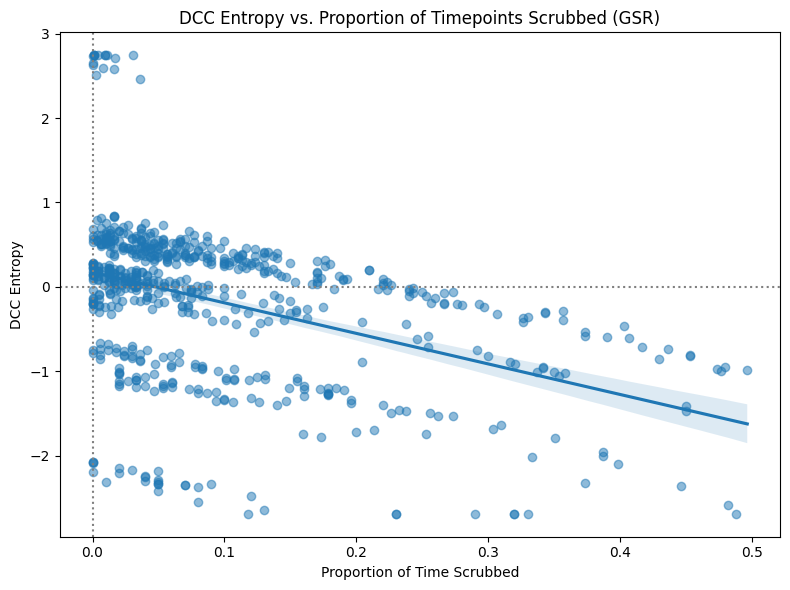

In [ ]:
for method in ["compcor", "gsr"]:
    df_sub = df_clean[df_clean["conreg"] == method]
    if df_sub.empty:
        print(f"No rows for {method}; skipped.")
        continue

    plt.figure(figsize=(8, 6))
    sns.regplot(x="proportion_ts_fd",
                y="dcc_entropy_entire_brain",
                data=df_sub,
                scatter_kws={"alpha": 0.5})

    label = {"compcor": "CompCor", "gsr": "GSR"}[method]
    plt.title(f"DCC Entropy vs. Proportion of Timepoints Scrubbed ({label})")
    plt.xlabel("Proportion of Time Scrubbed")
    plt.ylabel("DCC Entropy")
    plt.axhline(y=0, color="gray", linestyle=":")
    plt.axvline(x=0, color="gray", linestyle=":")
    plt.tight_layout()
    plt.savefig(f"dcc_entropy_vs_proportion_ts_fd_{method}.png", dpi=300)
    plt.show()

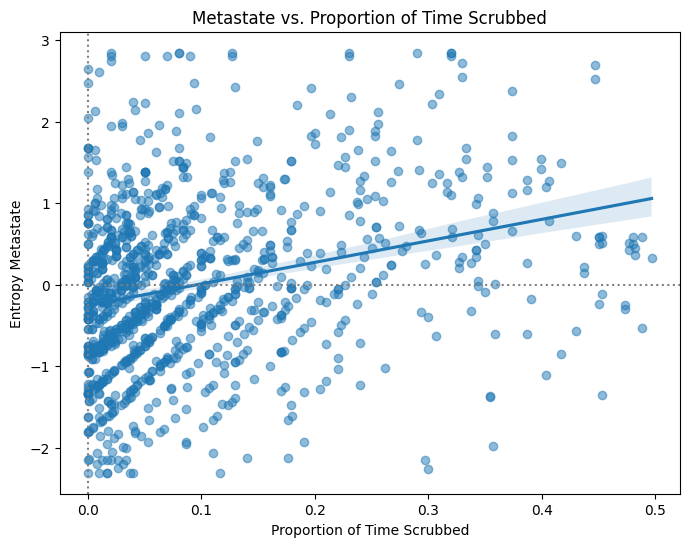

In [203]:
plt.figure(figsize=(8, 6))
sns.regplot(x='proportion_ts_fd', y='entropy_metastate', data=df_clean, scatter_kws={'alpha': 0.5})
plt.title('Metastate vs. Proportion of Time Scrubbed')
plt.xlabel('Proportion of Time Scrubbed')
plt.ylabel('Entropy Metastate')
plt.axhline(y=0, color='gray', linestyle=':')
plt.axvline(x=0, color='gray', linestyle=':')
plt.savefig('metastate_vs_timescrubbed.png', dpi=300)
plt.show()

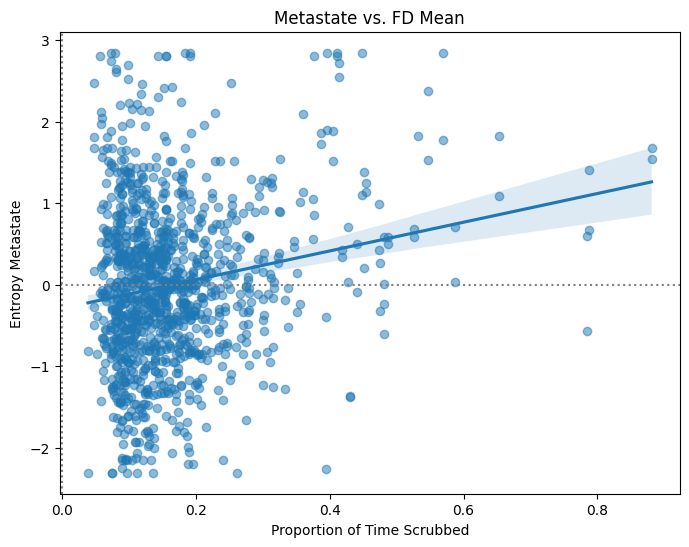

In [205]:
plt.figure(figsize=(8, 6))
sns.regplot(x='FD_mean', y='entropy_metastate', data=df_clean, scatter_kws={'alpha': 0.5})
plt.title('Metastate vs. FD Mean')
plt.xlabel('Proportion of Time Scrubbed')
plt.ylabel('Entropy Metastate')
plt.axhline(y=0, color='gray', linestyle=':')
plt.axvline(x=0, color='gray', linestyle=':')
plt.savefig('metastate_vs_timescrubbed.png', dpi=300)
plt.show()

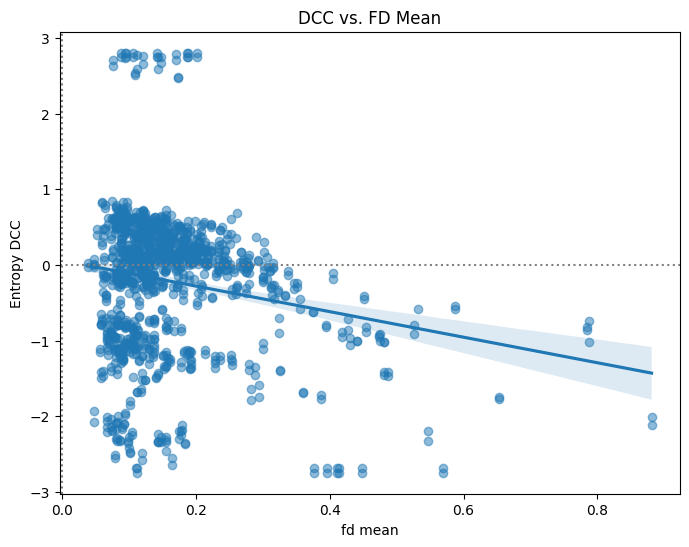

In [207]:
plt.figure(figsize=(8, 6))
sns.regplot(x='FD_mean', y='dcc_entropy_entire_brain', data=df_clean, scatter_kws={'alpha': 0.5})
plt.title('DCC vs. FD Mean')
plt.xlabel('fd mean')
plt.ylabel('Entropy DCC')
plt.axhline(y=0, color='gray', linestyle=':')
plt.axvline(x=0, color='gray', linestyle=':')
plt.savefig('DCC_vs_fd_mean.png', dpi=300)
plt.show()

Correlation matrix:
                  proportion_ts_fd   FD_mean
proportion_ts_fd          1.000000  0.402907
FD_mean                   0.402907  1.000000


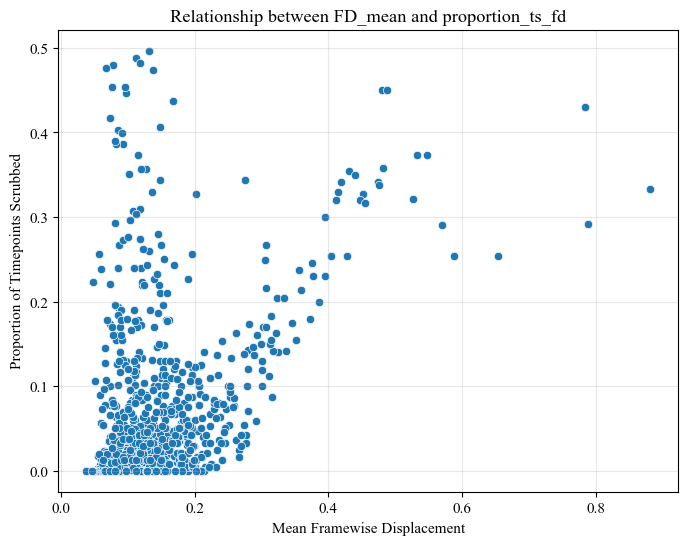


Correlation is below threshold (0.403), multicollinearity may not be a major concern.

If you're including these in a larger model, also check VIF values.
Example: calculate_vif(df, ['proportion_ts_fd', 'FD_mean', 'other_var1', 'other_var2'])


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant


# simple correlation
def check_correlation(df):
    # Calculate Pearson correlation
    correlation = df[['proportion_ts_fd', 'FD_mean']].corr()
    print("Correlation matrix:")
    print(correlation)
    
    # Visualize the correlation
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x='FD_mean', y='proportion_ts_fd', data=df)
    plt.title('Relationship between FD_mean and proportion_ts_fd')
    plt.xlabel('Mean Framewise Displacement')
    plt.ylabel('Proportion of Timepoints Scrubbed')
    plt.grid(True, alpha=0.3)
    plt.show()
    
    return correlation.iloc[0, 1]  # Return the correlation coefficient

# Calculate Variance Inflation Factors (VIF)
def calculate_vif(df, features):
    """
    Calculate VIF for each feature in the dataset.
    VIF > 5-10 indicates problematic multicollinearity.
    """
    X = df[features]
    X = add_constant(X)  # Add constant term for proper VIF calculation
    
    # Calculate VIF for each feature
    vif_data = pd.DataFrame()
    vif_data["Feature"] = X.columns
    vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    
    print("Variance Inflation Factors:")
    print(vif_data)
    
    return vif_data

# Handle multicollinearity
def handle_multicollinearity(df, cor_threshold=0.7, vif_threshold=5):
    """
    Suggestions for handling multicollinearity based on the analysis
    """
    corr = check_correlation(df)
    print("\n" + "="*50)
    
    if abs(corr) > cor_threshold:
        print(f"High correlation detected ({corr:.3f})!")
        print("Suggested approaches:")
        print("1. Use only one of the variables in your model")
        print("   - FD_mean if you're interested in the raw motion metric")
        print("   - proportion_ts_fd if you're interested in the amount of data removed")
        print("2. Create a composite motion variable using PCA")
        print("3. Residualize one variable against the other")
        
        # Example of residualization
        print("\nExample of residualization:")
        print("# Residualize proportion_ts_fd with respect to FD_mean")
        print("from sklearn.linear_model import LinearRegression")
        print("model = LinearRegression()")
        print("X = df[['FD_mean']]")
        print("y = df['proportion_ts_fd']")
        print("model.fit(X, y)")
        print("# Calculate residuals")
        print("df['proportion_ts_fd_resid'] = y - model.predict(X)")
        print("# Use 'proportion_ts_fd_resid' instead of 'proportion_ts_fd' in your model")
    else:
        print(f"Correlation is below threshold ({corr:.3f}), multicollinearity may not be a major concern.")
    
    # Also check VIF if you have other variables in your model
    print("\nIf you're including these in a larger model, also check VIF values.")
    print("Example: calculate_vif(df, ['proportion_ts_fd', 'FD_mean', 'other_var1', 'other_var2'])")

# Usage example
handle_multicollinearity(df_winsorized_scaled)

In [269]:
vif_results = calculate_vif(df_winsorized_scaled, ['proportion_ts_fd', 'FD_mean'])

Variance Inflation Factors:
            Feature       VIF
0             const  3.654209
1  proportion_ts_fd  1.193793
2           FD_mean  1.193793


DCC Entropy – Motion Stratified Analysis:
  Motion Level    N  Mean proportion_ts_fd  Mean FD_mean  Mean DCC entropy  \
0          Low  488               0.009416      0.118171          0.519660   
1       Medium  500               0.049882      0.147836         -0.018746   
2         High  476               0.202800      0.202885         -0.513069   

   Spearman r   p-value  
0   -0.013424  0.767376  
1   -0.066914  0.135133  
2   -0.107644  0.018816  


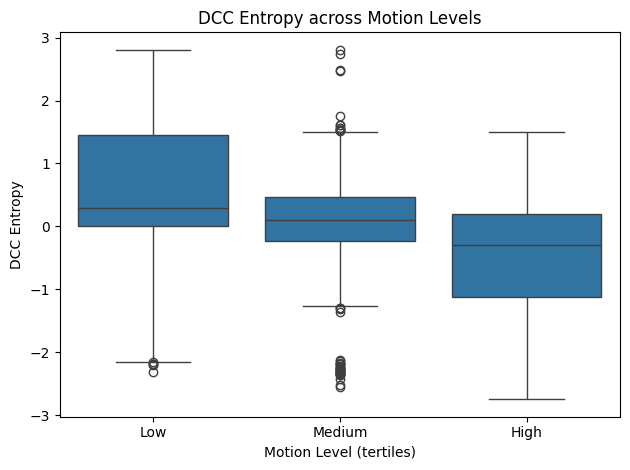

In [35]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import pingouin as pg

def dcc_motion_stratified_analysis(df):
    # Create motion bins (tertiles based on proportion_ts_fd)
    df['motion_level'] = pd.qcut(df['proportion_ts_fd'], q=3, labels=['Low', 'Medium', 'High'])

    # Initialize list to store results
    results = []

    # Analyze each bin
    for level in ['Low', 'Medium', 'High']:
        subset = df[df['motion_level'] == level]
        corr_res = pg.corr(subset['FD_mean'], subset['dcc_entropy_entire_brain'], method='spearman')


        
        results.append({
            'Motion Level': level,
            'N': len(subset),
            'Mean proportion_ts_fd': subset['proportion_ts_fd'].mean(),
            'Mean FD_mean': subset['FD_mean'].mean(),
            'Mean DCC entropy': subset['dcc_entropy_entire_brain'].mean(),
            'Spearman r': corr_res['r'].values[0],
            'p-value': corr_res['p-val'].values[0]
        })

    # Convert to dataframe
    results_df = pd.DataFrame(results)
    print("DCC Entropy – Motion Stratified Analysis:")
    print(results_df)

    # Optional: boxplot of DCC across motion bins
    sns.boxplot(data=df, x='motion_level', y='dcc_entropy_entire_brain')
    plt.title("DCC Entropy across Motion Levels")
    plt.xlabel("Motion Level (tertiles)")
    plt.ylabel("DCC Entropy")
    plt.tight_layout()
    plt.show()

    return results_df

results_motion_dcc_diff_levels = dcc_motion_stratified_analysis(df_winsorized_scaled)